# 导入需要的所有库

In [1]:
import torch as th
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from collections import namedtuple
import random
from copy import deepcopy
from torch.optim import Adam
import numpy as np
import gym
from gym.spaces import Discrete, Box
# from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt

# 定义环境

In [2]:
num_packets = 100000 # 一共生成多少个包 
num_load_balancers = 4 #均衡器的数量
num_servers = 8 #服务器的数量

In [3]:
# 代表包本身
class Packet:
    def __init__(self, ip, time_received, processing_time):
        self.ip = ip
        self.time_received = time_received # 每个包只保留被服务器接收的时间
        self.processing_time = processing_time # 每个包的处理时间
    
    def __repr__(self):
        return " @time: " + str(round(self.time_received,3))

# 代表均衡器
class LoadBalancer:
    def __init__(self, ip):
        self.ip = ip
    
    def distribute(self, server, packet):
        server.add_packet(packet)
    
    def __repr__(self):
        return "Load Balancer: " + str(self.ip)

# 代表服务器，假设服务器用的是FCFS，并且是non-preemptive
class Server:
    def __init__(self, ip, capacity):
        self.ip = ip
        self.capacity = capacity # 服务器队列的最大限制，最大吞入量
        self.queue = [] # 服务器的请求队列
        self.time_pointer = 0 # 记录相当于服务器而言的时间刻度，服务器只能处理这个时刻之后的包
        self.processed_number = 0 # 记录当前服务器已经处理的包的数量
        self.waiting=0
    
    def reset(self):
        self.queue.clear() #清空请求队列
        self.time_pointer = 0
        self.processed_number = 0
        self.waiting = 0
        
    def add_packet(self, packet):
        if len(self.queue) < self.capacity: # 如果没有超过最大吞入量，则可以继续加
            self.queue.append(packet)
            self.queue.sort(key=lambda x: x.time_received, reverse=False)
            return True
        return False
    # 还得改
    def process(self, current_time): # 处理当前时刻之前的所有包
        if current_time < self.time_pointer or len(self.queue) == 0:
            pass
        
        while(len(self.queue) > 0 and self.queue[0].time_received + self.queue[0].processing_time <= current_time ):
            self.processed_number += 1
            # if self.queue[0].time_received > self.time_pointer:
            #     self.time_pointer = self.queue[0].time_received + self.queue[0].processing_time
            # else:

            #     self.time_pointer += self.queue[0].processing_time
            
            # if self.queue[0].time_received + self.queue[0].processing_time
            self.waiting += current_time-self.queue[0].time_received
            self.queue.pop(0)
            
    def get_processed_number(self):
        return self.processed_number
    
    def __repr__(self):
        return str(self.queue)

In [15]:
class NetworkEnv(gym.Env):
    def __init__(self, num_packets = 0, num_servers=0, num_balancers=0, collaborative=True, server_capacity=None):
        assert num_servers == len(server_capacity)
        
        self.packets = [Packet(ip=i, time_received=random.randrange(0,1), processing_time=random.gauss(0.004,0.002)) for i in range(num_packets)]
        self.packets.sort(key=lambda x: x.time_received, reverse=False)
        
        self.server_capacity = server_capacity # 记录所有server的最大的吞入量

        self.n = num_balancers # agents的数量，也就是均衡器的数量
        self.shared_reward = collaborative #是否是合作模式
        self.time = 0 # 当前的时刻
        self.agents = [LoadBalancer(i) for i in range(num_balancers)]
        self.servers = [Server(i, self.server_capacity[i]) for i in range(num_servers)]
        self.waiting_packets = []
        self.index = 0
        
    def step(self, action_n):
        info = {}
        
        # self.time += 0.004
        # 这一段时间内所有的packet都拿出来然后按照给对应的balancer
        packet=[]+self.waiting_packets
        self.waiting_packets=[]
        mini = 10
        for p in self.packets[self.index:]:
            if p.time_received < self.time:
                packet.append(p)
                self.index += 1
                mini = min(p.processing_time, mini)
            else:
                break

        self.time += min(mini,0.004) #环境时间每次加处理最短的时间
        packet.sort(key=lambda x: x.time_received, reverse=False)        
        # 把包按照他们的ip平均分配给均衡器，再由均衡器按照他们的action跟配给对应的server
        for p in packet:
            lb_id = p.ip % self.n
            bol = self.agents[lb_id].distribute(self.servers[action_n[lb_id]], p)
            if bol == False:
                self.waiting_packets.append(p) #没有分配成功的包进入等待 （还有个想法：给每个包一个bol，分配成功TRUE，分配失败FALSE，之后只计算等待的包的时间，现在是计算所有包的等待时间）
                
            
        # 让每个server进行process
        for s in self.servers:
            s.process(self.time)
            
        done = (self.time >= self.packets[-1].time_received)
        
        temp = []
        for s in self.servers:
            temp.append(len(s.queue))
            # temp.append(s.time_pointer)
            # temp.append(s.get_processed_number())
        obs = [temp] * self.n
        
        reward = []
        if done:
            reward = [-sum([s.waiting  for s in self.servers])/len(self.servers)] * self.n
            # reward = [len(self.waiting_packets)]* self.n
        else:
            reward = [0] * self.n
        
        
        return obs, reward, done, info
    
    def reset(self):
        self.packets = [Packet(ip=i, time_received=random.randrange(0,10), processing_time=random.gauss(0.004,0.002)) for i in range(num_packets)]
        self.packets.sort(key=lambda x: x.time_received, reverse=False)
        self.time = 0 # 当前的时刻
        self.index = 0
        # self.agents = [LoadBalancer(i) for i in range(self.n)]
        # self.servers = [s.reset() for s in self.servers]
        temp = []
        for s in self.servers:
            s.reset()
            temp.append(len(s.queue))
            # temp.append(s.waiting)
            # temp.append(s.get_processed_number())
        obs = [temp] * self.n
        return obs

In [16]:
env = NetworkEnv(num_packets=num_packets, num_servers=num_servers, num_balancers=num_load_balancers, collaborative=True, server_capacity=[50,50,50,50,50,50,50,50])

In [17]:
episodes = 10
for e in range(1, episodes + 1):
    state = env.reset()
    done = False
    score = 0 # this is the return
    
    while not done:
        action_n = [random.randint(0, num_servers - 1) for i in range(env.n)]
        obs, reward, done, info = env.step(action_n)
        score += reward[0]
    print('Episode: {} Score: {}'.format(e, score))

Episode: 1 Score: -1.940897021794354
Episode: 2 Score: -1.7108173971185154
Episode: 3 Score: -1.8804829848805478
Episode: 4 Score: -1.4553360569727662
Episode: 5 Score: -1.9777227305274683
Episode: 6 Score: -1.8554971727903016
Episode: 7 Score: -1.689514111438246
Episode: 8 Score: -1.6665925933265364
Episode: 9 Score: -1.7472384159520395
Episode: 10 Score: -1.9419365122642447


# 将MADDPG加入到当前环境中

In [18]:
Experience = namedtuple('Experience', ('states', 'actions', 'next_states', 'rewards'))
scale_reward = 0.01

In [19]:
class ReplayMemory:
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = []
        self.position = 0

    def push(self, *args):
        if len(self.memory) < self.capacity:
            self.memory.append(None)
        self.memory[self.position] = Experience(*args)
        self.position = (self.position + 1) % self.capacity

    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)

    def __len__(self):
        return len(self.memory)

In [20]:
class Critic(nn.Module):
    def __init__(self, n_agent, dim_observation, dim_action):
        super(Critic, self).__init__()
        self.n_agent = n_agent
        self.dim_observation = dim_observation
        self.dim_action = dim_action
        obs_dim = self.dim_observation * n_agent
        act_dim = self.dim_action * n_agent

        self.FC1 = nn.Linear(obs_dim, 64)
        self.FC2 = nn.Linear(64+act_dim, 64)
        self.FC3 = nn.Linear(64, 64)
        self.FC4 = nn.Linear(64, 1)

    # obs: batch_size * obs_dim
    def forward(self, obs, acts):
        result = F.relu(self.FC1(obs))
        combined = th.cat([result, acts], 1)
        result = F.relu(self.FC2(combined))
        return self.FC4(F.relu(self.FC3(result)))


class Actor(nn.Module):
    def __init__(self, dim_observation, dim_action):
        super(Actor, self).__init__()
        self.FC1 = nn.Linear(dim_observation, 64)
        self.FC2 = nn.Linear(64, 64)
        self.FC3 = nn.Linear(64, dim_action)

    # action output between -2 and 2
    def forward(self, obs):
        result = F.relu(self.FC1(obs))
        result = F.relu(self.FC2(result))
        result = self.FC3(result) # 为什么不用relu呢
        return result

In [21]:
def sample_gumbel(shape, eps=1e-20):
    U = th.rand(shape)
    '''
    if th.cuda:
         U = U.cuda ()
    '''
    return -th.log(-th.log(U + eps) + eps)


def gumbel_softmax_sample(logits, temperature):
    y = logits + sample_gumbel(logits.size())
    return F.softmax(y / temperature, dim=-1)


def gumbel_softmax(logits, temperature=1.5):
   
    y = gumbel_softmax_sample(logits, temperature)

    return y

In [22]:
def soft_update(target, source, t):
    for target_param, source_param in zip(target.parameters(), source.parameters()):
        target_param.data.copy_((1 - t) * target_param.data + t * source_param.data)
    
def hard_update(target, source):
    for target_param, source_param in zip(target.parameters(), source.parameters()):
        target_param.data.copy_(source_param.data)

class MADDPG:
    def __init__(self, n_agents, dim_obs, dim_act, batch_size, capacity, episodes_before_train):
        self.actors = [Actor(dim_obs, dim_act) for i in range(n_agents)]
        self.critics = [Critic(n_agents, dim_obs, dim_act) for i in range(n_agents)]
        self.actors_target = deepcopy(self.actors)
        self.critics_target = deepcopy(self.critics)
        self.n_agents = n_agents
        self.n_states = dim_obs
        self.n_actions = dim_act
        self.memory = ReplayMemory(capacity)
        self.batch_size = batch_size
        self.use_cuda = th.cuda.is_available()
        self.episodes_before_train = episodes_before_train

        self.GAMMA = 0.95
        self.tau = 0.01

        self.var = [1.0 for i in range(n_agents)]
        self.critic_optimizer = [Adam(x.parameters(), lr=0.001) for x in self.critics]
        self.actor_optimizer = [Adam(x.parameters(), lr=0.0001) for x in self.actors]

        if self.use_cuda:
            for x in self.actors:
                x.cuda()
            for x in self.critics:
                x.cuda()
            for x in self.actors_target:
                x.cuda()
            for x in self.critics_target:
                x.cuda()

        self.steps_done = 0
        self.episode_done = 0

    def update_policy(self):
        # do not train until exploration is enough
        if self.episode_done <= self.episodes_before_train:
            return None, None

        ByteTensor = th.cuda.ByteTensor if self.use_cuda else th.ByteTensor
        FloatTensor = th.cuda.FloatTensor if self.use_cuda else th.FloatTensor

        c_loss = []
        a_loss = []
        for agent in range(self.n_agents):
            transitions = self.memory.sample(self.batch_size)
            batch = Experience(*zip(*transitions))
            non_final_mask = ByteTensor(list(map(lambda s: s is not None, batch.next_states)))
            # state_batch: batch_size x n_agents x dim_obs
            # state_batch = th.stack(batch.states).type(FloatTensor)
            state_batch = th.stack(batch.states)
            # action_batch = th.stack(batch.actions).type(FloatTensor)
            action_batch = th.stack(batch.actions)
            # reward_batch = th.stack(batch.rewards).type(FloatTensor)
            reward_batch = th.stack(batch.rewards)
            # : (batch_size_non_final) x n_agents x dim_obs
            non_final_next_states = th.stack([s for s in batch.next_states if s is not None]).type(FloatTensor)

            # for current agent
            whole_state = state_batch.view(self.batch_size, -1)
            whole_action = action_batch.view(self.batch_size, -1)
            self.critic_optimizer[agent].zero_grad()
            current_Q = self.critics[agent](whole_state, whole_action)

            non_final_next_actions = [self.actors_target[i](non_final_next_states[:, i,:]) for i in range(self.n_agents)]
            non_final_next_actions = th.stack(non_final_next_actions)
            non_final_next_actions = (non_final_next_actions.transpose(0, 1).contiguous())

            target_Q = th.zeros(self.batch_size).type(FloatTensor)

            target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states), 
                                                                  non_final_next_actions.view(-1, self.n_agents * self.n_actions)).squeeze()
            # scale_reward: to scale reward in Q functions

            target_Q = (target_Q.unsqueeze(1) * self.GAMMA) + (reward_batch[:, agent].unsqueeze(1) * scale_reward)

            loss_Q = nn.MSELoss()(current_Q, target_Q.detach())
            loss_Q.backward() #retain_graph=True
            self.critic_optimizer[agent].step()

            self.actor_optimizer[agent].zero_grad()
            state_i = state_batch[:, agent, :]
            action_i = self.actors[agent](state_i)
            action_i = gumbel_softmax(action_i)
            ac = action_batch.clone()
            ac[:, agent, :] = action_i
            whole_action = ac.view(self.batch_size, -1)
            actor_loss = -self.critics[agent](whole_state, whole_action)
            actor_loss = actor_loss.mean()
            actor_loss.backward()
            self.actor_optimizer[agent].step()
            c_loss.append(loss_Q)
            a_loss.append(actor_loss)

        if self.steps_done % 100 == 0 and self.steps_done > 0:
            for i in range(self.n_agents):
                soft_update(self.critics_target[i], self.critics[i], self.tau)
                soft_update(self.actors_target[i], self.actors[i], self.tau)

        return c_loss, a_loss

    def select_action(self, state_batch):
        # state_batch: n_agents x state_dim
        actions = th.zeros(self.n_agents, self.n_actions)
        FloatTensor = th.cuda.FloatTensor if self.use_cuda else th.FloatTensor
        for i in range(self.n_agents):
            sb = state_batch[i, :].detach()
            act = self.actors[i](sb.unsqueeze(0)).squeeze()
            act = gumbel_softmax(act)
            actions[i, :] = act
        self.steps_done += 1

        return actions.detach()

Episode: 0, reward = -1.792315


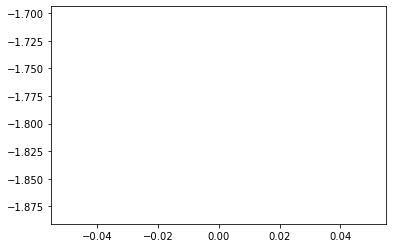

Episode: 1, reward = -1.905224


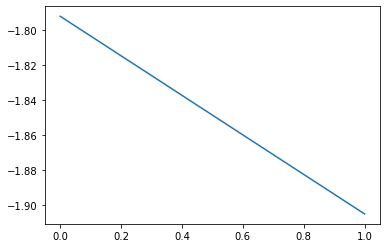

Episode: 2, reward = -1.662476


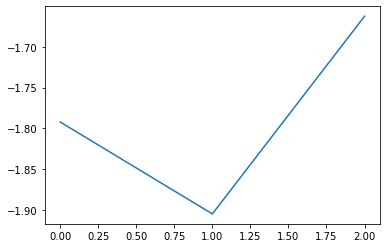

Episode: 3, reward = -1.865404


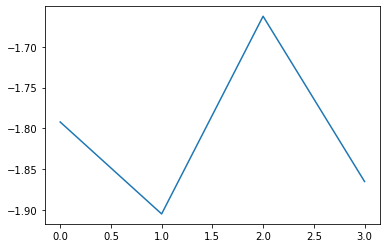

Episode: 4, reward = -1.682652


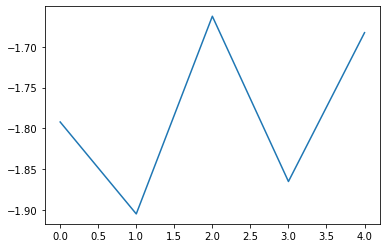

Episode: 5, reward = -1.610430


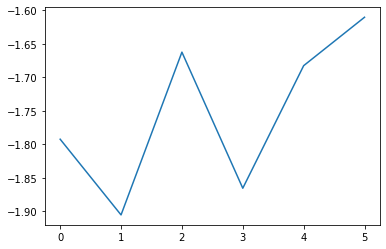

Episode: 6, reward = -1.839007


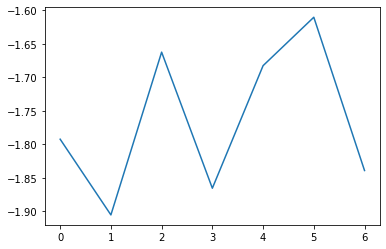

Episode: 7, reward = -1.958804


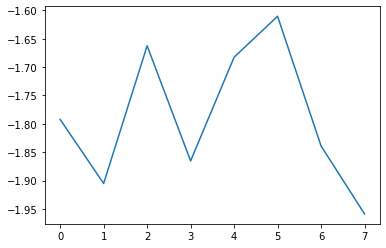

Episode: 8, reward = -1.756010


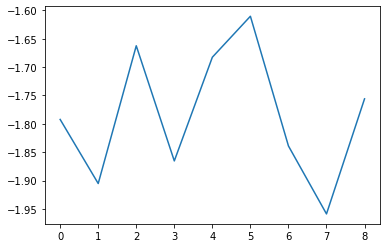

Episode: 9, reward = -1.886539


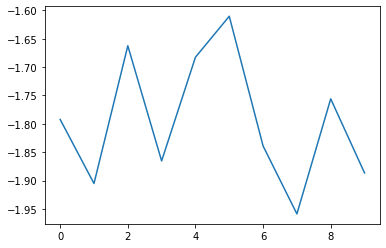

Episode: 10, reward = -1.866793


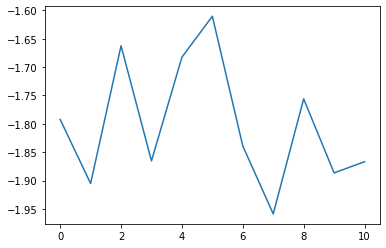

Episode: 11, reward = -1.732304


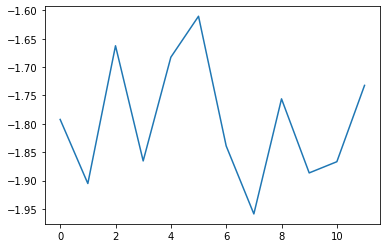

Episode: 12, reward = -1.821087


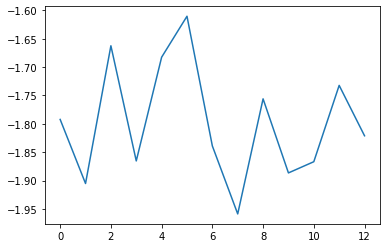

Episode: 13, reward = -1.890208


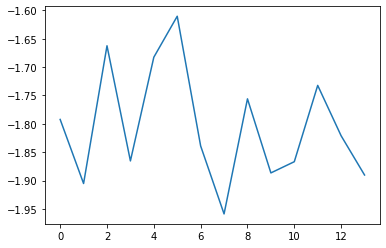

Episode: 14, reward = -1.810355


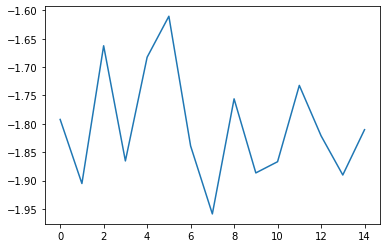

Episode: 15, reward = -1.857459


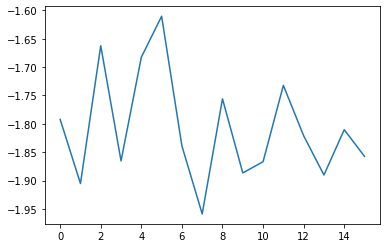

Episode: 16, reward = -1.876975


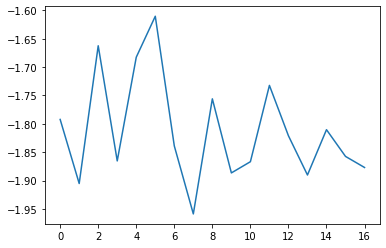

Episode: 17, reward = -1.690404


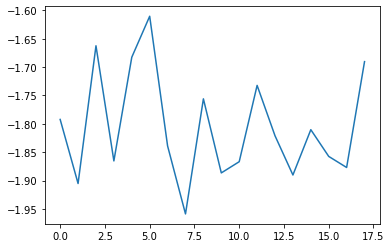

Episode: 18, reward = -1.826251


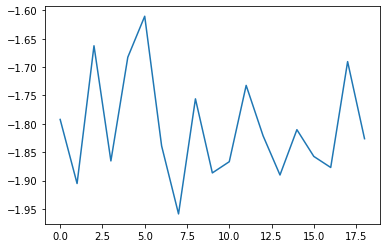

Episode: 19, reward = -1.750137


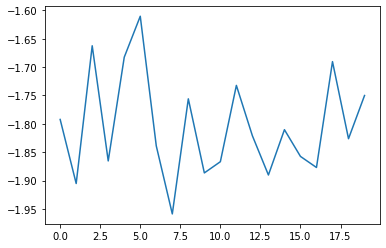

Episode: 20, reward = -1.714198


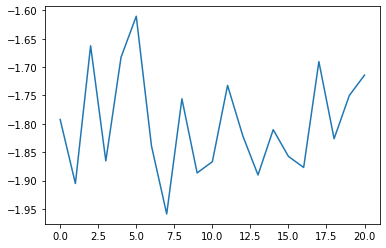

Episode: 21, reward = -1.665434


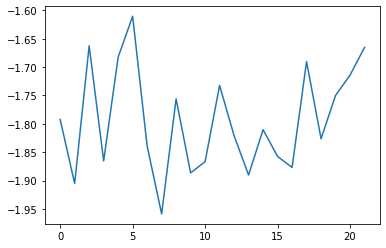

Episode: 22, reward = -1.816001


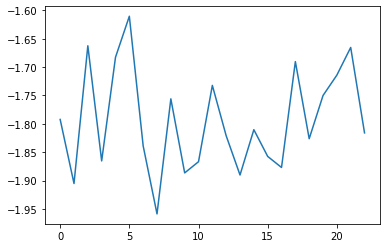

Episode: 23, reward = -1.755691


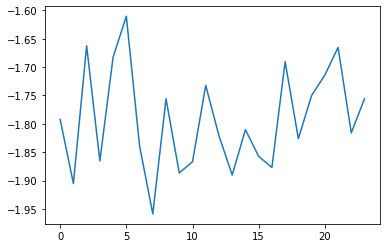

Episode: 24, reward = -1.791112


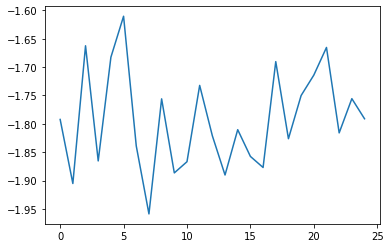

Episode: 25, reward = -1.814594


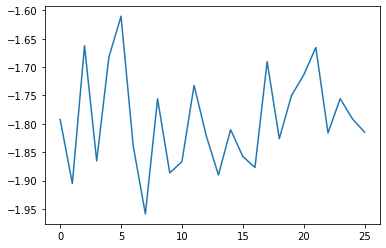

Episode: 26, reward = -1.725083


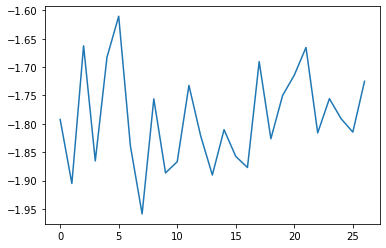

Episode: 27, reward = -1.783011


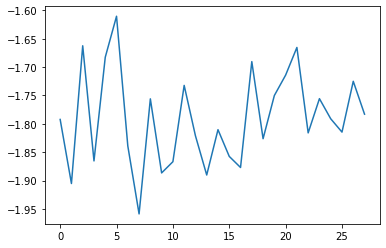

Episode: 28, reward = -1.656955


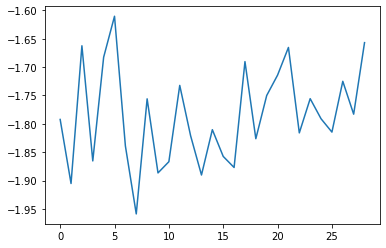

Episode: 29, reward = -1.733202


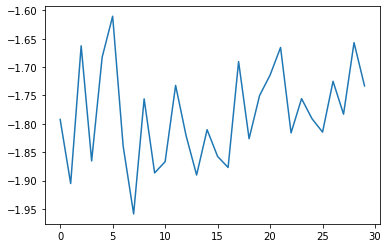

Episode: 30, reward = -2.058489


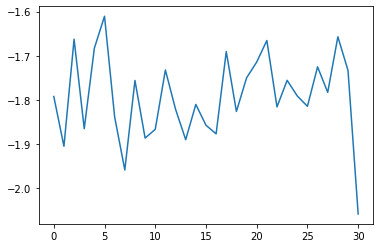

Episode: 31, reward = -1.641815


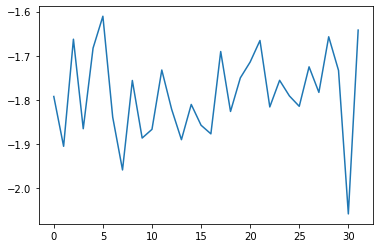

Episode: 32, reward = -1.957582


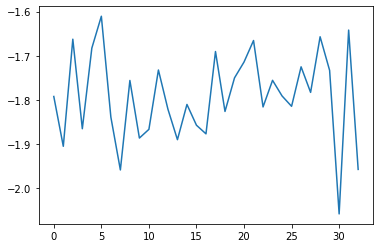

Episode: 33, reward = -1.672276


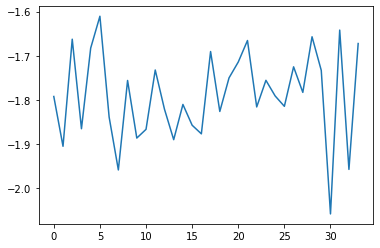

Episode: 34, reward = -1.812785


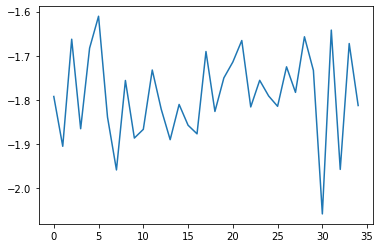

Episode: 35, reward = -1.771446


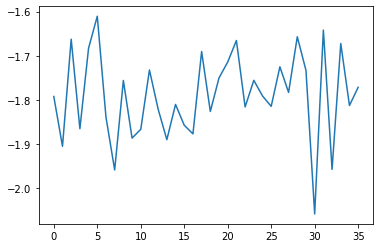

Episode: 36, reward = -1.903788


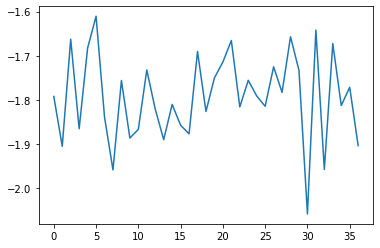

Episode: 37, reward = -1.611709


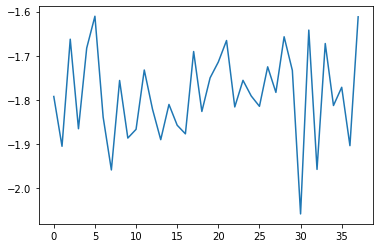

Episode: 38, reward = -1.809351


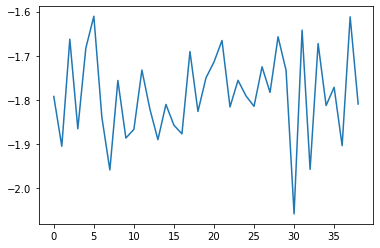

Episode: 39, reward = -1.968670


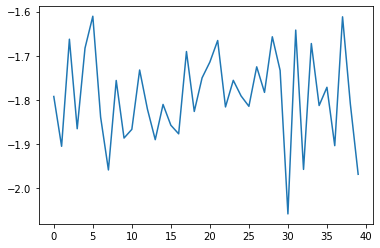

Episode: 40, reward = -1.914812


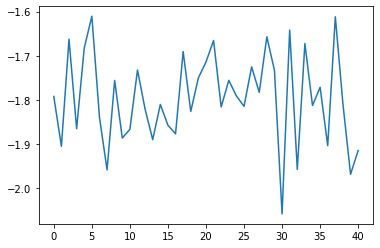

Episode: 41, reward = -1.799709


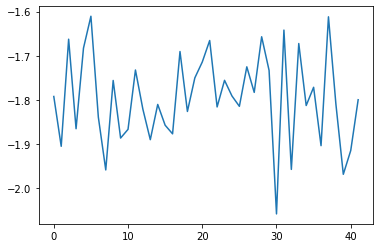

Episode: 42, reward = -2.008820


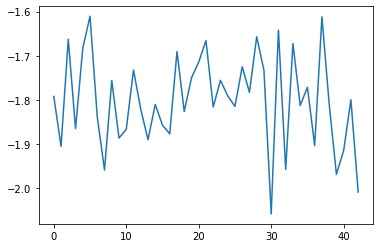

Episode: 43, reward = -1.713145


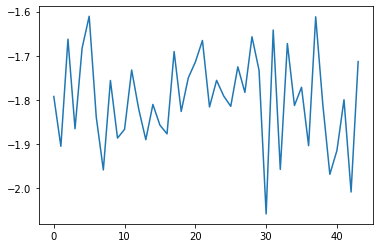

Episode: 44, reward = -1.755407


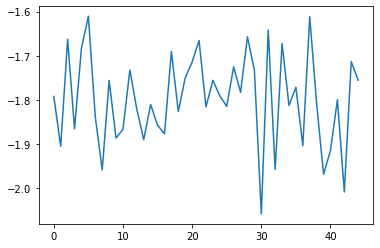

Episode: 45, reward = -1.903224


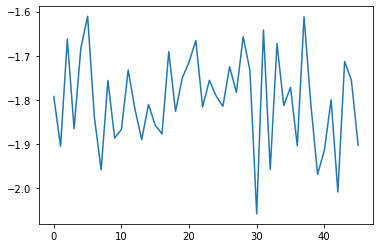

Episode: 46, reward = -1.943976


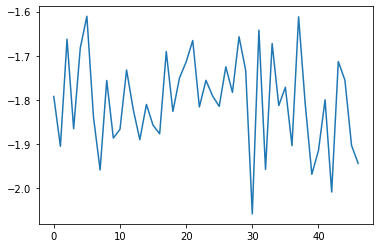

Episode: 47, reward = -1.809845


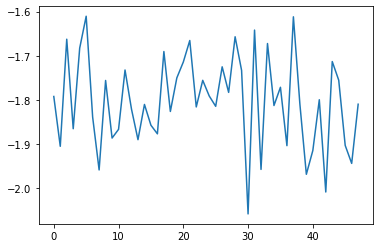

Episode: 48, reward = -2.092492


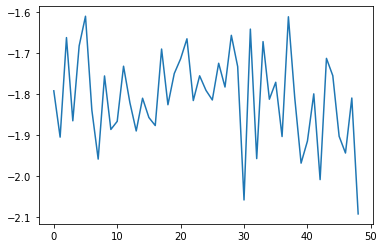

Episode: 49, reward = -1.789308


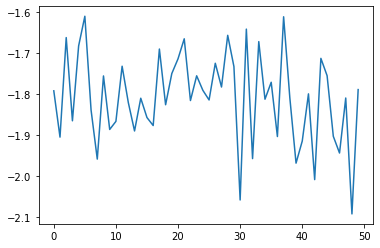

Episode: 50, reward = -1.770374


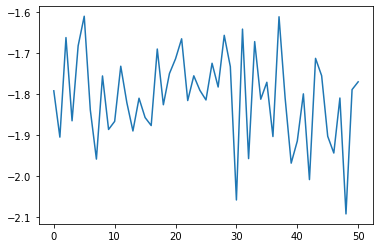

Episode: 51, reward = -1.877846


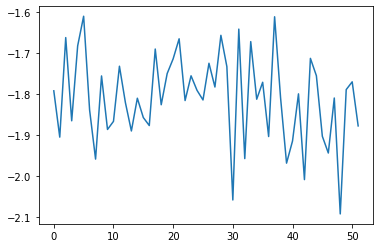

Episode: 52, reward = -1.922301


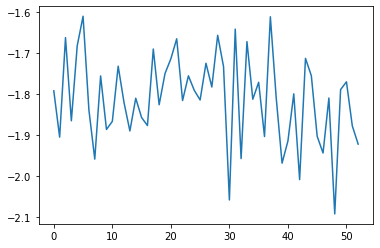

Episode: 53, reward = -1.811090


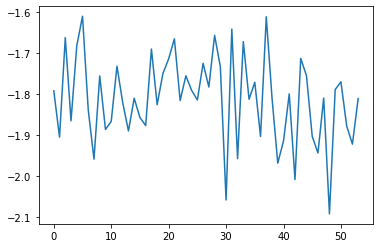

Episode: 54, reward = -1.738880


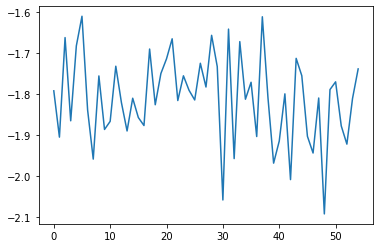

Episode: 55, reward = -1.946563


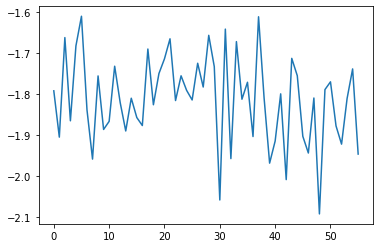

Episode: 56, reward = -1.878650


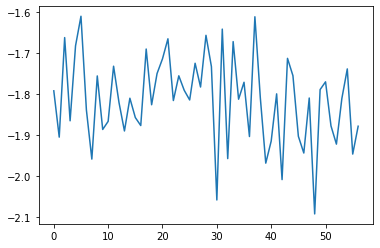

Episode: 57, reward = -2.035583


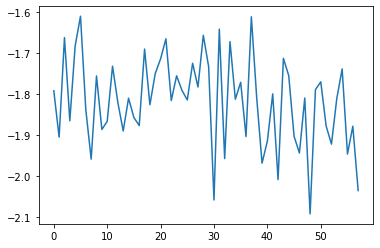

Episode: 58, reward = -1.811745


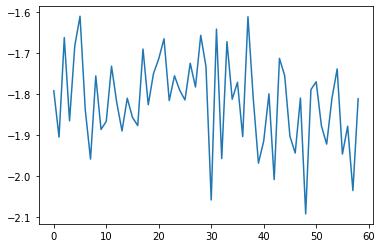

Episode: 59, reward = -1.905846


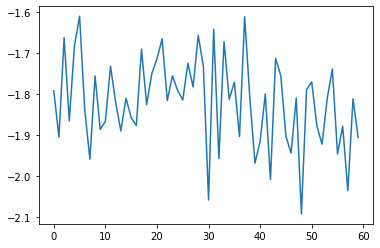

Episode: 60, reward = -1.841692


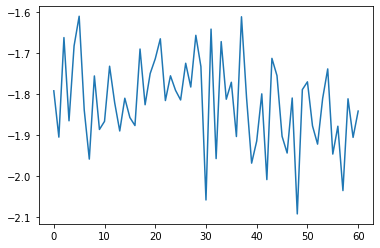

Episode: 61, reward = -1.772951


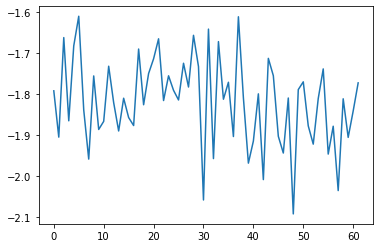

Episode: 62, reward = -1.827118


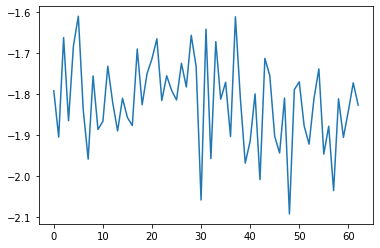

Episode: 63, reward = -1.650999


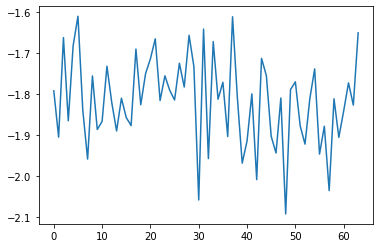

Episode: 64, reward = -1.867029


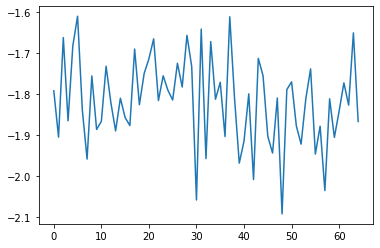

Episode: 65, reward = -1.744516


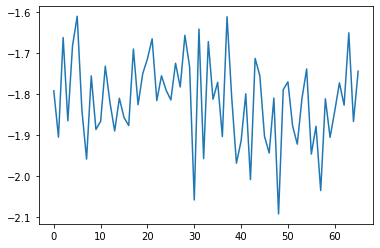

Episode: 66, reward = -1.813206


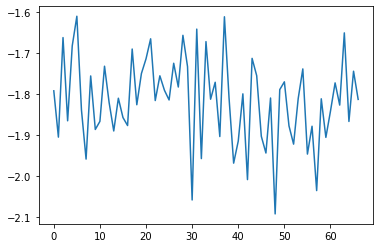

Episode: 67, reward = -1.891521


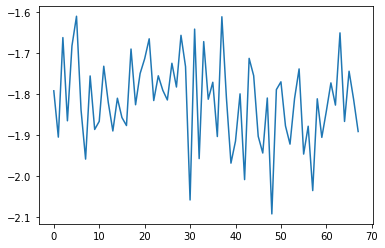

Episode: 68, reward = -1.683412


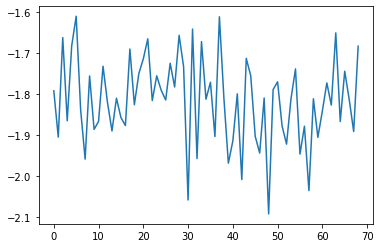

Episode: 69, reward = -1.810237


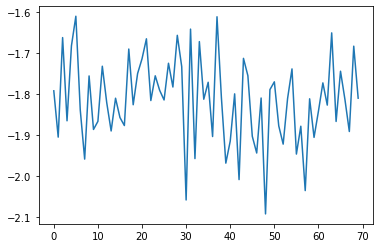

Episode: 70, reward = -1.687520


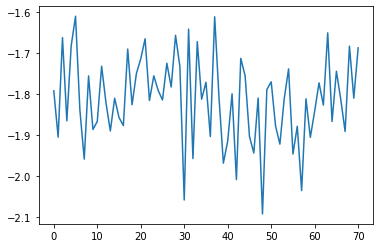

Episode: 71, reward = -1.538276


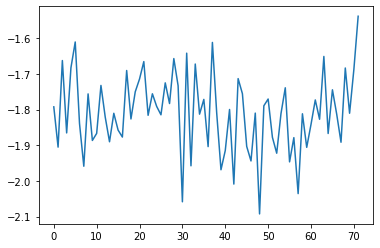

Episode: 72, reward = -1.591120


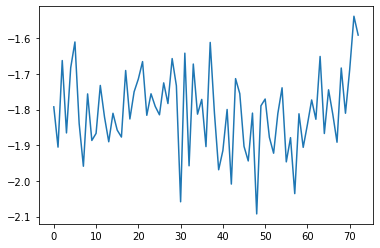

Episode: 73, reward = -2.028119


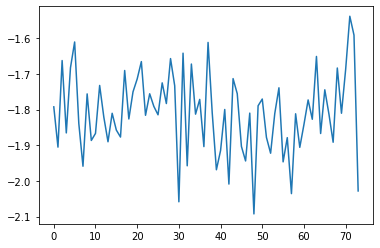

Episode: 74, reward = -1.773199


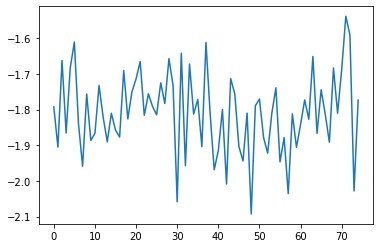

Episode: 75, reward = -1.743860


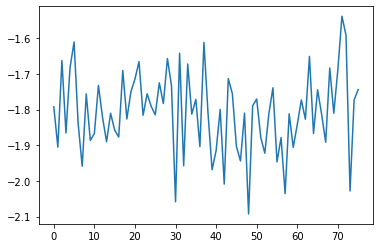

Episode: 76, reward = -1.837512


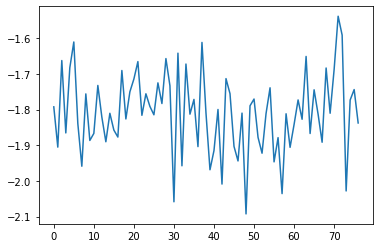

Episode: 77, reward = -1.752757


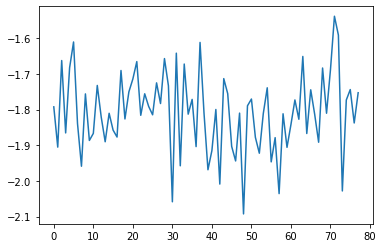

Episode: 78, reward = -1.969730


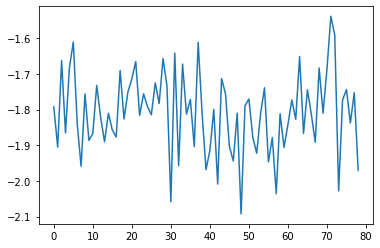

Episode: 79, reward = -1.601115


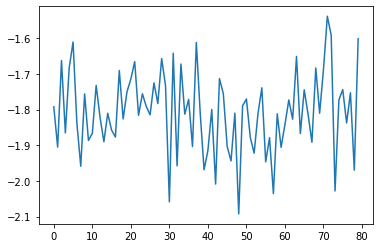

Episode: 80, reward = -1.751588


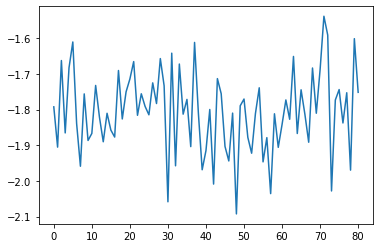

Episode: 81, reward = -1.732464


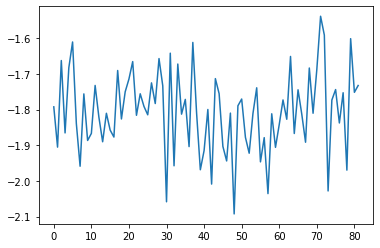

Episode: 82, reward = -1.847605


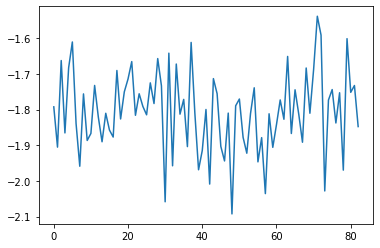

Episode: 83, reward = -1.766579


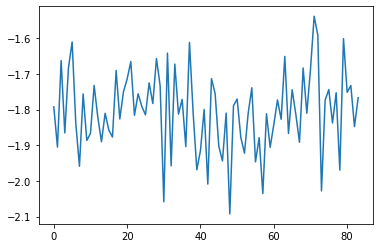

Episode: 84, reward = -1.945241


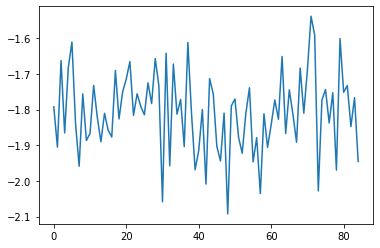

Episode: 85, reward = -1.832500


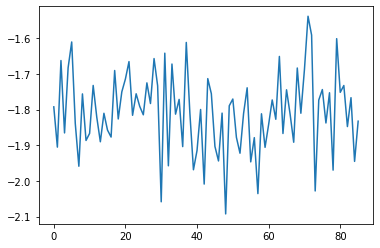

Episode: 86, reward = -1.977740


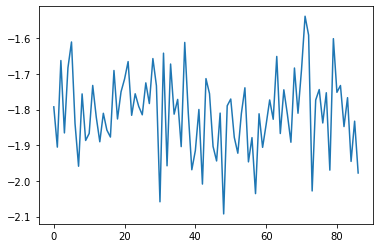

Episode: 87, reward = -1.645524


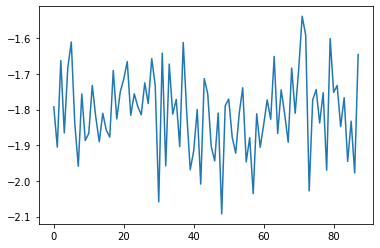

Episode: 88, reward = -1.966197


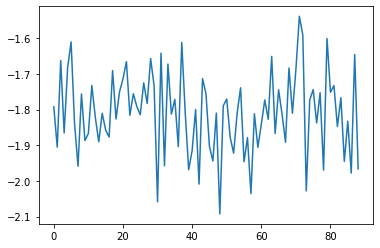

Episode: 89, reward = -1.793384


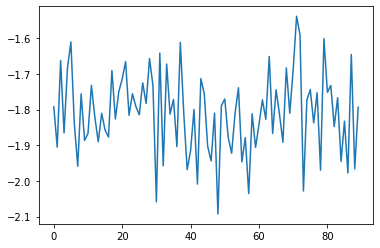

Episode: 90, reward = -1.790542


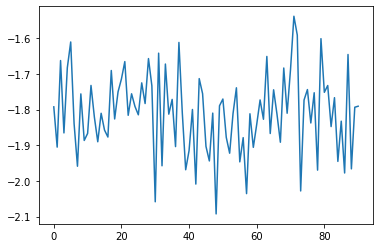

Episode: 91, reward = -1.772319


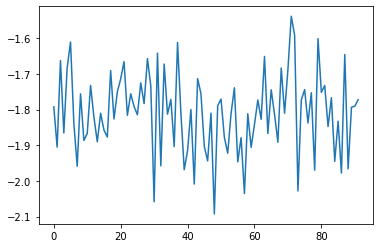

Episode: 92, reward = -1.522042


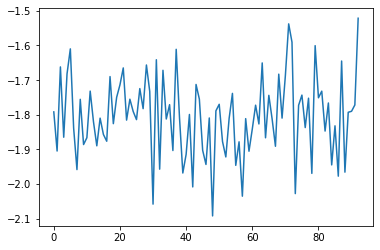

Episode: 93, reward = -1.755301


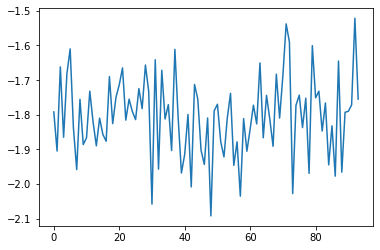

Episode: 94, reward = -1.854179


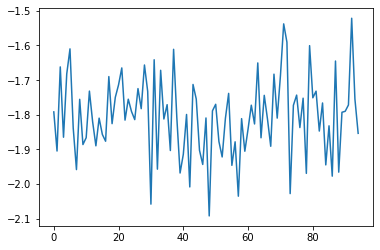

Episode: 95, reward = -1.677515


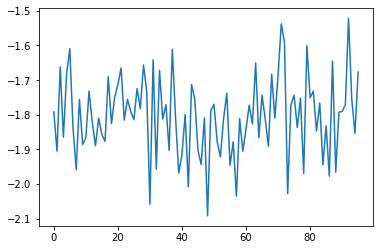

Episode: 96, reward = -1.827716


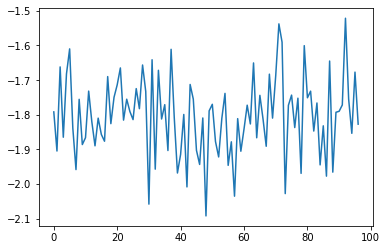

Episode: 97, reward = -1.694361


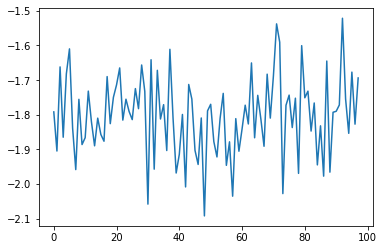

Episode: 98, reward = -1.789972


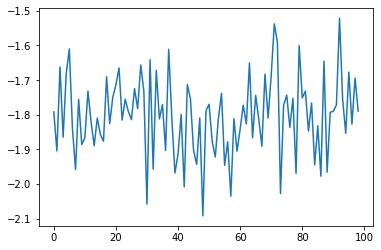

Episode: 99, reward = -1.839645


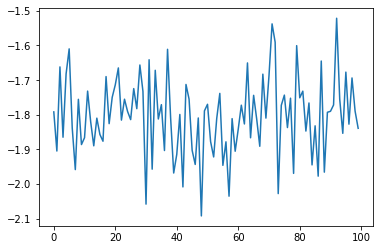

training now begins...
MADDPG on Network Balancing
scale_reward=0.010000
agent=4 
lr=0.001, 0.0001, sensor_range=0.3
servers=8
Episode: 100, reward = -1.898550


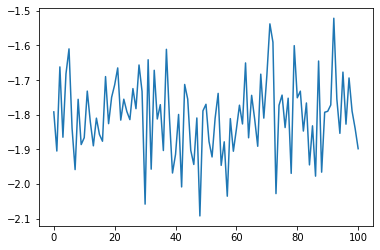

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 101, reward = -1.647783


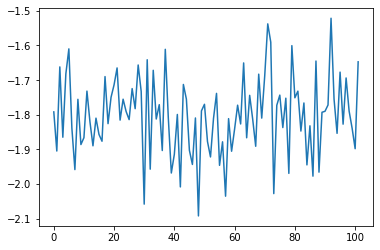

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 102, reward = -1.481737


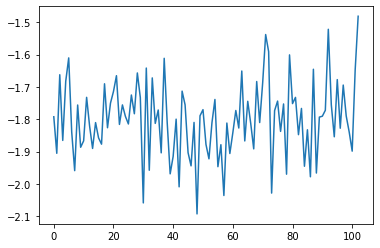

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 103, reward = -1.579457


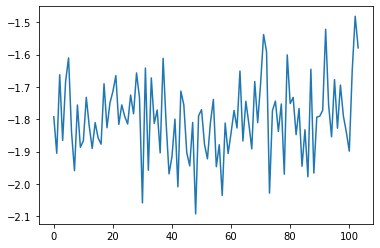

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 104, reward = -1.504538


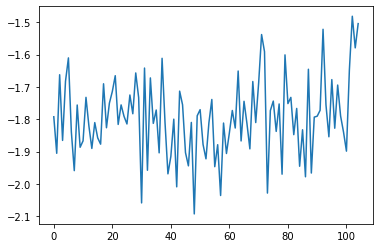

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 105, reward = -1.898826


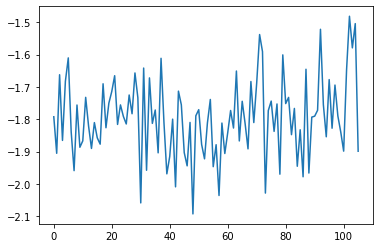

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 106, reward = -2.159888


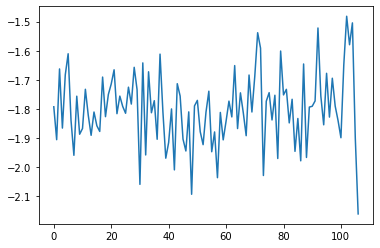

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 107, reward = -1.735488


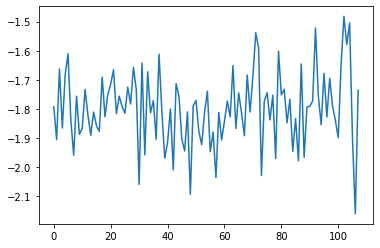

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 108, reward = -2.098530


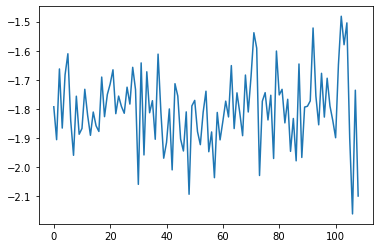

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 109, reward = -2.111390


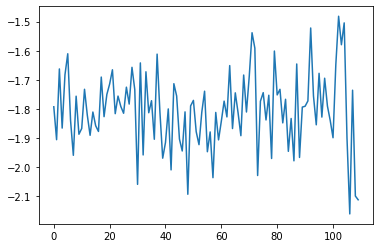

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 110, reward = -1.856919


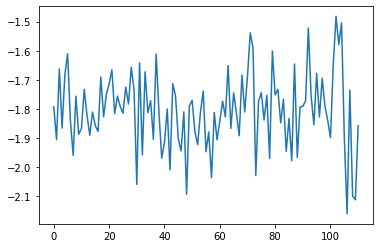

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 111, reward = -1.583187


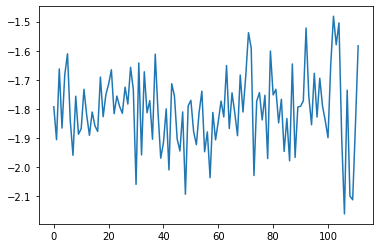

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 112, reward = -1.561318


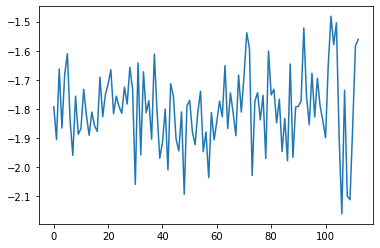

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 113, reward = -1.601886


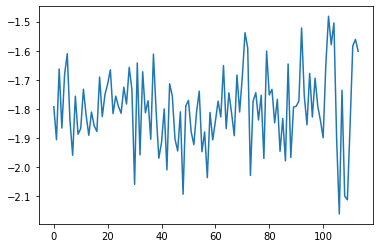

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 114, reward = -2.048784


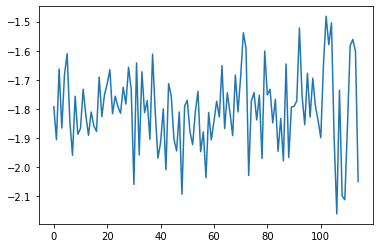

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 115, reward = -2.155394


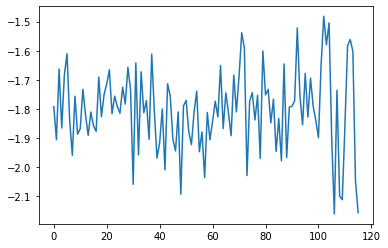

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 116, reward = -2.136945


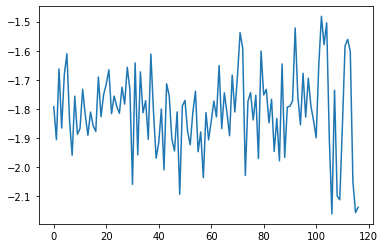

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 117, reward = -2.122374


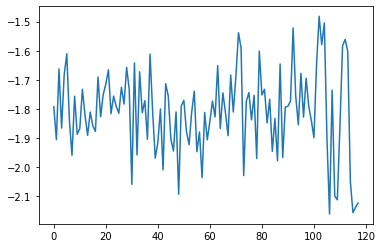

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 118, reward = -2.148301


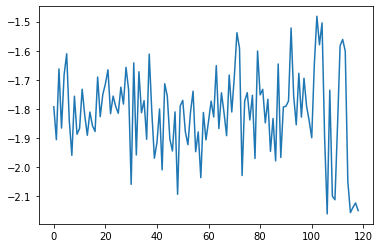

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 119, reward = -2.123075


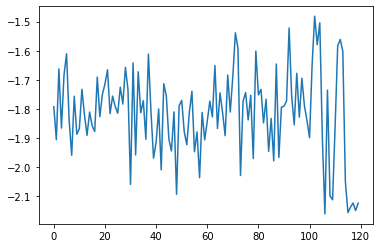

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 120, reward = -2.185353


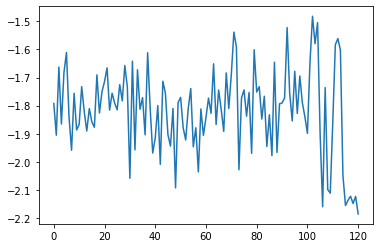

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 121, reward = -2.177755


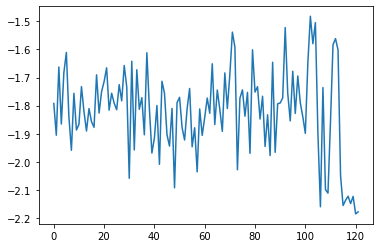

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 122, reward = -2.196757


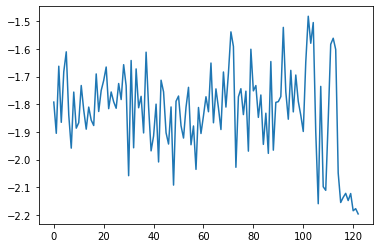

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 123, reward = -2.173088


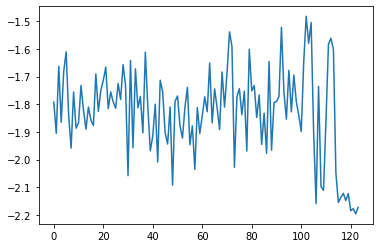

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 124, reward = -2.201169


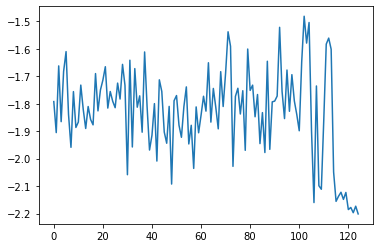

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 125, reward = -2.140017


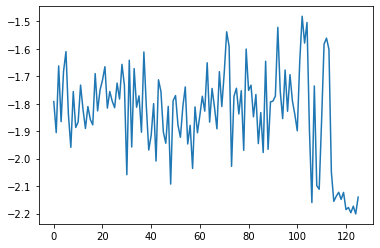

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 126, reward = -2.207255


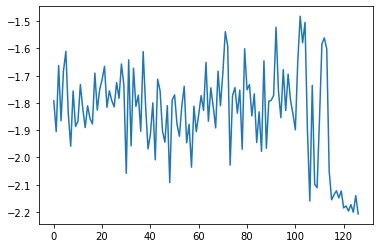

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 127, reward = -2.306616


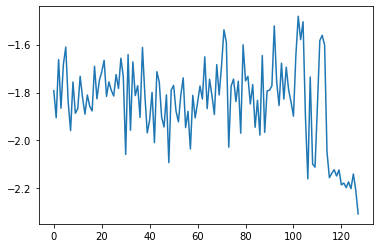

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 128, reward = -2.188840


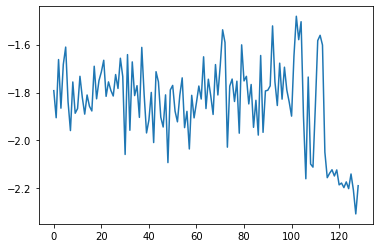

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 129, reward = -2.140339


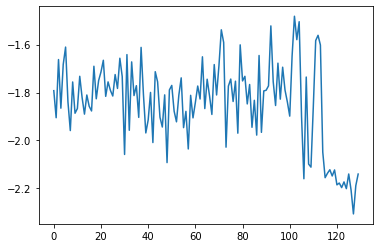

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 130, reward = -2.113724


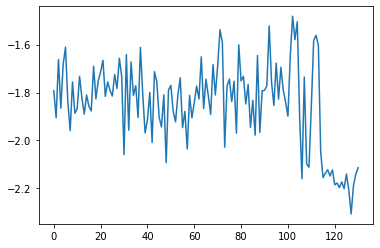

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 131, reward = -2.149506


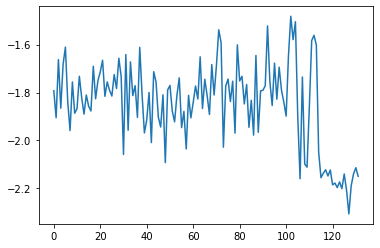

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 132, reward = -2.220004


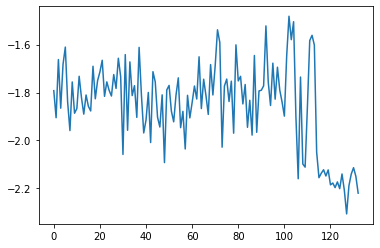

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 133, reward = -2.045467


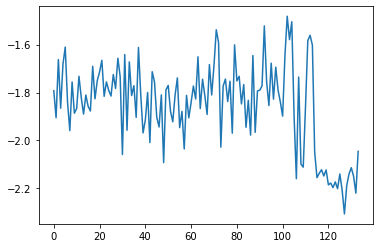

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 134, reward = -2.160999


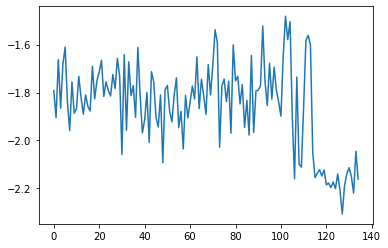

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 135, reward = -2.107398


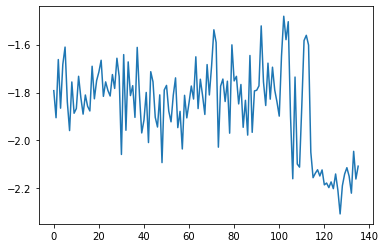

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 136, reward = -2.142697


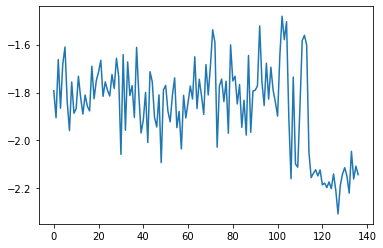

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 137, reward = -2.149655


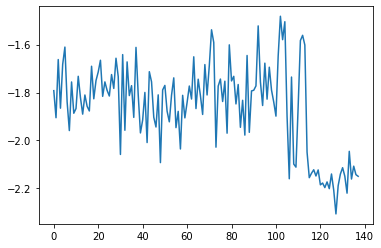

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 138, reward = -2.113040


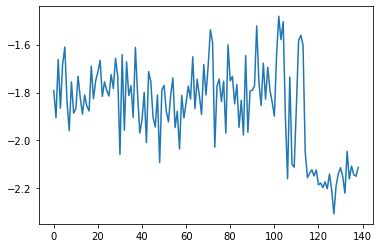

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 139, reward = -2.145797


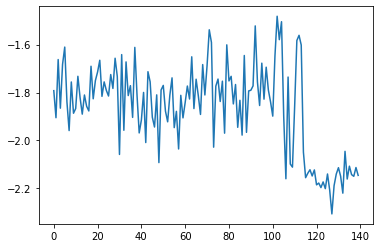

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 140, reward = -2.241058


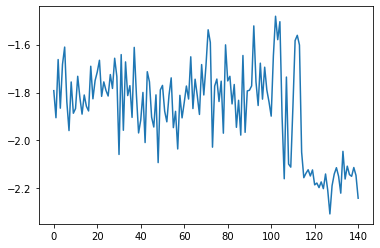

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 141, reward = -2.068089


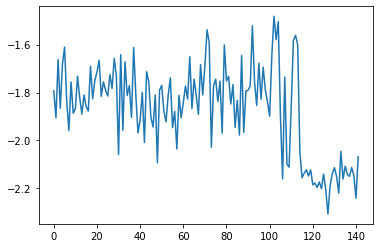

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 142, reward = -2.175790


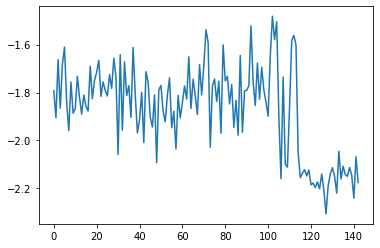

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 143, reward = -2.130412


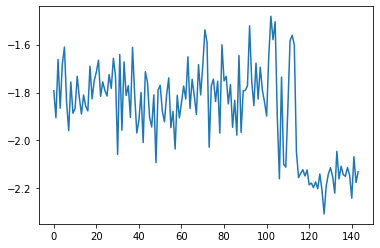

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 144, reward = -2.139250


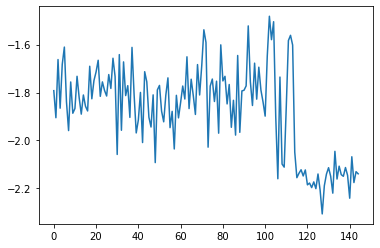

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 145, reward = -2.215985


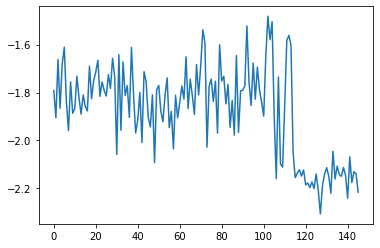

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 146, reward = -1.734346


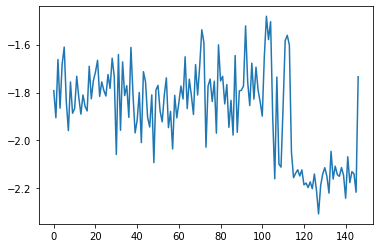

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 147, reward = -1.579984


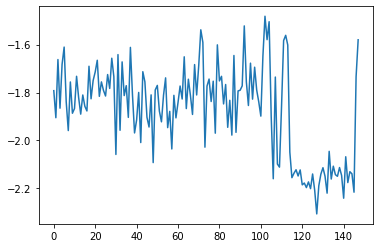

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 148, reward = -1.663281


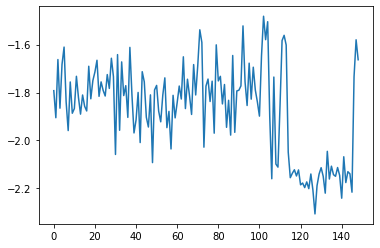

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 149, reward = -1.577969


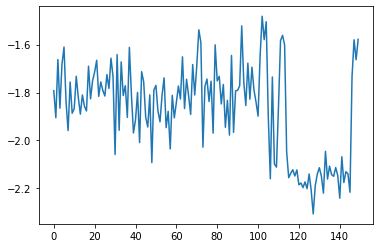

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 150, reward = -1.635418


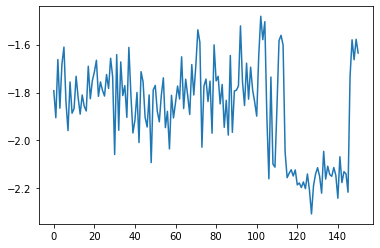

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 151, reward = -1.542003


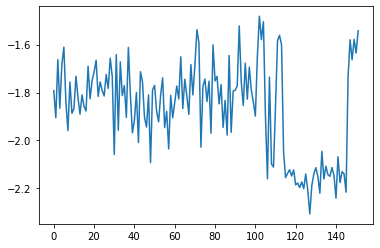

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 152, reward = -1.641945


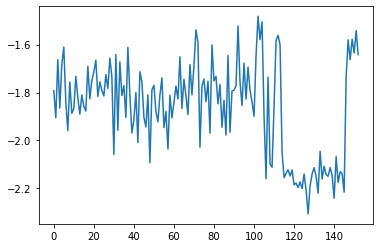

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 153, reward = -1.574197


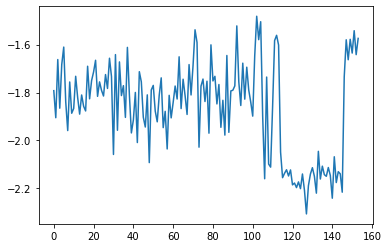

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 154, reward = -1.638277


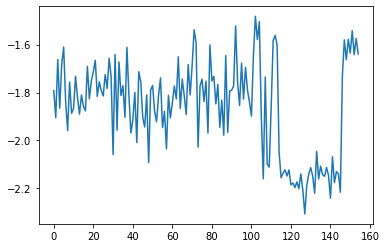

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 155, reward = -1.620373


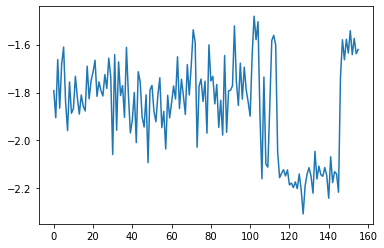

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 156, reward = -1.652298


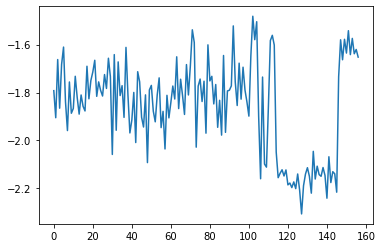

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 157, reward = -1.594740


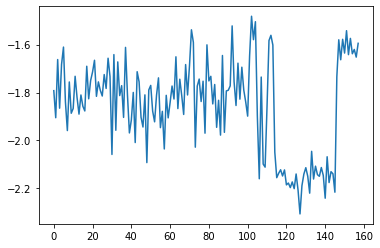

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 158, reward = -1.569878


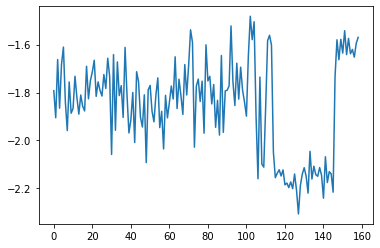

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 159, reward = -1.553452


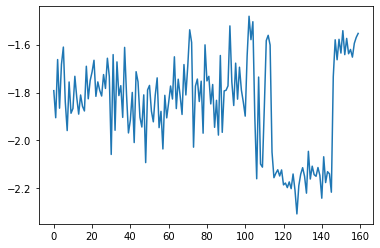

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 160, reward = -1.657376


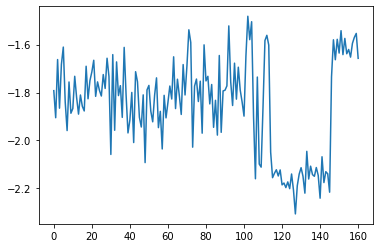

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 161, reward = -1.603718


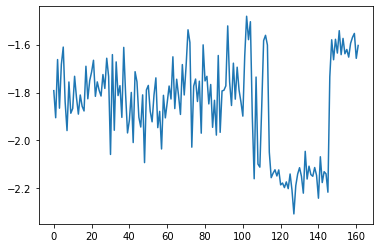

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 162, reward = -1.543993


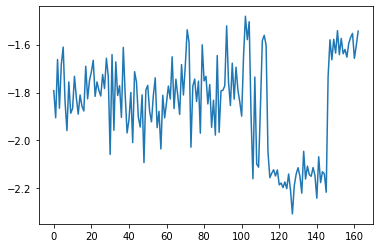

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 163, reward = -1.643039


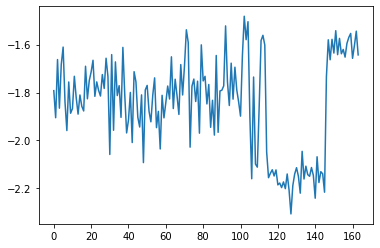

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 164, reward = -1.633060


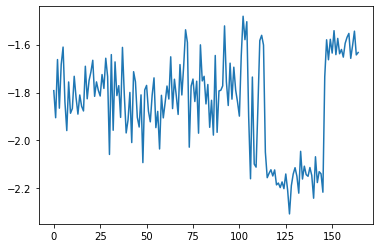

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 165, reward = -1.613796


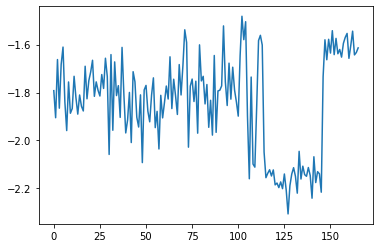

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 166, reward = -1.637224


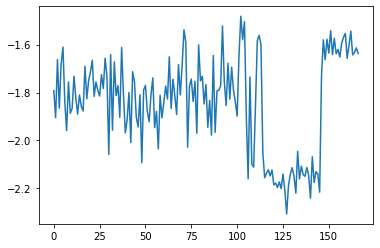

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 167, reward = -1.741918


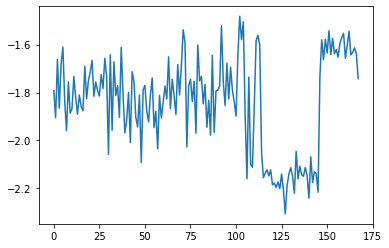

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 168, reward = -1.599044


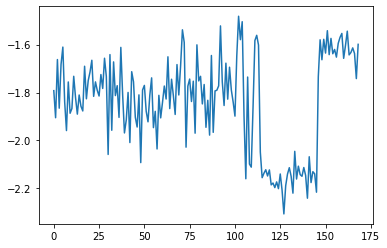

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 169, reward = -1.595094


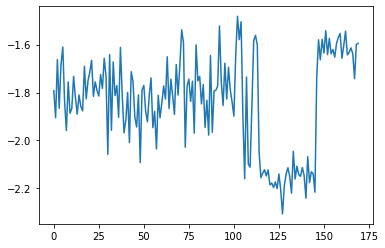

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 170, reward = -1.657847


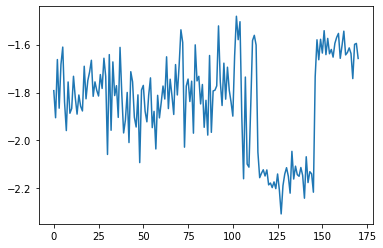

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 171, reward = -1.604656


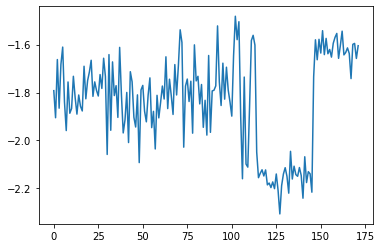

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 172, reward = -1.616099


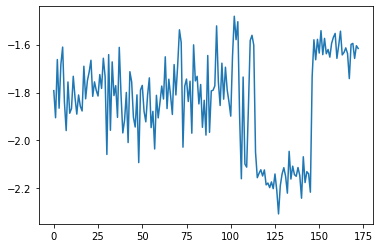

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 173, reward = -1.719968


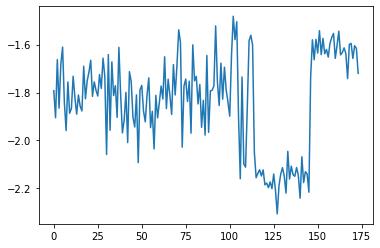

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 174, reward = -1.618766


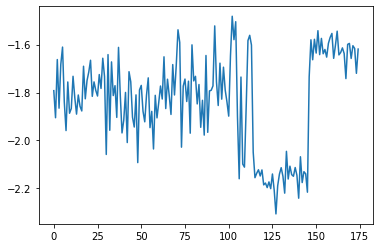

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 175, reward = -1.685184


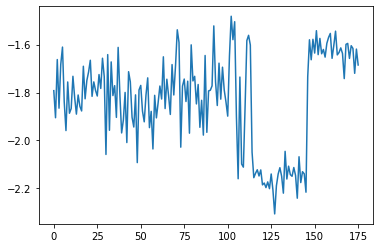

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 176, reward = -1.589399


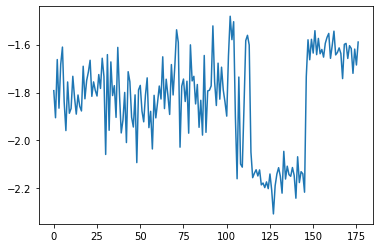

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 177, reward = -1.595145


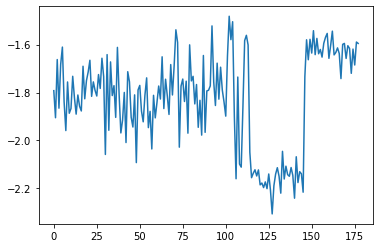

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 178, reward = -1.593736


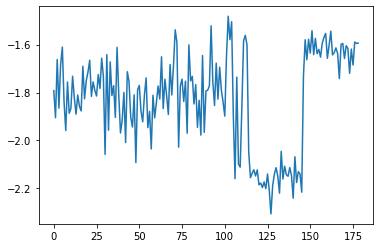

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 179, reward = -1.663981


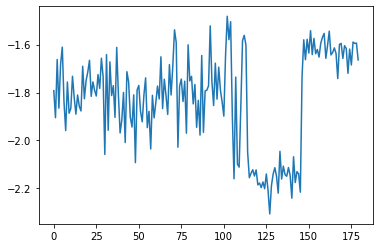

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 180, reward = -1.596762


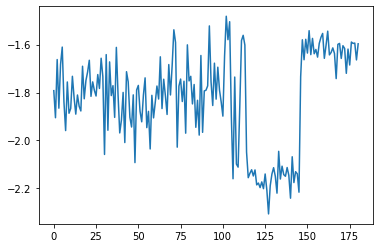

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 181, reward = -1.637251


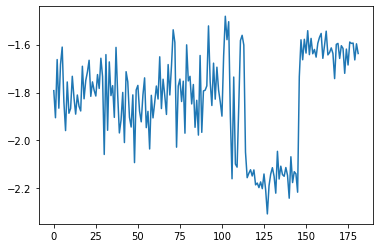

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 182, reward = -1.669469


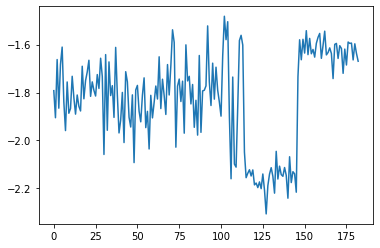

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 183, reward = -1.634253


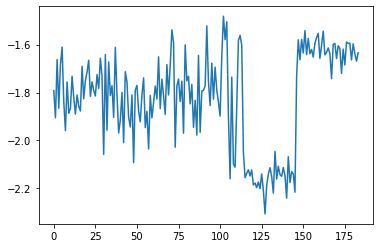

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 184, reward = -1.549332


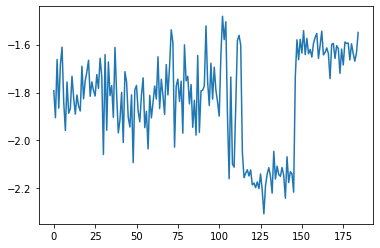

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 185, reward = -1.637215


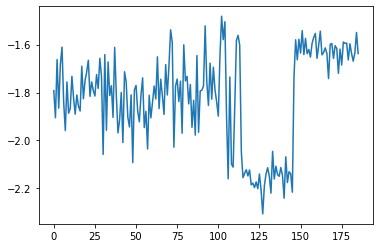

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 186, reward = -1.595976


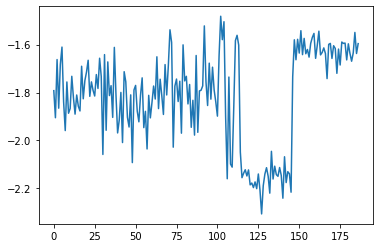

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 187, reward = -1.615916


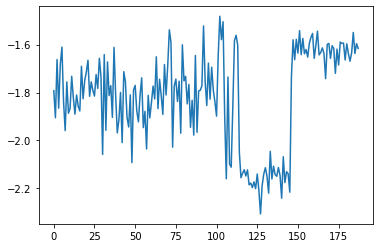

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 188, reward = -1.634864


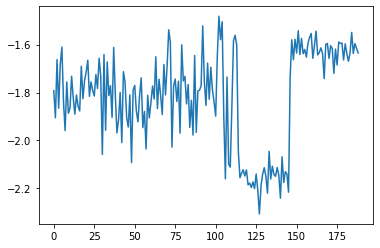

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 189, reward = -1.639308


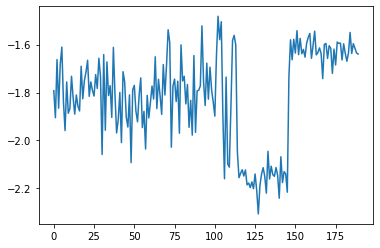

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 190, reward = -1.647431


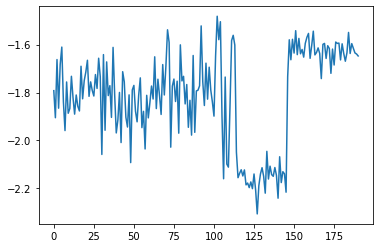

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 191, reward = -1.581267


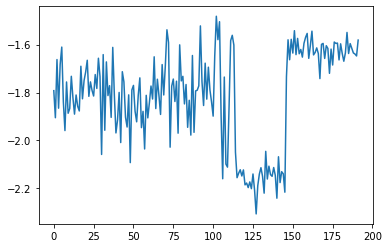

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 192, reward = -1.701000


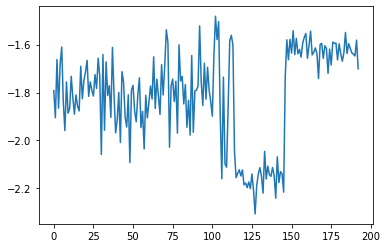

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 193, reward = -1.631850


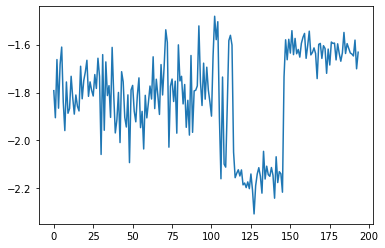

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 194, reward = -1.622502


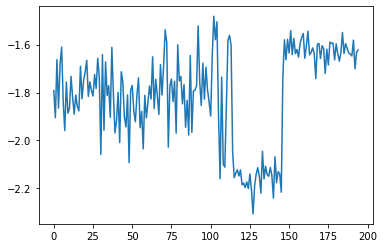

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 195, reward = -1.593667


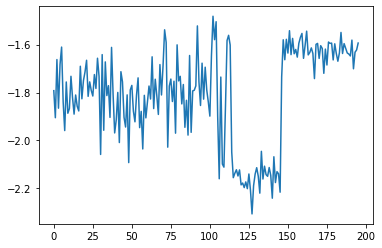

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 196, reward = -1.649400


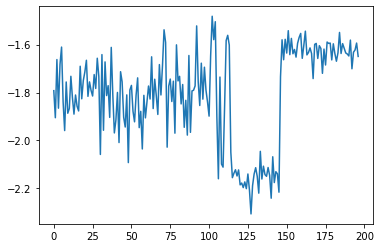

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 197, reward = -1.590432


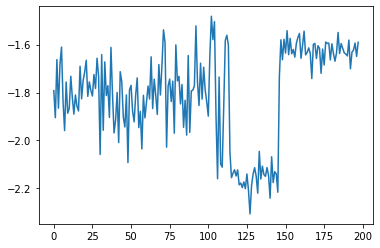

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 198, reward = -1.690425


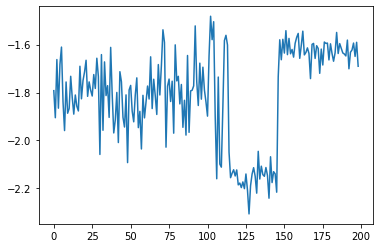

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 199, reward = -1.596689


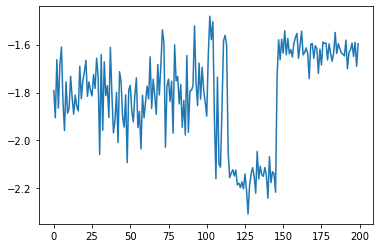

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 200, reward = -1.627478


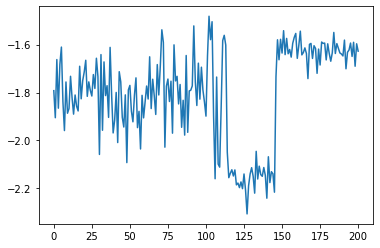

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 201, reward = -1.611539


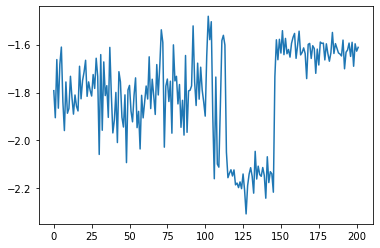

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 202, reward = -1.655690


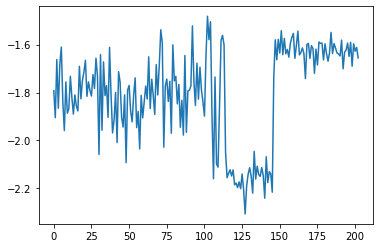

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 203, reward = -1.642086


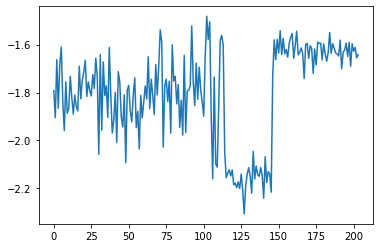

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 204, reward = -1.707304


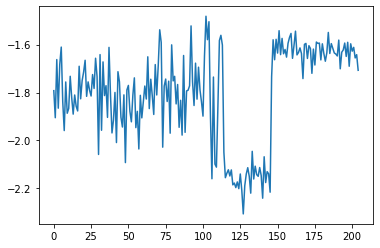

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 205, reward = -1.622133


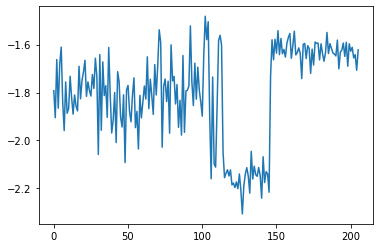

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 206, reward = -1.590871


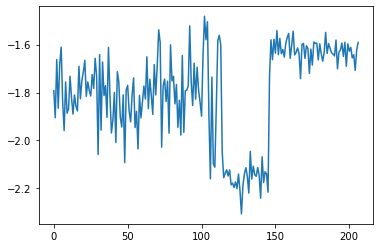

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 207, reward = -1.518340


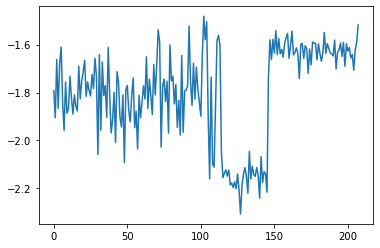

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 208, reward = -1.633270


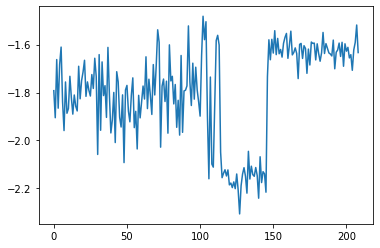

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 209, reward = -1.628427


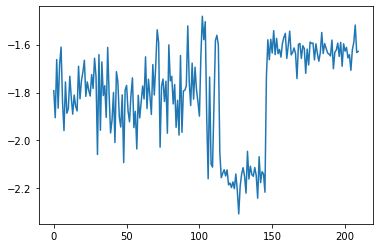

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 210, reward = -1.548515


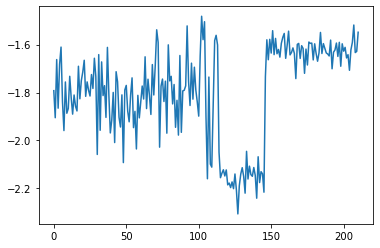

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 211, reward = -1.578790


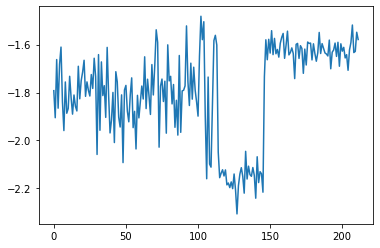

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 212, reward = -1.626118


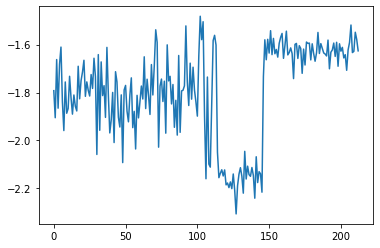

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 213, reward = -1.671397


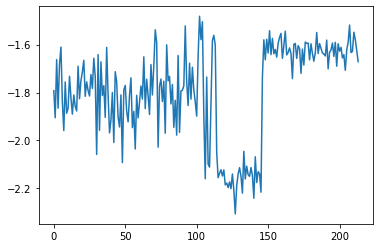

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 214, reward = -1.609779


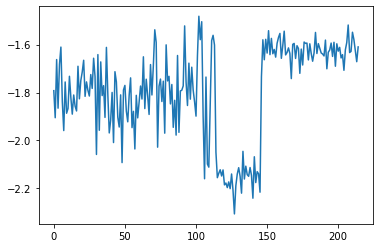

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 215, reward = -1.682168


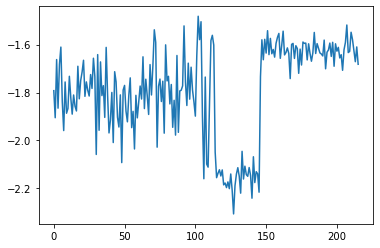

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 216, reward = -1.653643


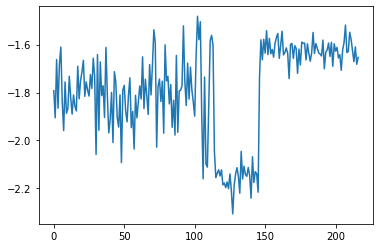

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 217, reward = -1.582165


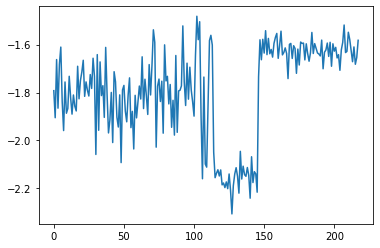

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 218, reward = -1.582650


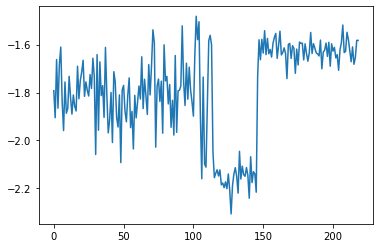

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 219, reward = -1.576749


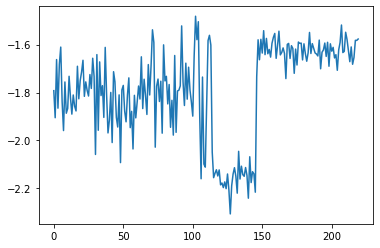

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 220, reward = -1.612659


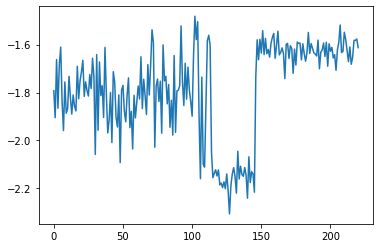

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 221, reward = -1.549709


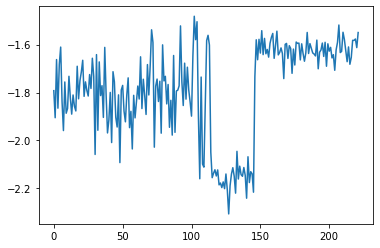

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 222, reward = -1.686669


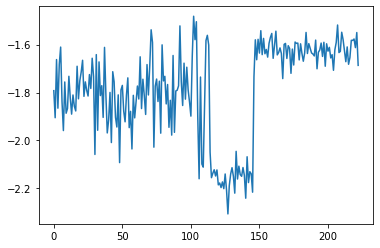

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 223, reward = -1.612408


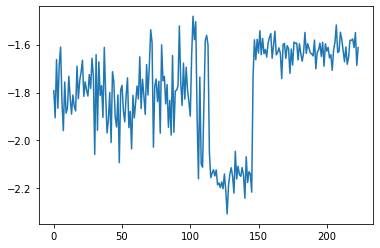

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 224, reward = -1.586464


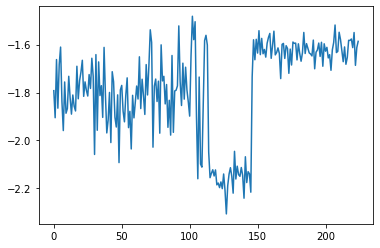

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 225, reward = -1.586365


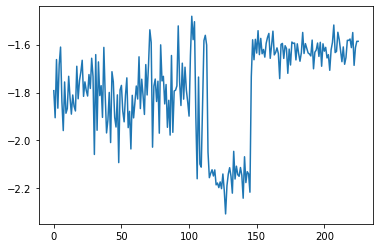

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 226, reward = -1.647318


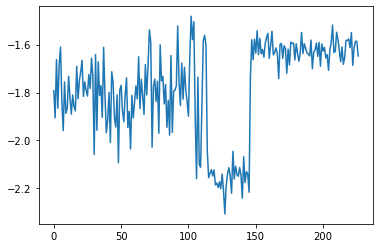

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 227, reward = -1.568418


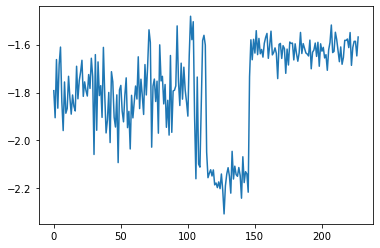

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 228, reward = -1.671103


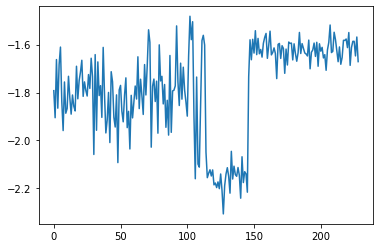

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 229, reward = -1.609851


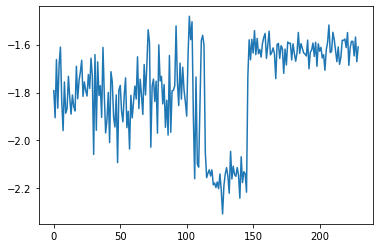

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 230, reward = -1.612521


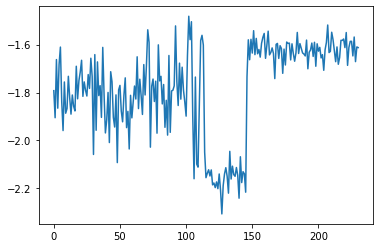

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 231, reward = -1.606213


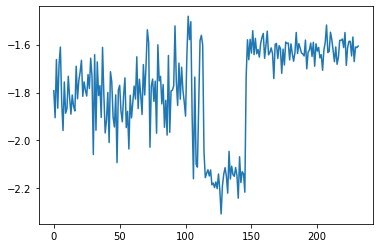

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 232, reward = -1.723894


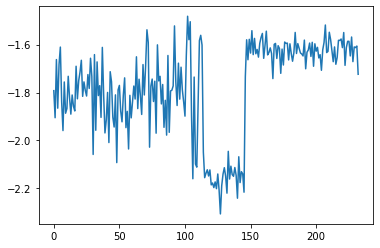

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 233, reward = -1.639368


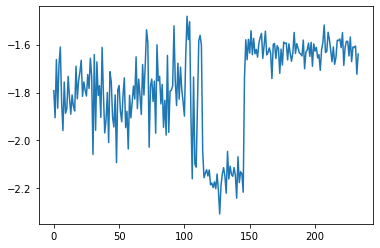

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 234, reward = -1.629420


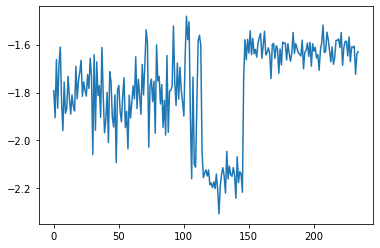

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 235, reward = -1.615566


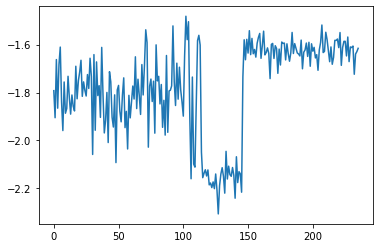

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 236, reward = -1.608276


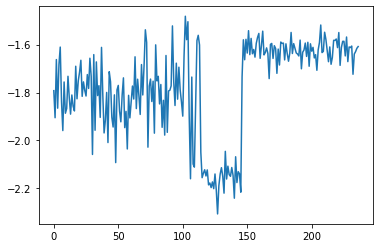

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 237, reward = -1.650953


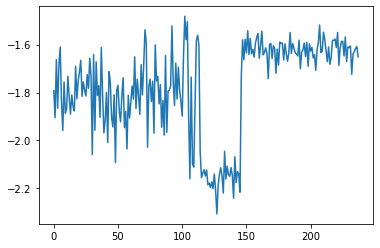

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 238, reward = -1.576243


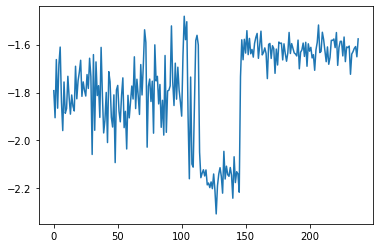

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 239, reward = -1.644101


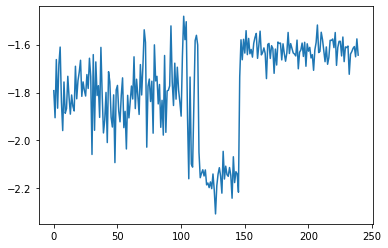

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 240, reward = -1.705691


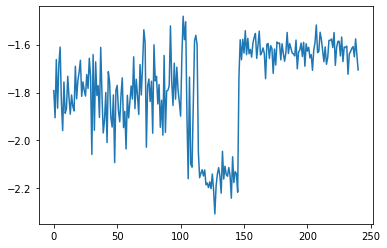

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 241, reward = -1.659738


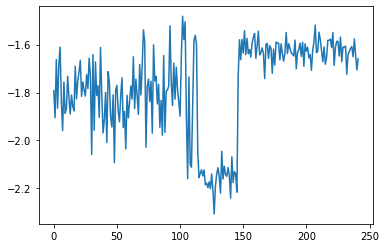

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 242, reward = -1.642176


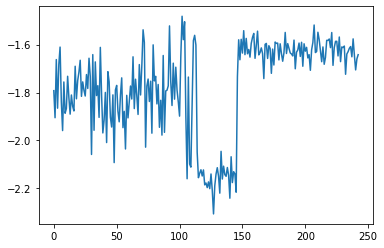

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 243, reward = -1.658704


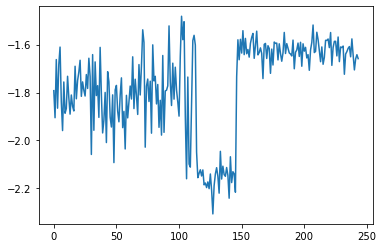

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 244, reward = -1.642281


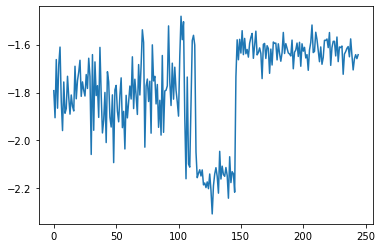

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 245, reward = -1.658368


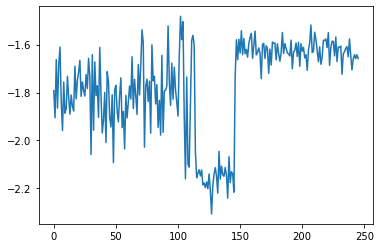

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 246, reward = -1.564892


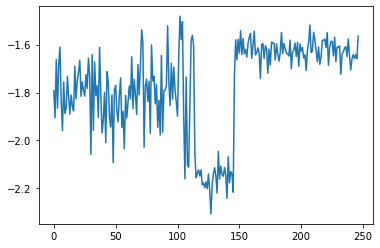

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 247, reward = -1.635295


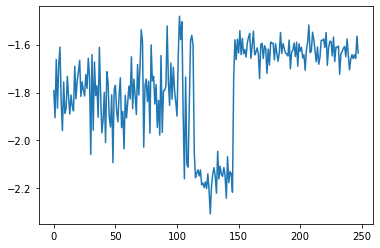

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 248, reward = -1.637681


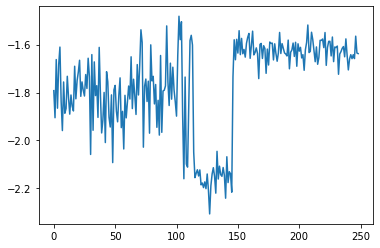

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 249, reward = -1.638607


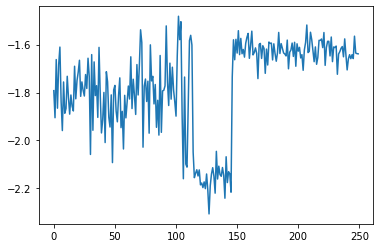

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 250, reward = -1.668755


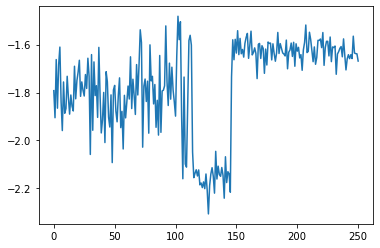

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 251, reward = -1.597262


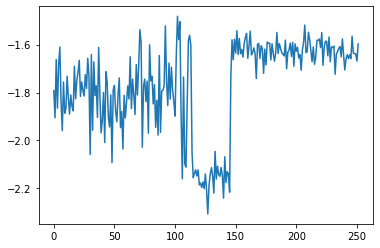

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 252, reward = -1.639625


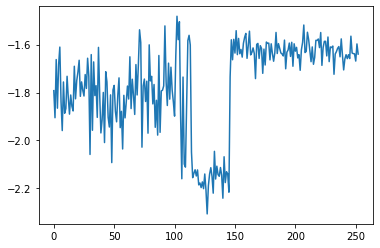

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 253, reward = -1.621955


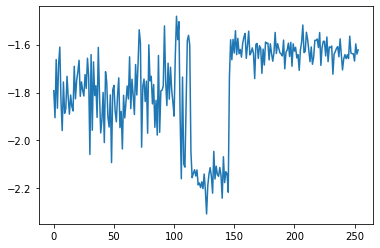

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 254, reward = -1.620583


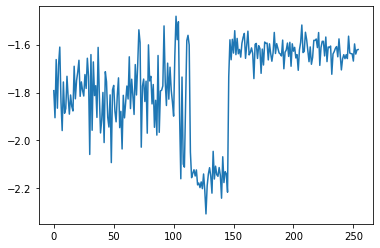

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 255, reward = -1.674771


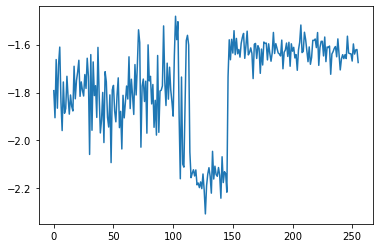

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 256, reward = -1.647024


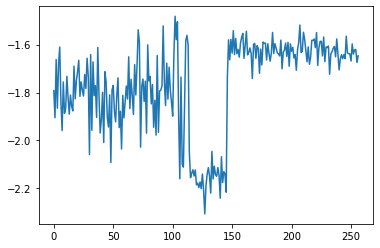

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 257, reward = -1.595499


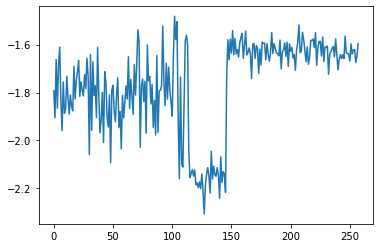

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 258, reward = -1.629009


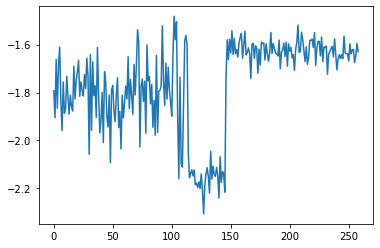

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 259, reward = -1.636986


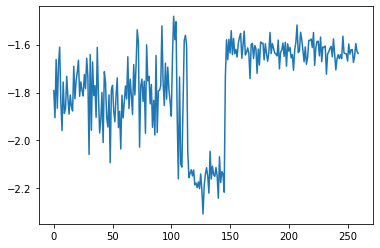

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 260, reward = -1.606670


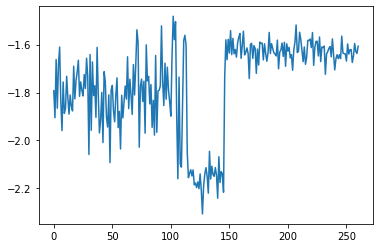

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 261, reward = -1.671198


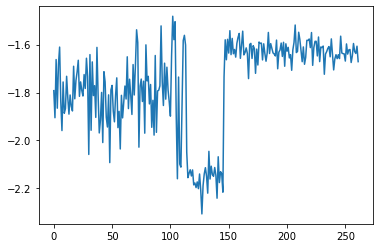

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 262, reward = -1.541747


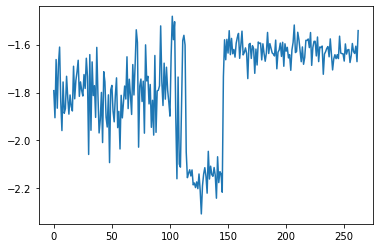

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 263, reward = -1.572323


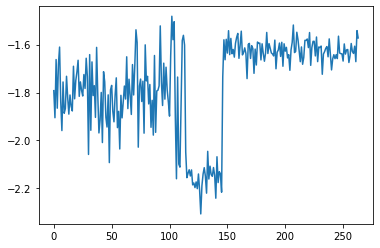

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 264, reward = -1.535755


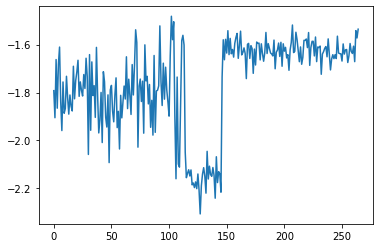

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 265, reward = -1.683293


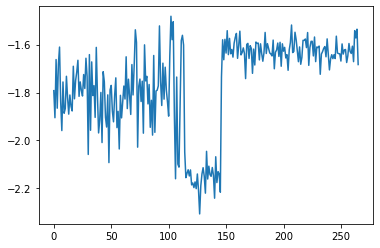

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 266, reward = -1.575373


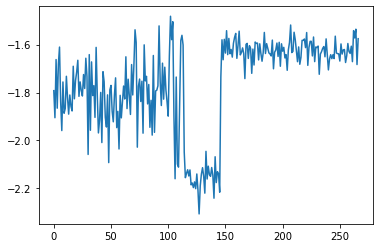

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 267, reward = -1.636291


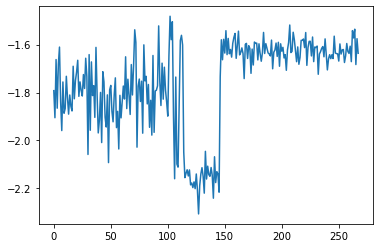

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 268, reward = -1.632267


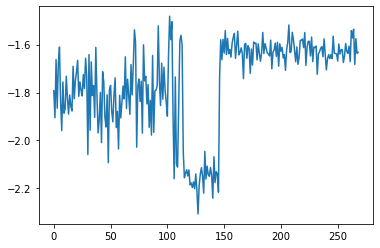

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 269, reward = -1.586925


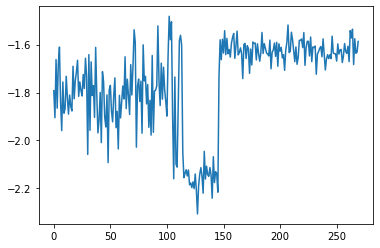

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 270, reward = -1.619592


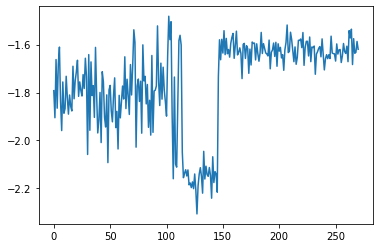

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 271, reward = -1.592837


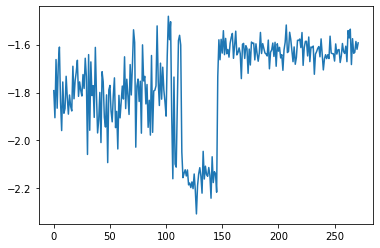

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 272, reward = -1.631185


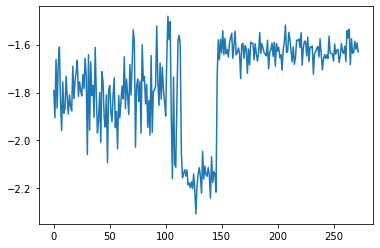

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 273, reward = -1.618872


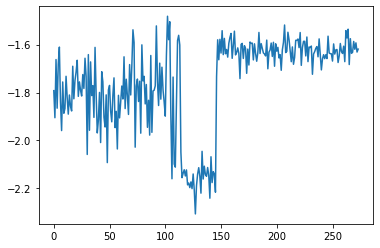

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 274, reward = -1.569295


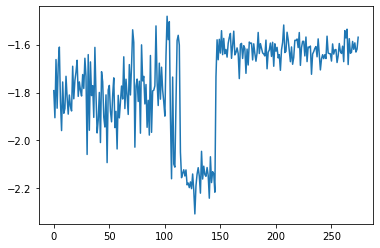

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 275, reward = -1.631345


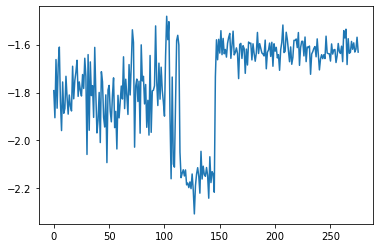

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 276, reward = -1.608560


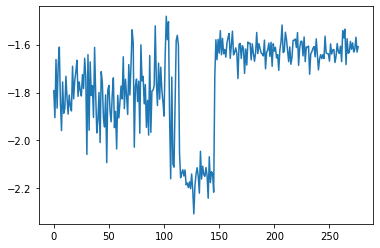

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 277, reward = -1.628899


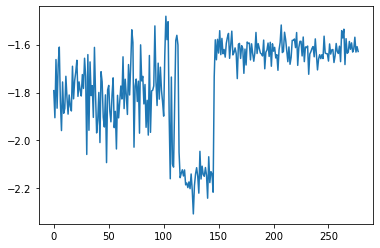

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 278, reward = -1.642057


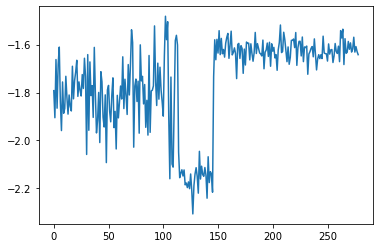

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 279, reward = -1.612529


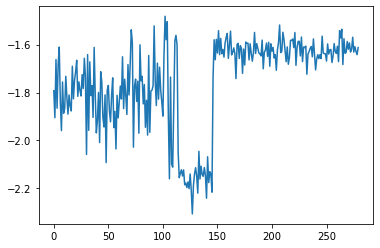

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 280, reward = -1.616049


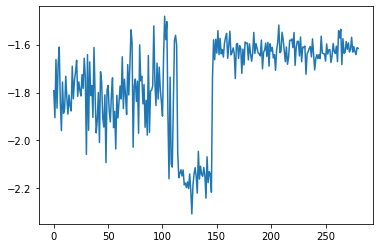

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 281, reward = -1.632017


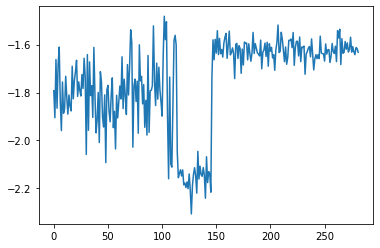

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 282, reward = -1.629912


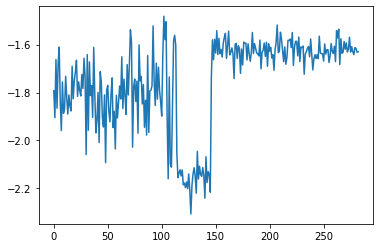

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 283, reward = -1.582761


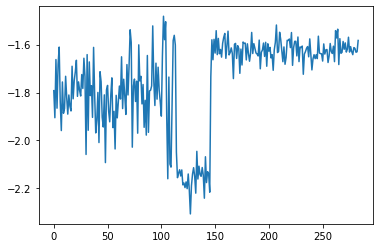

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 284, reward = -1.608624


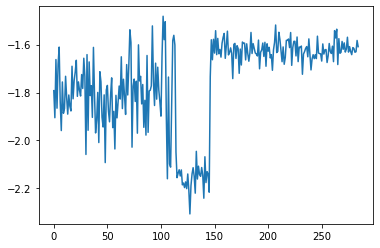

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 285, reward = -1.577494


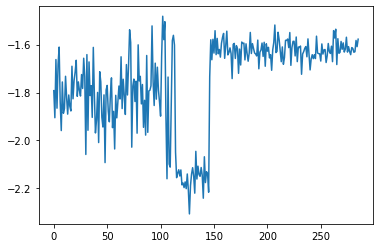

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 286, reward = -1.610071


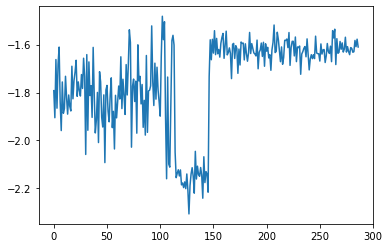

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 287, reward = -1.638829


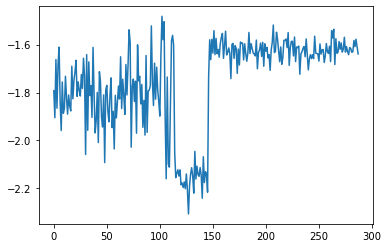

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 288, reward = -1.599542


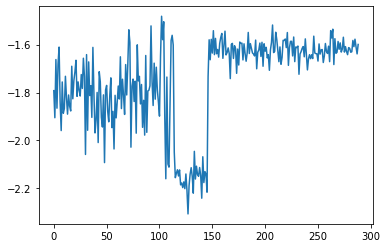

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 289, reward = -1.637993


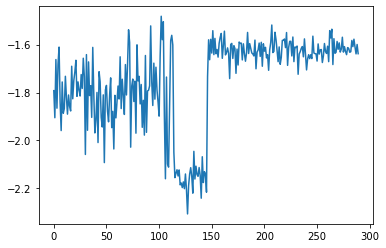

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 290, reward = -1.578776


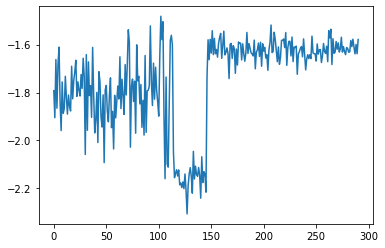

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 291, reward = -1.639275


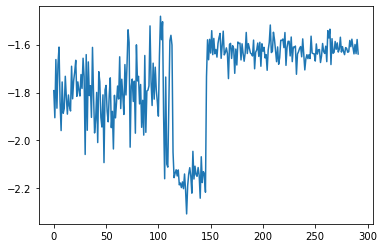

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 292, reward = -1.651755


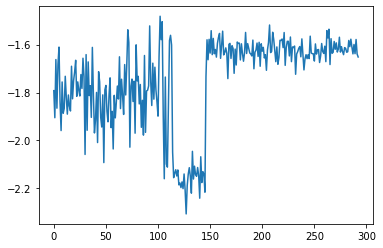

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 293, reward = -1.536478


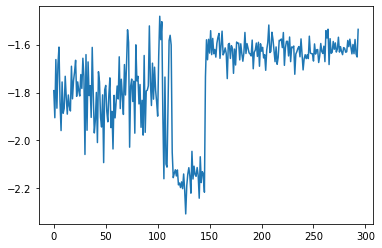

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 294, reward = -1.642004


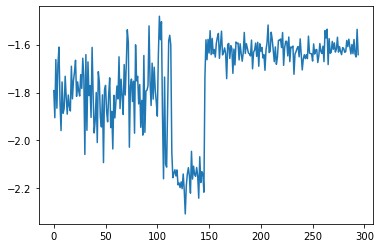

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 295, reward = -1.599785


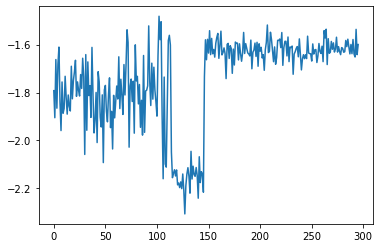

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 296, reward = -1.685142


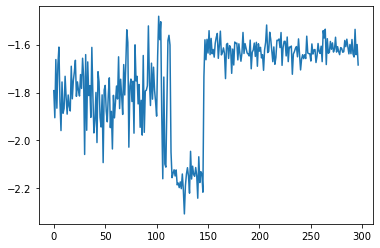

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 297, reward = -1.695111


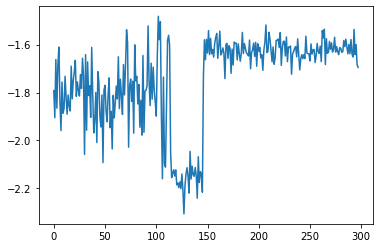

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 298, reward = -1.614131


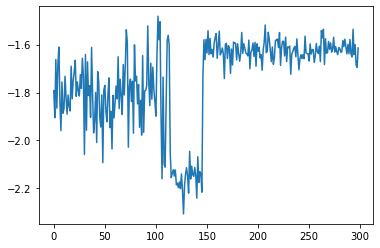

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 299, reward = -1.572197


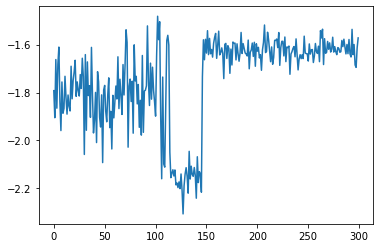

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 300, reward = -1.609481


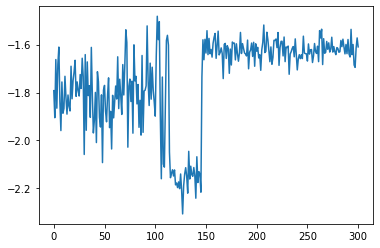

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 301, reward = -1.664664


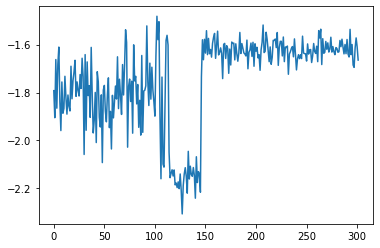

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 302, reward = -1.616976


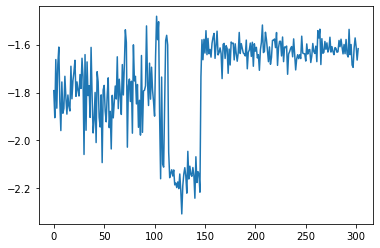

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 303, reward = -1.648861


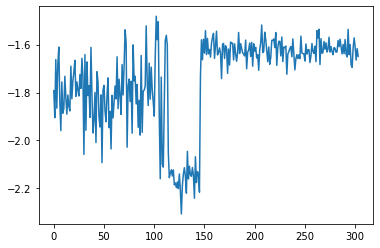

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 304, reward = -1.671219


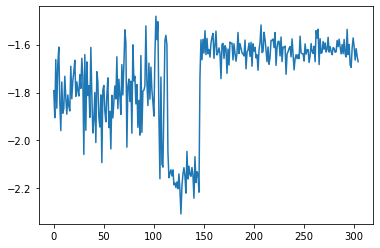

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 305, reward = -1.584032


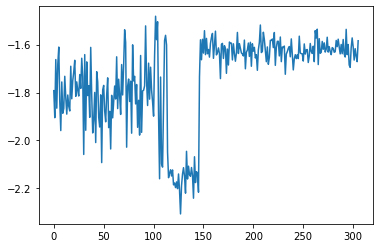

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 306, reward = -1.544102


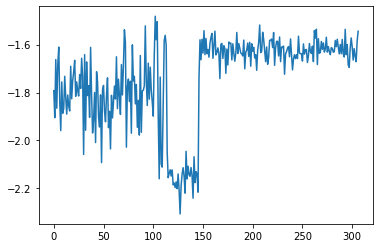

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 307, reward = -1.691338


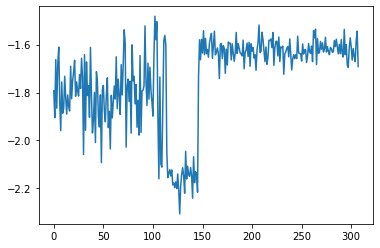

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 308, reward = -1.661278


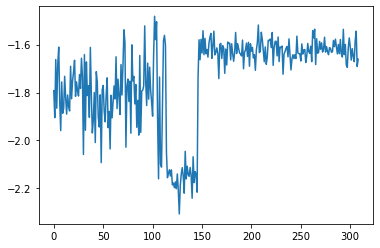

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 309, reward = -1.563963


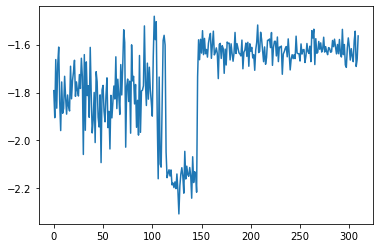

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 310, reward = -1.610985


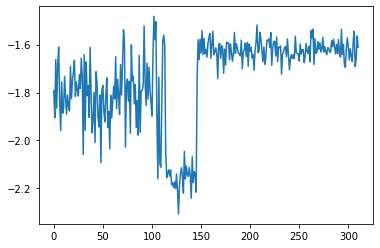

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 311, reward = -1.617592


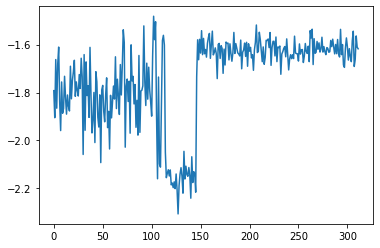

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 312, reward = -1.681543


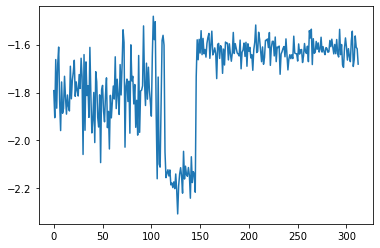

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 313, reward = -1.586686


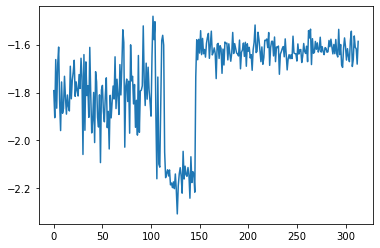

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 314, reward = -1.639485


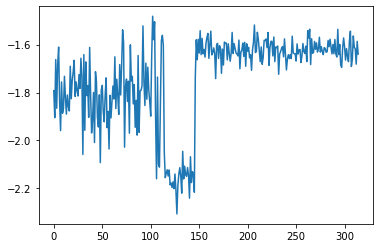

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 315, reward = -1.658147


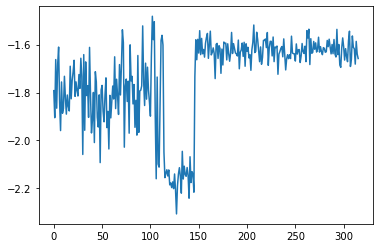

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 316, reward = -1.709359


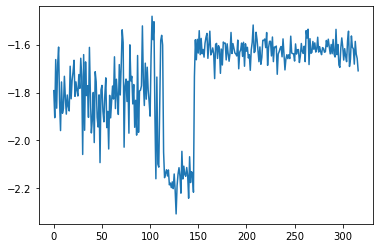

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 317, reward = -1.571003


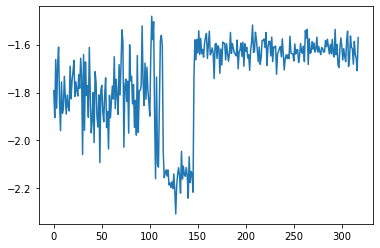

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 318, reward = -1.610335


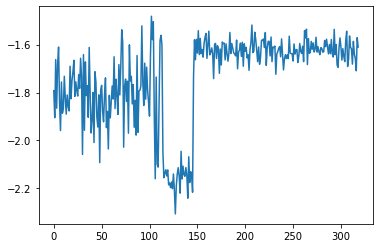

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 319, reward = -1.571721


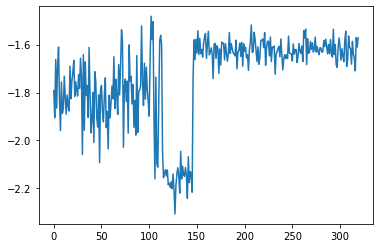

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 320, reward = -1.631303


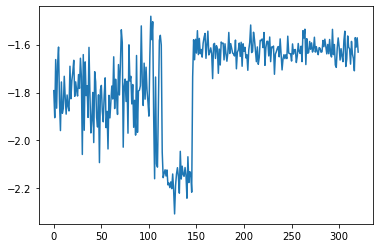

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 321, reward = -1.629946


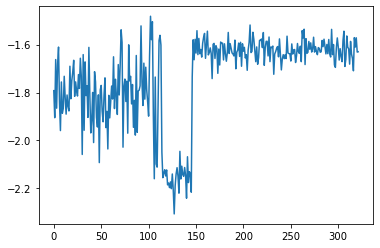

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 322, reward = -1.602165


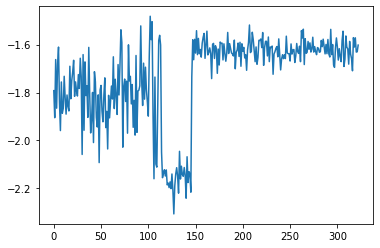

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 323, reward = -1.595762


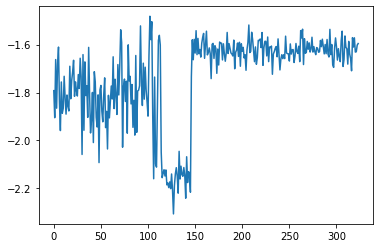

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 324, reward = -1.655856


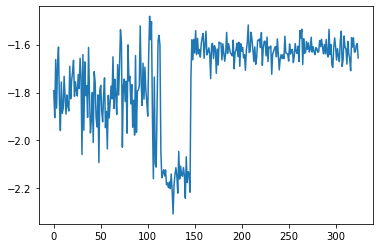

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 325, reward = -1.595842


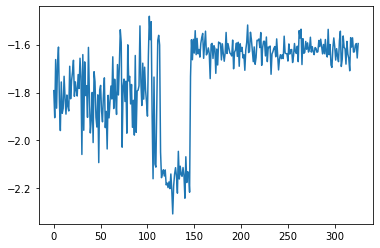

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 326, reward = -1.636146


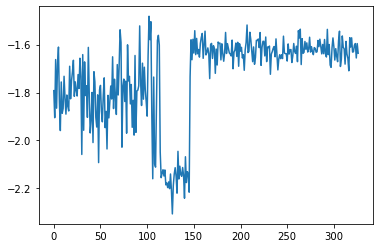

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 327, reward = -1.594964


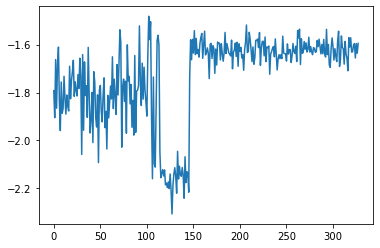

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 328, reward = -1.679982


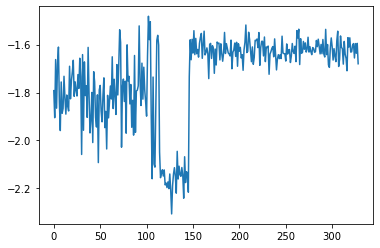

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 329, reward = -1.633499


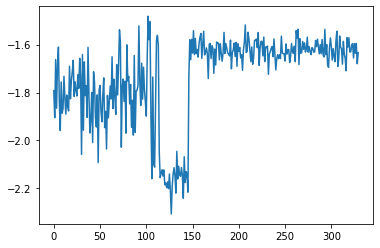

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 330, reward = -1.642875


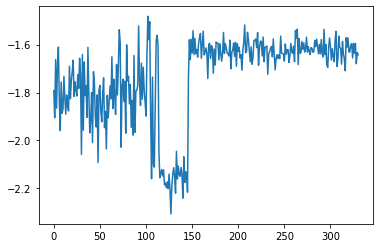

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 331, reward = -1.615581


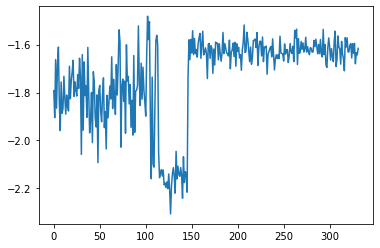

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 332, reward = -1.612859


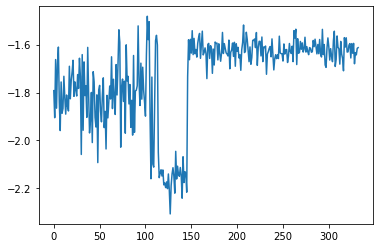

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 333, reward = -1.567632


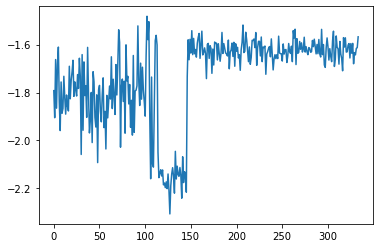

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 334, reward = -1.614491


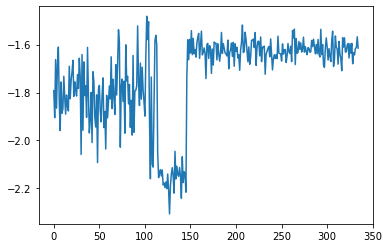

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 335, reward = -1.593216


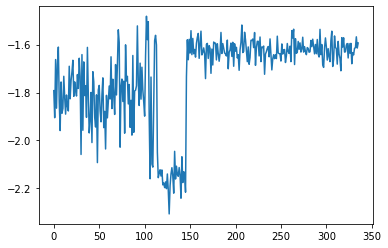

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 336, reward = -1.596426


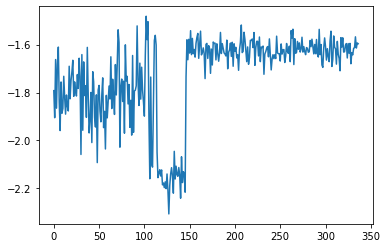

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 337, reward = -1.616121


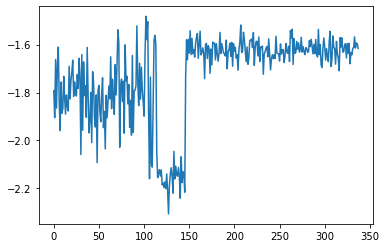

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 338, reward = -1.617651


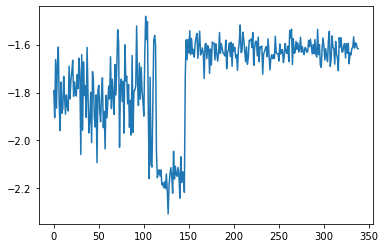

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 339, reward = -1.619838


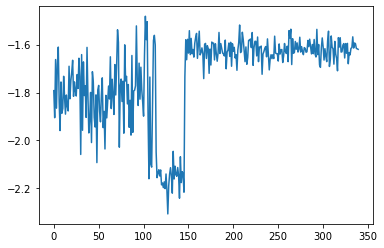

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 340, reward = -1.593060


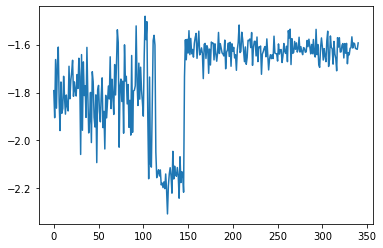

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 341, reward = -1.596415


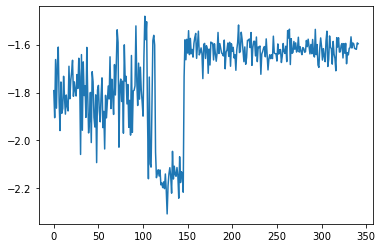

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 342, reward = -1.596687


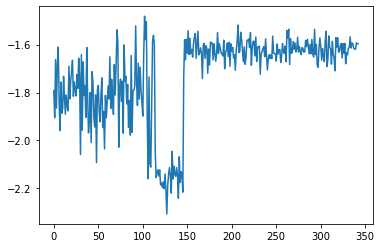

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 343, reward = -1.650182


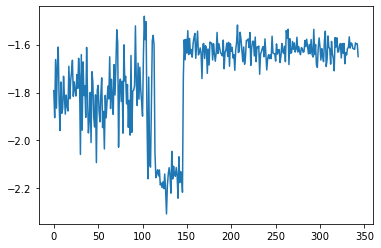

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 344, reward = -1.631680


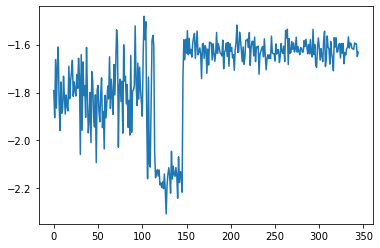

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 345, reward = -1.644335


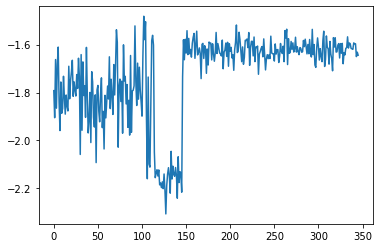

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 346, reward = -1.616356


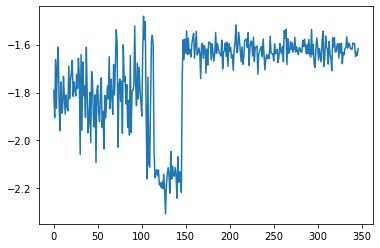

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 347, reward = -1.679132


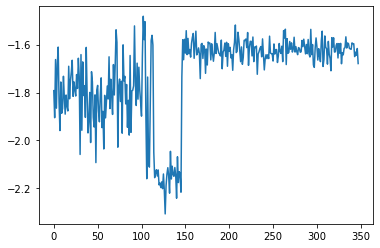

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 348, reward = -1.553663


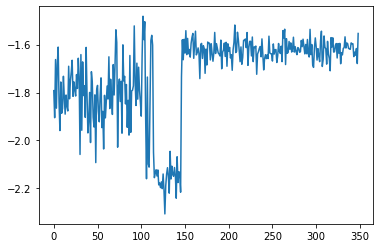

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 349, reward = -1.680370


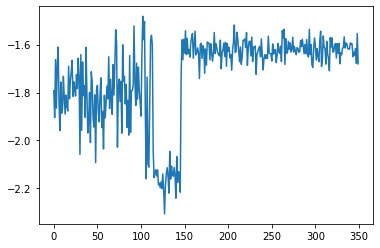

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 350, reward = -1.638773


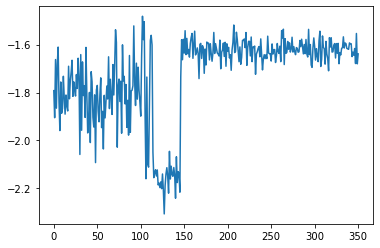

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 351, reward = -1.669881


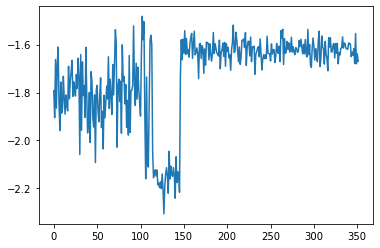

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 352, reward = -1.672573


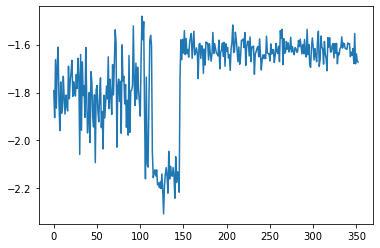

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 353, reward = -1.634250


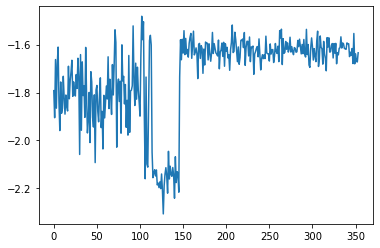

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 354, reward = -1.647554


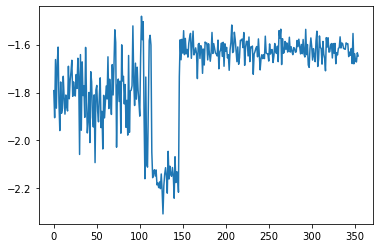

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 355, reward = -1.652071


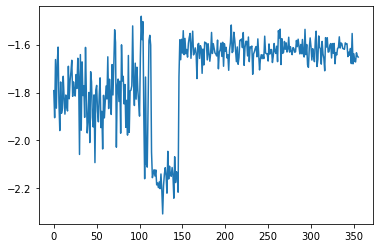

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 356, reward = -1.594344


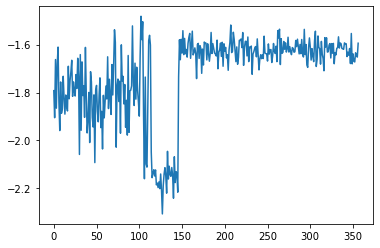

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 357, reward = -1.595111


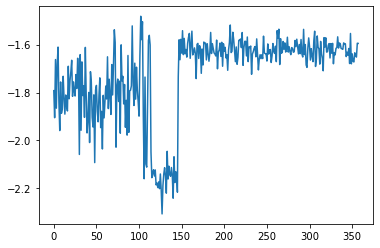

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 358, reward = -1.669823


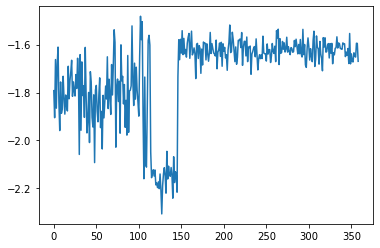

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 359, reward = -1.609860


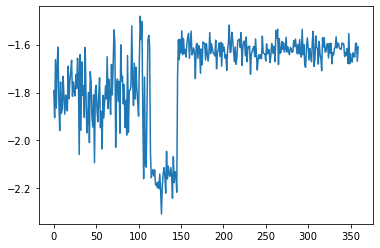

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 360, reward = -1.600750


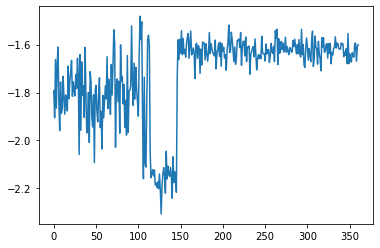

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 361, reward = -1.589608


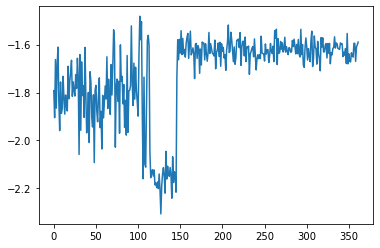

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 362, reward = -1.567824


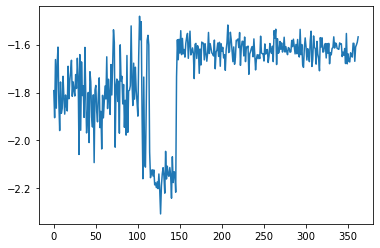

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 363, reward = -1.688918


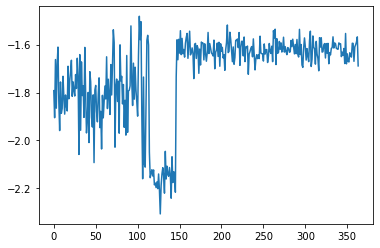

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 364, reward = -1.560599


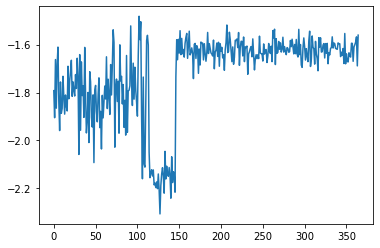

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 365, reward = -1.619390


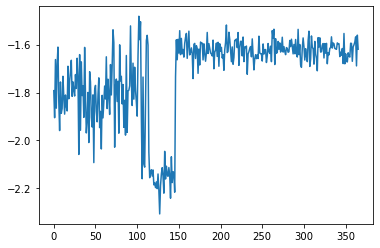

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 366, reward = -1.627399


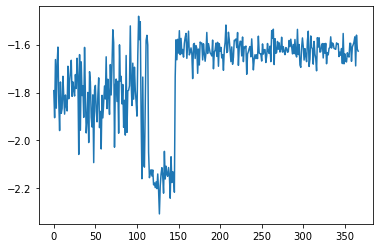

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 367, reward = -1.637885


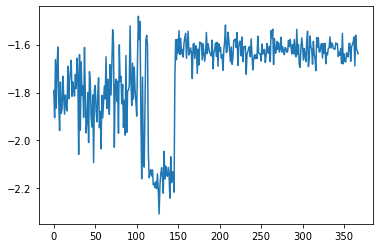

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 368, reward = -1.636189


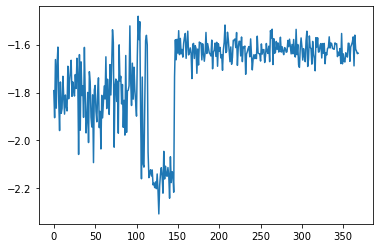

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 369, reward = -1.619644


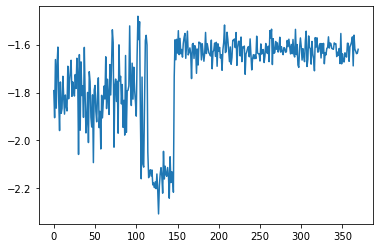

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 370, reward = -1.588018


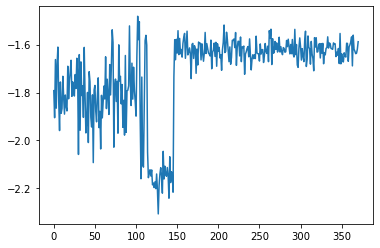

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 371, reward = -1.619845


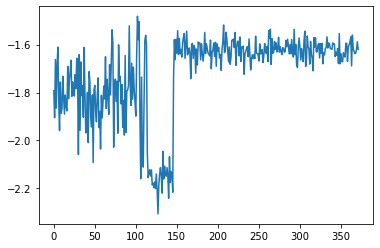

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 372, reward = -1.638347


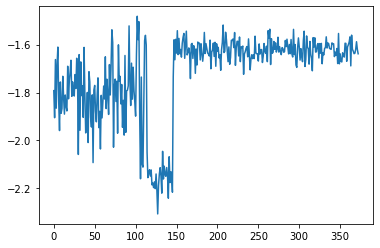

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 373, reward = -1.632831


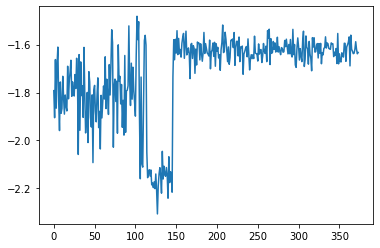

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 374, reward = -1.653032


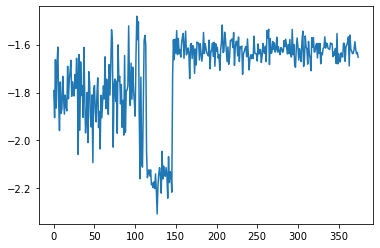

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 375, reward = -1.699954


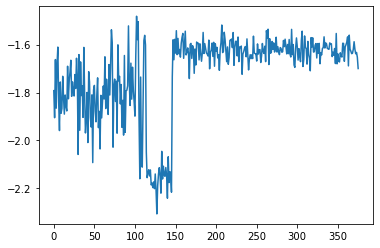

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 376, reward = -1.615421


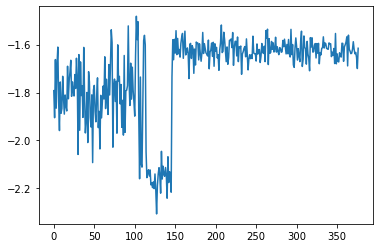

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 377, reward = -1.553608


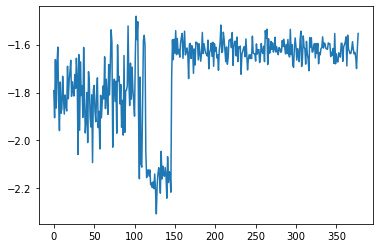

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 378, reward = -1.639517


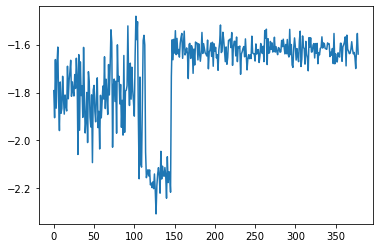

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 379, reward = -1.634657


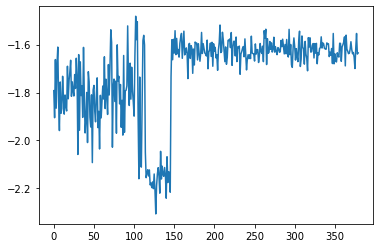

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 380, reward = -1.545159


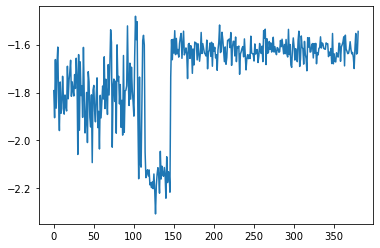

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 381, reward = -1.590440


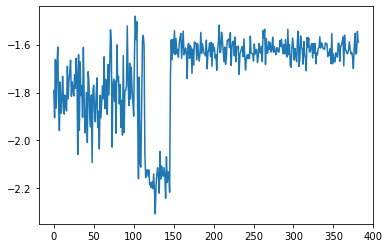

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 382, reward = -1.600326


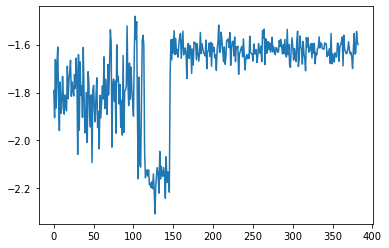

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 383, reward = -1.678936


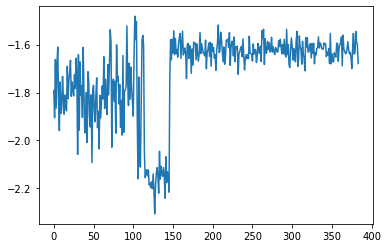

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 384, reward = -1.667930


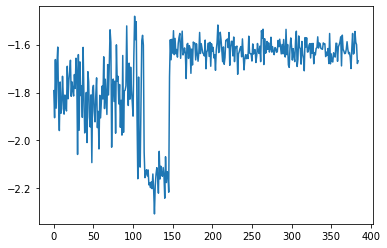

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 385, reward = -1.618777


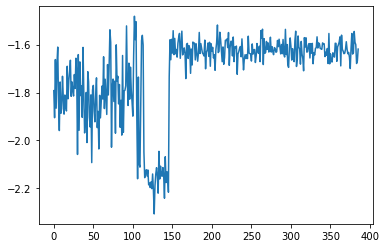

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 386, reward = -1.569505


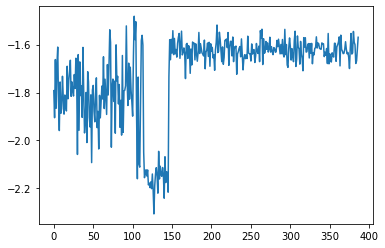

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 387, reward = -1.612293


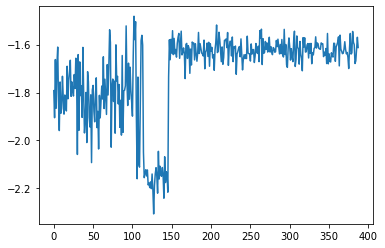

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 388, reward = -1.694767


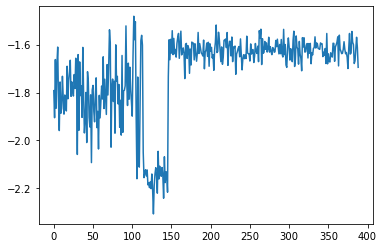

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 389, reward = -1.568913


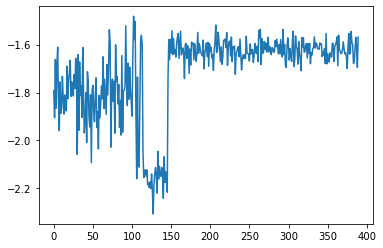

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 390, reward = -1.625905


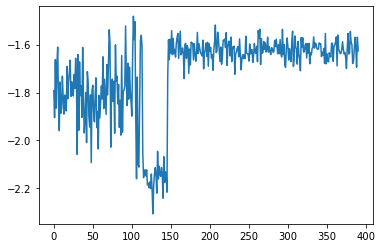

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 391, reward = -1.595922


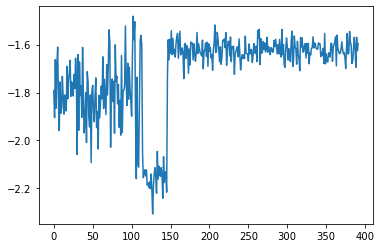

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 392, reward = -1.684548


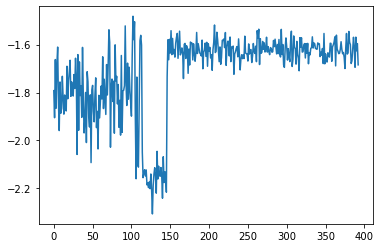

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 393, reward = -1.579788


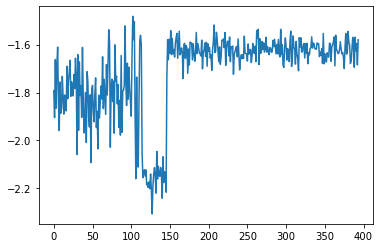

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 394, reward = -1.584693


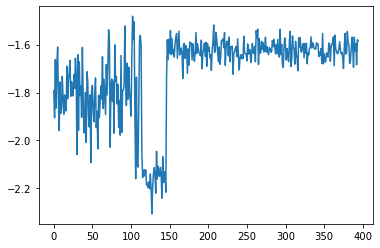

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 395, reward = -1.605516


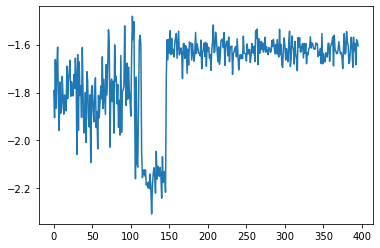

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 396, reward = -1.540616


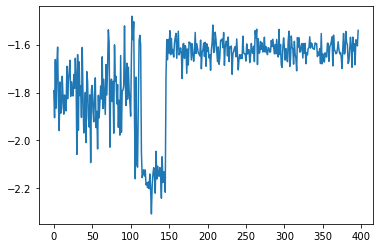

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 397, reward = -1.687372


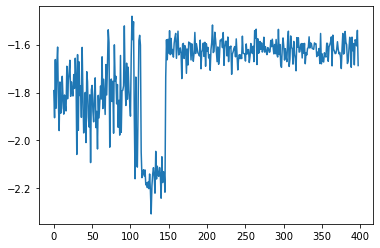

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 398, reward = -1.624577


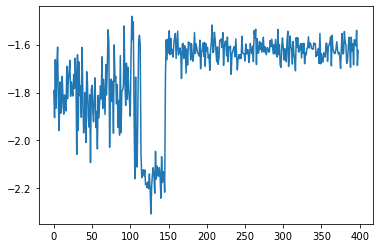

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 399, reward = -1.545817


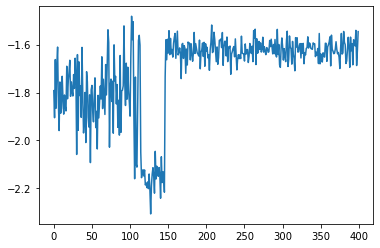

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 400, reward = -1.617660


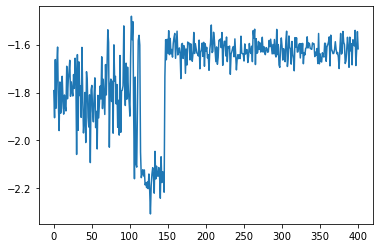

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 401, reward = -1.648901


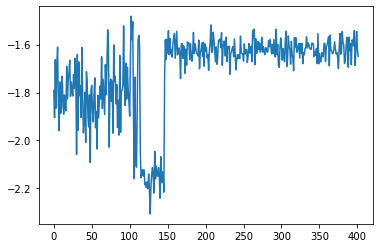

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 402, reward = -1.645428


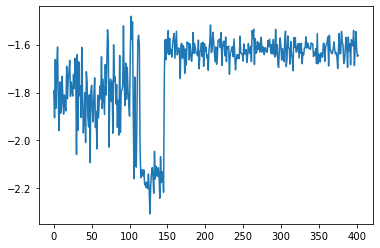

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 403, reward = -1.596689


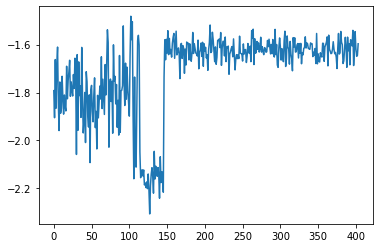

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 404, reward = -1.614543


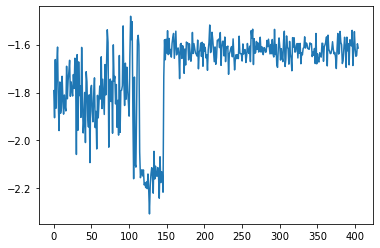

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 405, reward = -1.595138


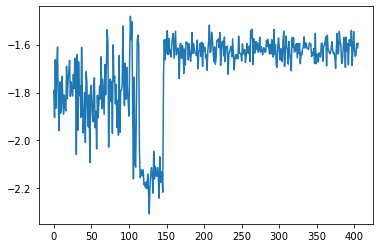

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 406, reward = -1.594130


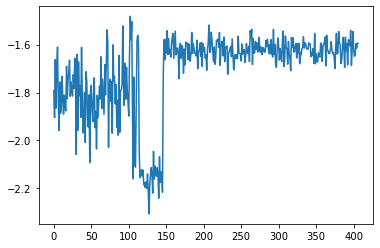

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 407, reward = -1.625910


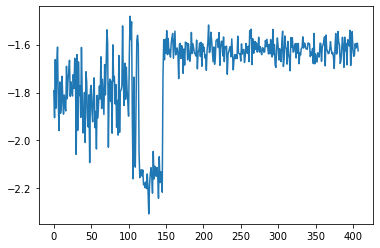

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 408, reward = -1.682981


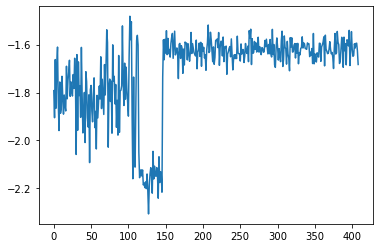

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 409, reward = -1.593645


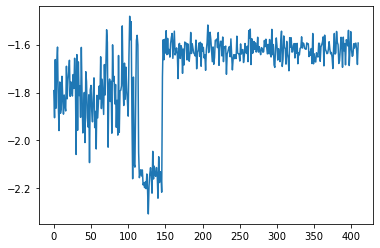

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 410, reward = -1.542816


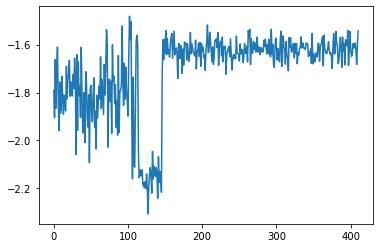

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 411, reward = -1.614450


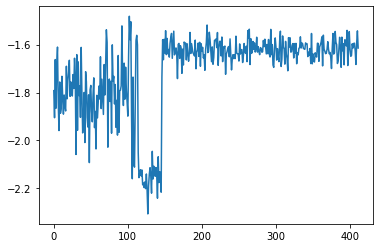

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 412, reward = -1.603404


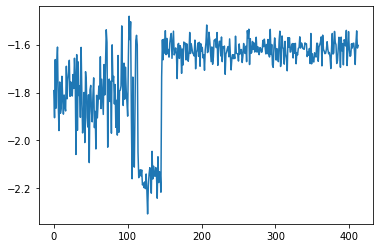

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 413, reward = -1.616120


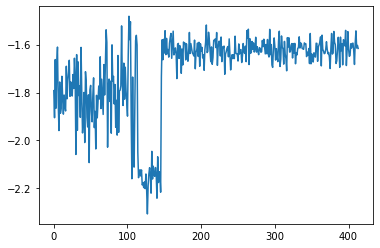

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 414, reward = -1.602776


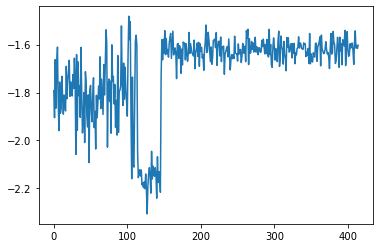

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 415, reward = -1.605372


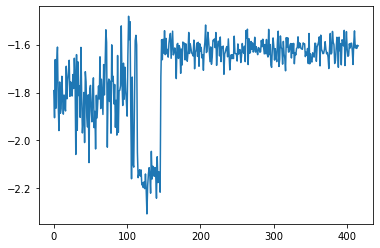

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 416, reward = -1.630113


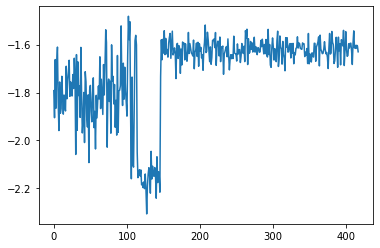

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 417, reward = -1.583789


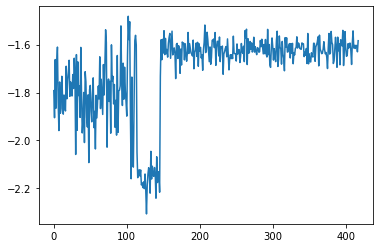

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 418, reward = -1.646469


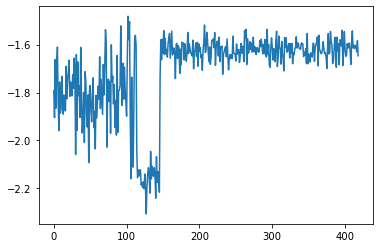

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 419, reward = -1.702253


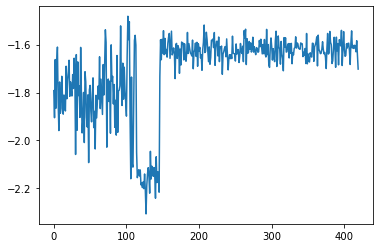

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 420, reward = -1.525337


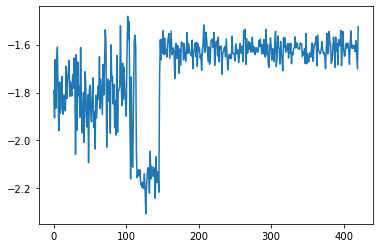

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 421, reward = -1.079036


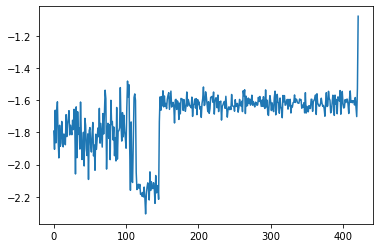

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 422, reward = -1.104471


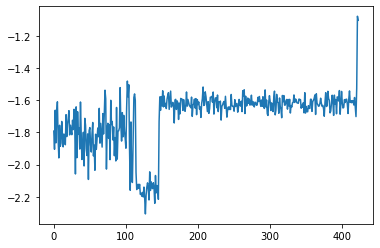

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 423, reward = -1.073811


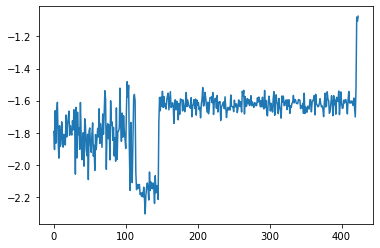

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 424, reward = -1.059280


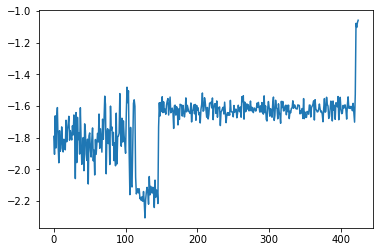

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 425, reward = -1.061693


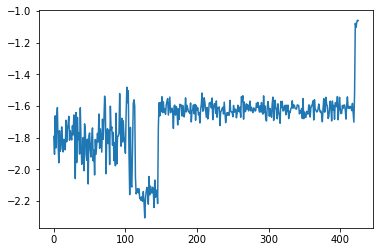

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 426, reward = -1.085990


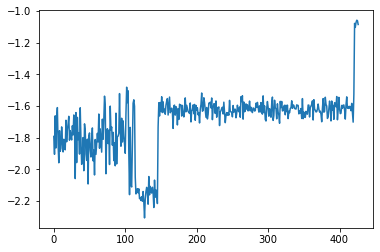

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 427, reward = -1.056434


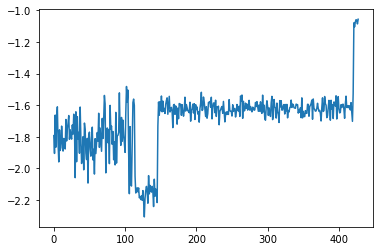

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 428, reward = -1.118374


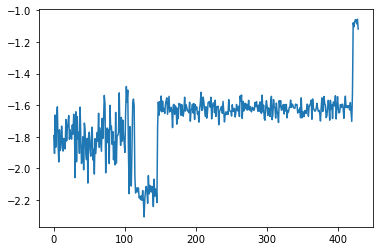

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 429, reward = -1.031397


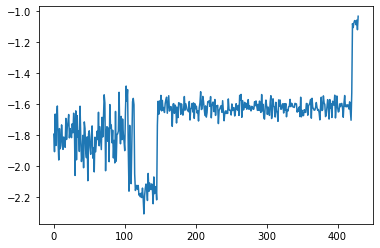

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 430, reward = -1.108656


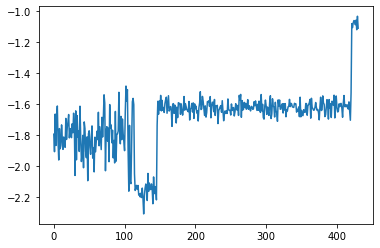

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 431, reward = -1.067267


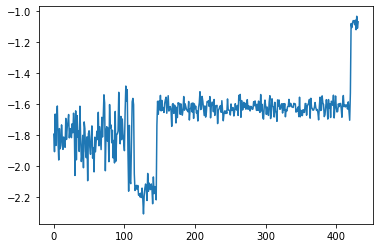

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 432, reward = -1.123607


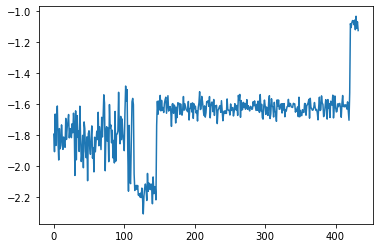

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 433, reward = -1.102218


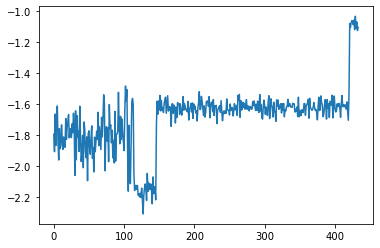

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 434, reward = -1.077261


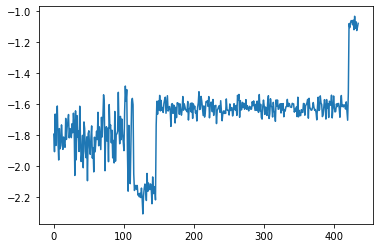

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 435, reward = -1.057869


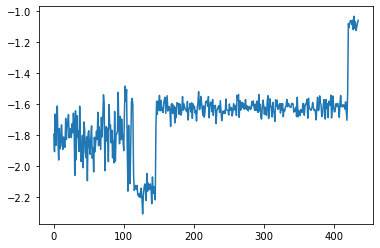

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 436, reward = -1.070198


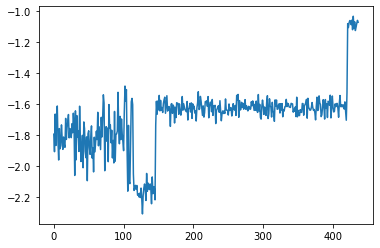

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 437, reward = -1.099589


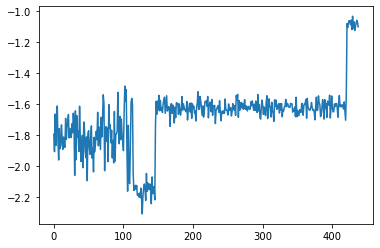

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 438, reward = -1.061507


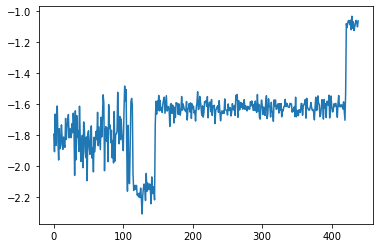

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 439, reward = -1.105856


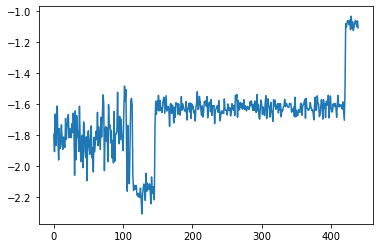

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 440, reward = -1.061369


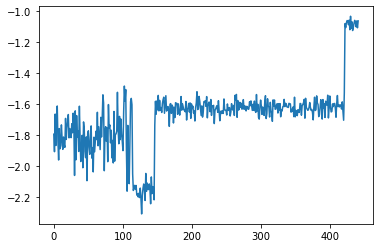

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 441, reward = -1.058248


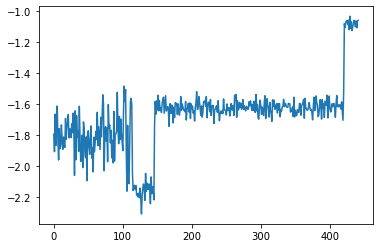

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 442, reward = -1.104440


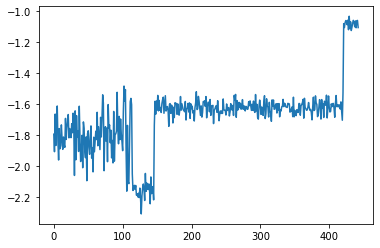

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 443, reward = -1.070393


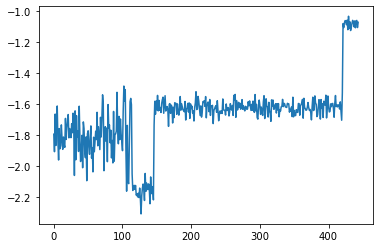

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 444, reward = -1.146715


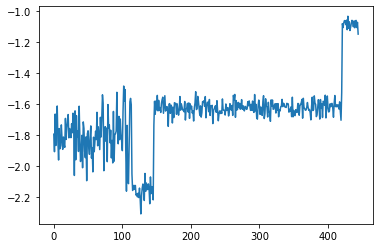

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 445, reward = -1.088757


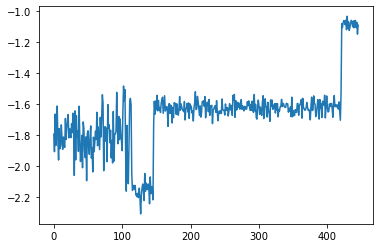

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 446, reward = -1.105026


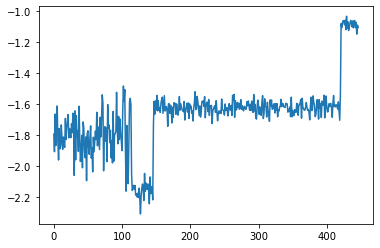

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 447, reward = -1.098085


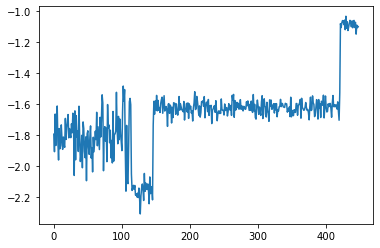

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 448, reward = -1.102991


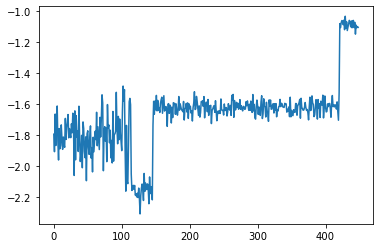

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 449, reward = -1.051961


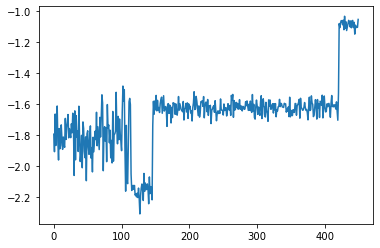

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 450, reward = -1.114804


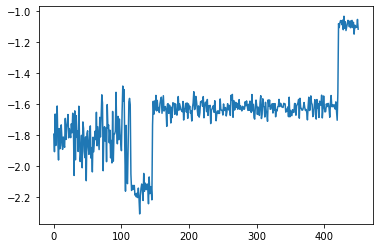

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 451, reward = -1.103387


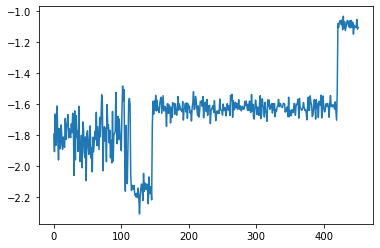

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 452, reward = -1.096989


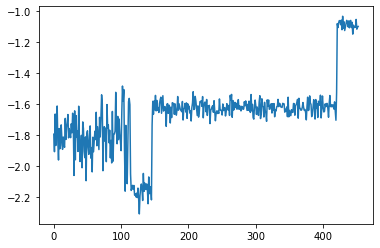

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 453, reward = -1.072888


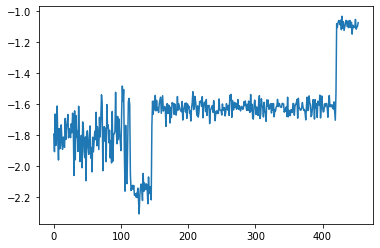

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 454, reward = -1.090127


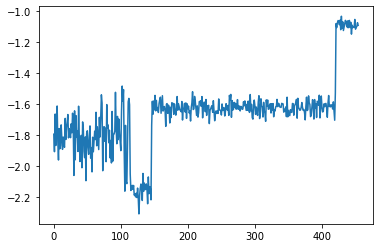

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 455, reward = -1.124015


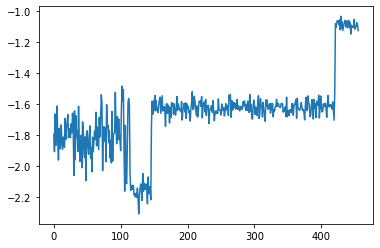

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 456, reward = -1.110935


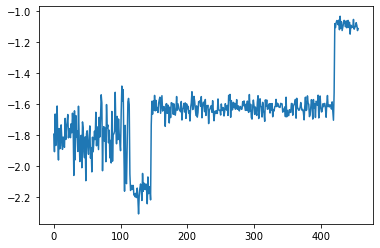

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 457, reward = -1.112330


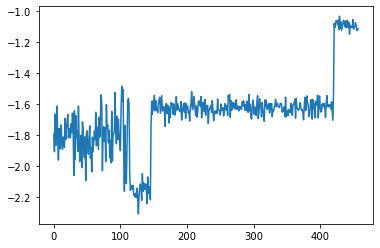

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 458, reward = -1.080990


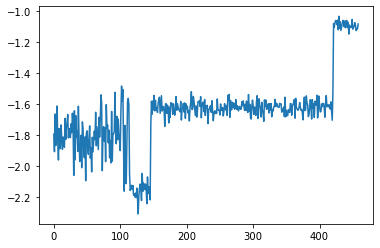

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 459, reward = -1.116689


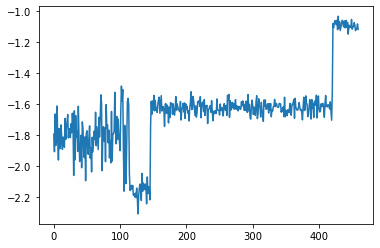

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 460, reward = -1.103650


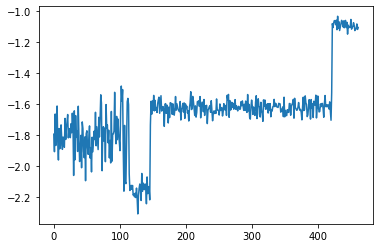

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 461, reward = -1.064078


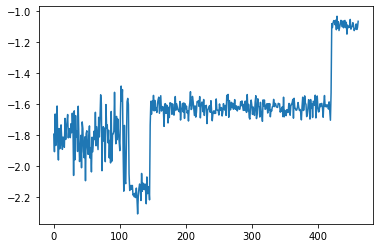

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 462, reward = -1.061524


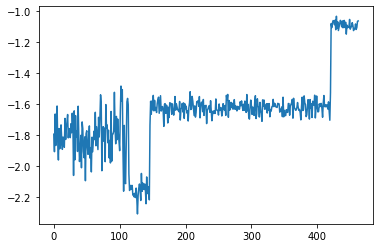

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 463, reward = -1.103346


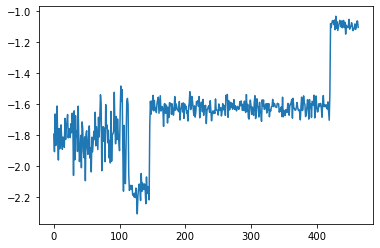

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 464, reward = -1.096085


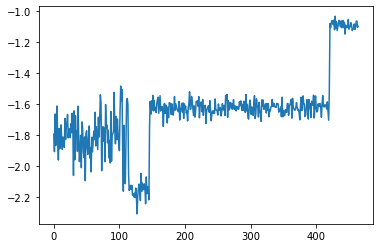

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 465, reward = -1.104862


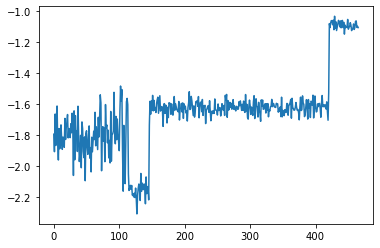

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 466, reward = -1.091424


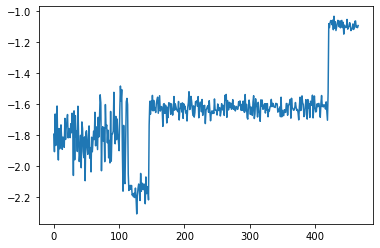

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 467, reward = -1.052220


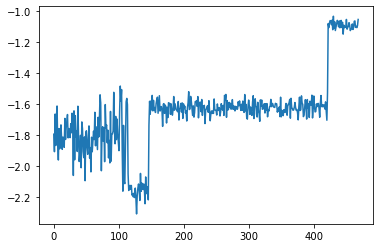

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 468, reward = -1.146230


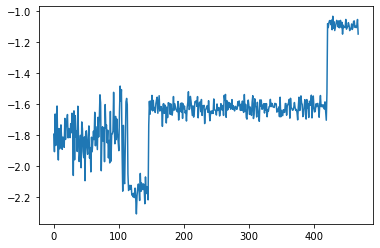

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 469, reward = -1.585041


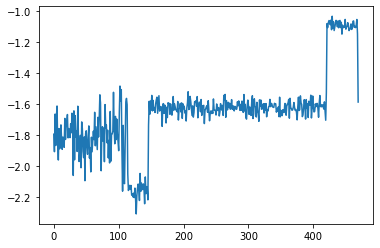

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 470, reward = -1.675364


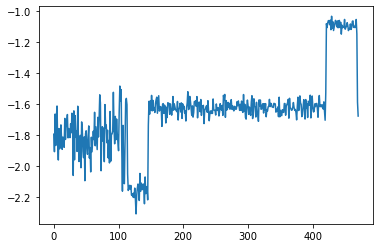

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 471, reward = -1.608184


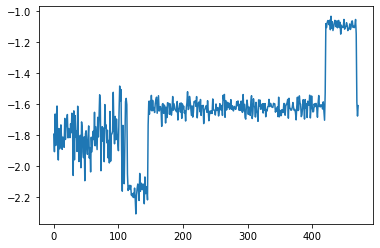

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 472, reward = -1.639826


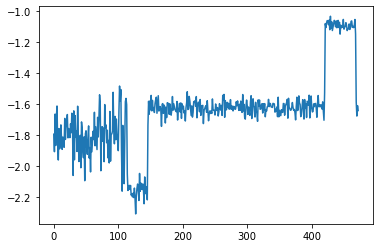

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 473, reward = -1.534741


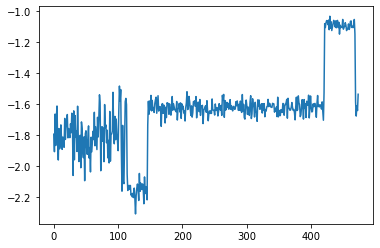

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 474, reward = -1.652678


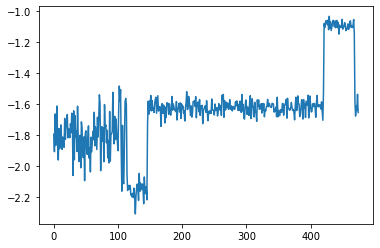

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 475, reward = -1.550517


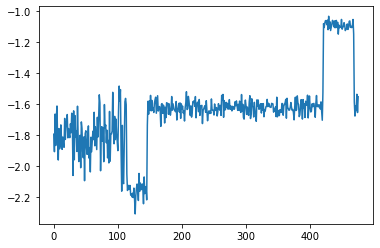

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 476, reward = -1.582843


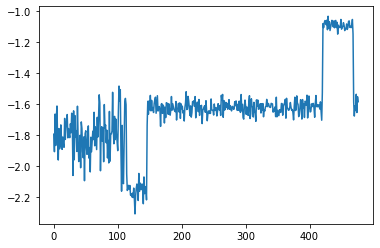

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 477, reward = -1.567605


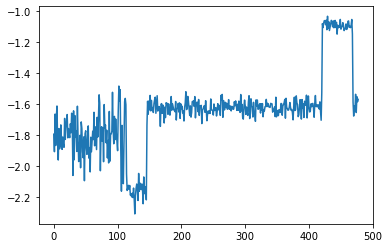

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 478, reward = -1.606285


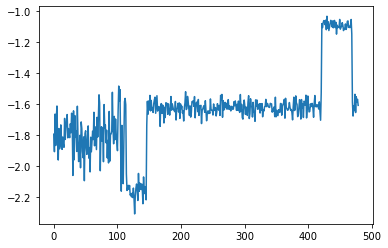

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 479, reward = -1.649915


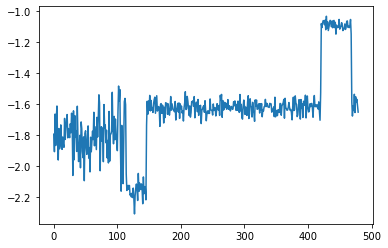

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 480, reward = -1.638226


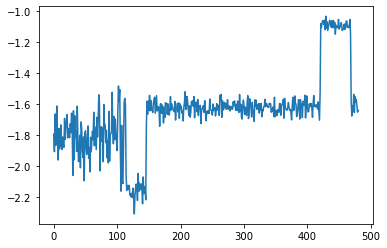

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 481, reward = -1.644322


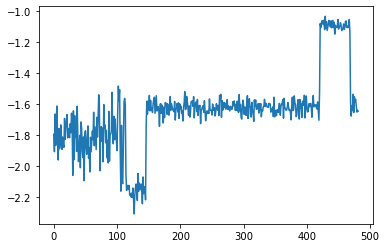

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 482, reward = -1.623106


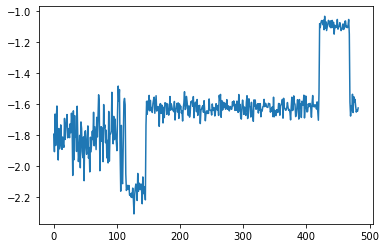

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 483, reward = -1.551713


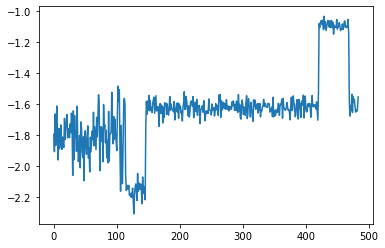

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 484, reward = -1.561226


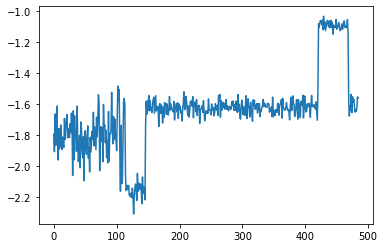

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 485, reward = -1.603572


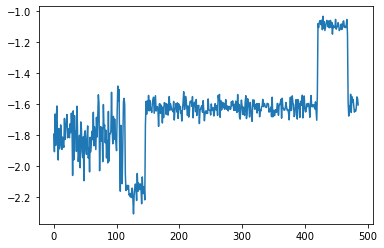

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 486, reward = -1.592198


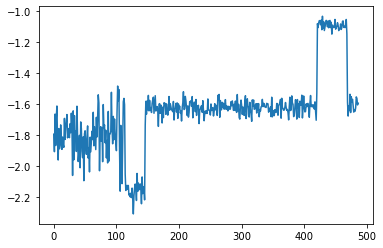

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 487, reward = -1.642815


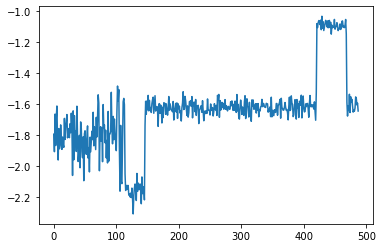

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 488, reward = -1.635605


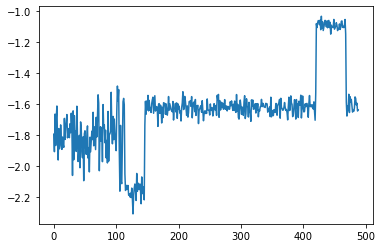

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 489, reward = -1.652876


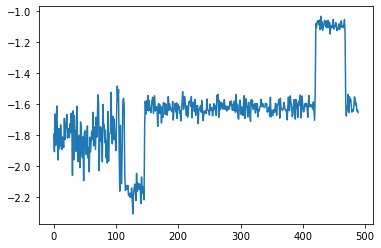

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 490, reward = -1.580284


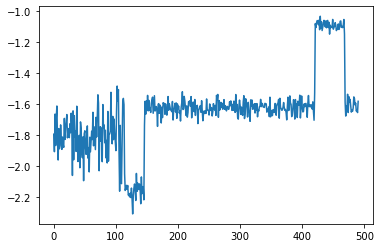

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 491, reward = -1.694117


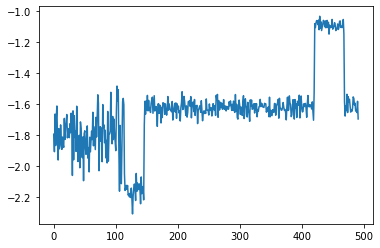

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 492, reward = -1.634876


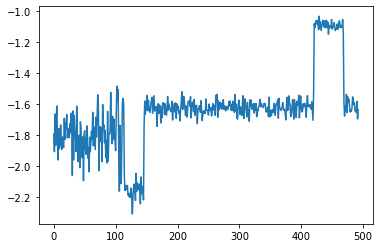

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 493, reward = -1.658465


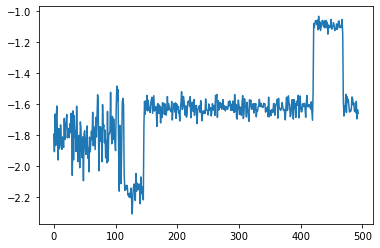

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 494, reward = -1.649315


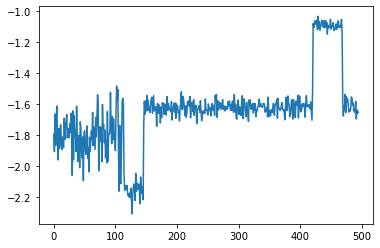

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 495, reward = -1.605805


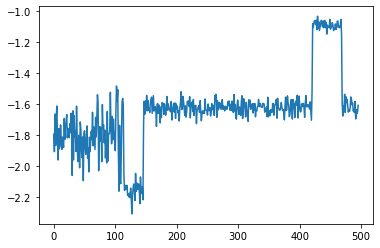

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 496, reward = -1.645383


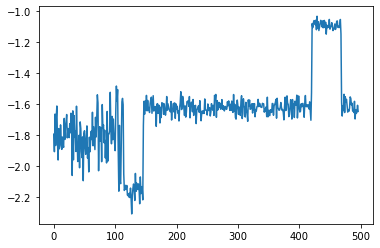

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 497, reward = -1.603361


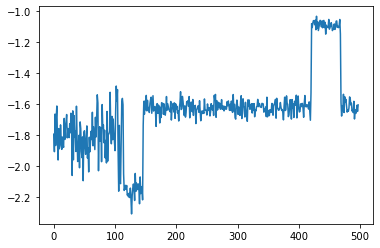

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 498, reward = -1.616958


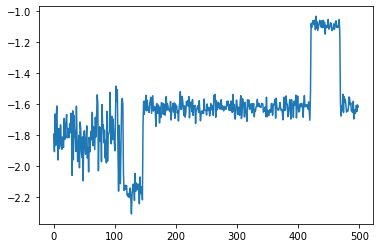

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 499, reward = -1.562578


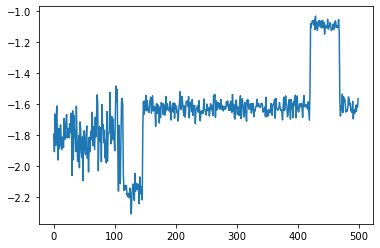

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 500, reward = -1.617370


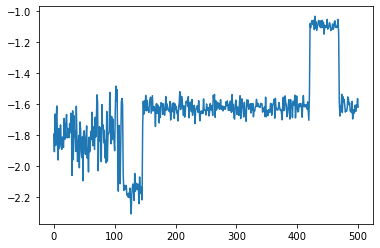

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 501, reward = -1.651703


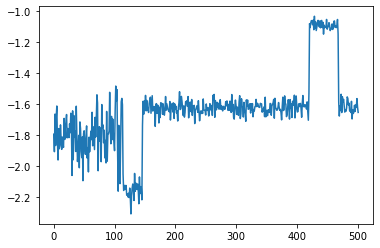

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 502, reward = -1.634099


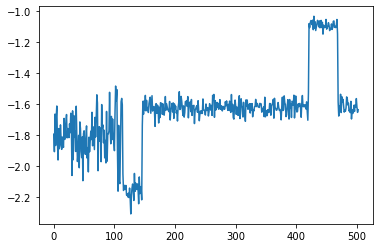

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 503, reward = -1.521747


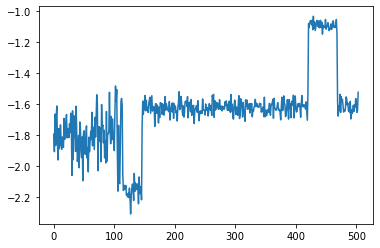

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 504, reward = -1.542640


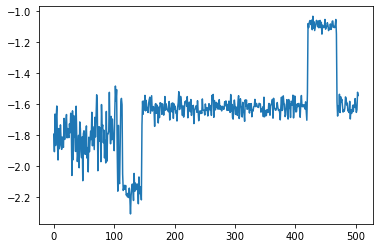

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 505, reward = -1.532046


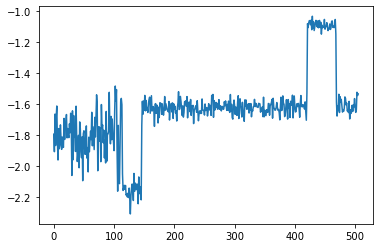

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 506, reward = -1.668501


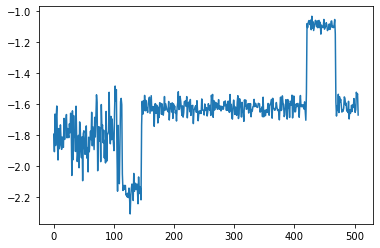

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 507, reward = -1.631227


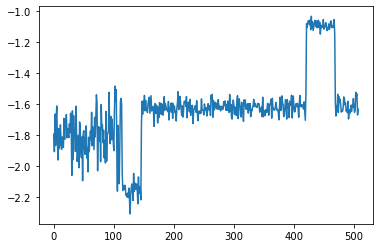

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 508, reward = -1.607032


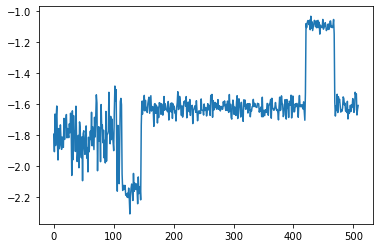

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 509, reward = -1.649448


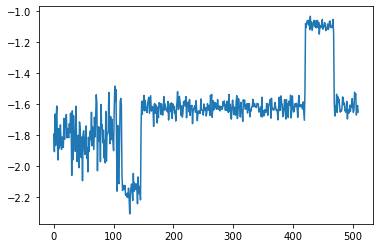

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 510, reward = -1.587860


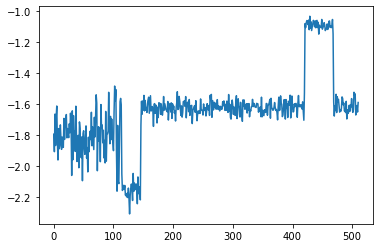

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 511, reward = -1.584175


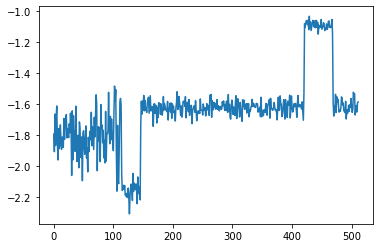

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 512, reward = -1.575545


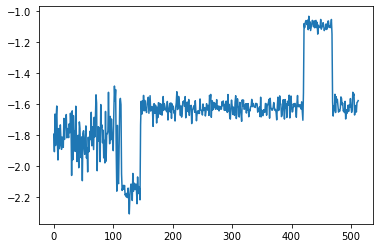

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 513, reward = -1.590303


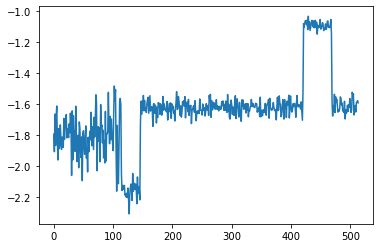

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 514, reward = -1.602279


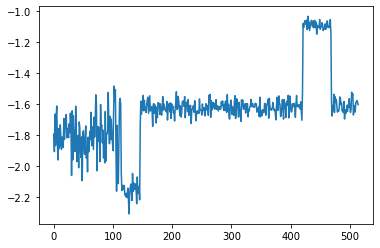

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 515, reward = -1.643111


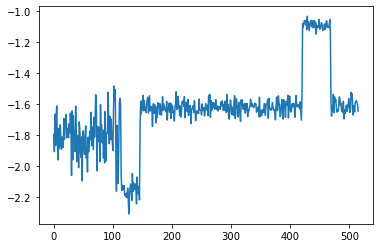

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 516, reward = -1.629383


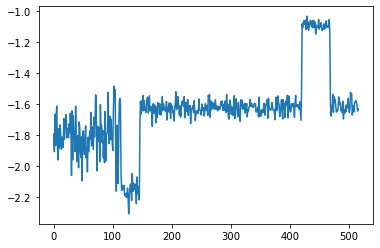

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 517, reward = -1.626970


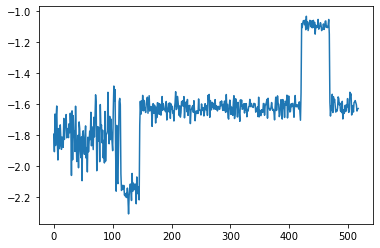

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 518, reward = -1.621299


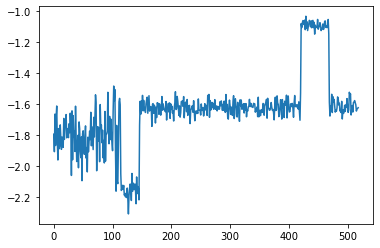

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 519, reward = -1.719431


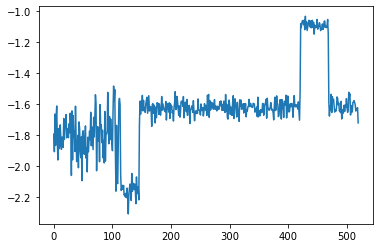

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 520, reward = -1.616755


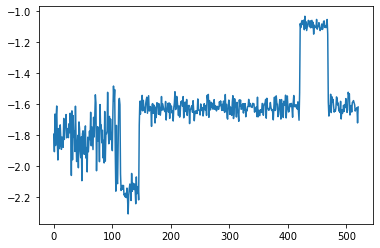

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 521, reward = -1.616866


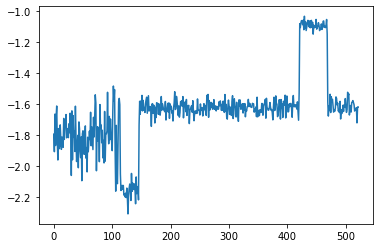

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 522, reward = -1.610374


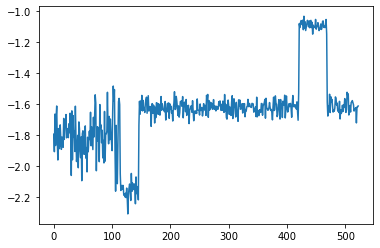

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 523, reward = -1.565331


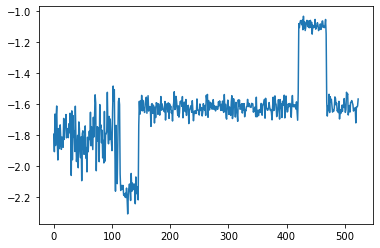

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 524, reward = -1.630582


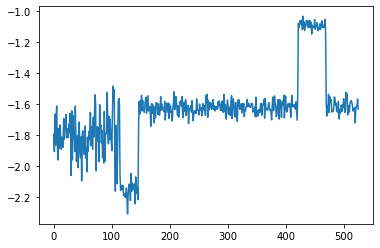

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 525, reward = -1.516822


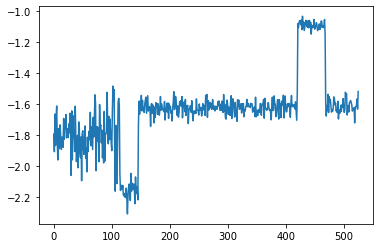

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 526, reward = -1.633928


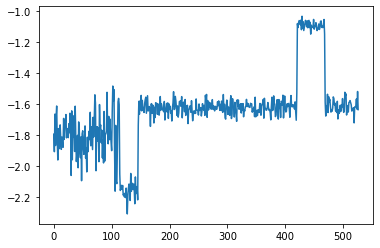

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 527, reward = -1.532494


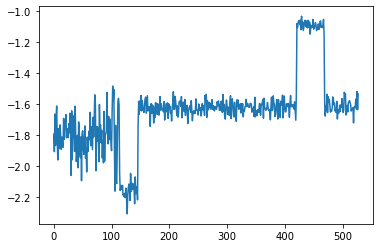

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 528, reward = -1.695216


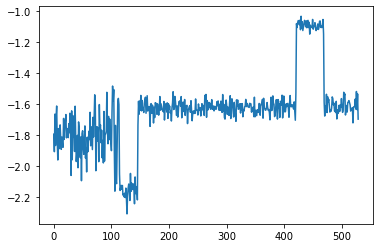

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 529, reward = -1.587350


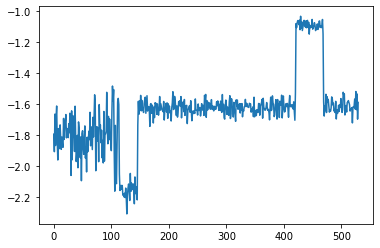

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 530, reward = -1.603909


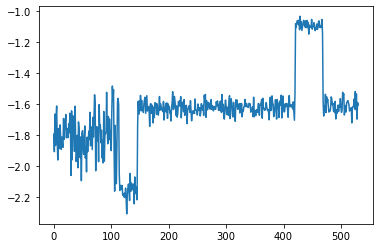

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 531, reward = -1.686728


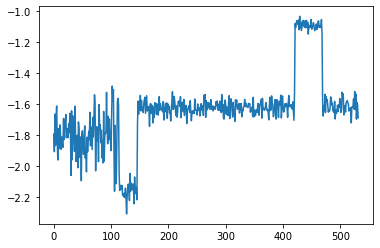

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 532, reward = -1.597117


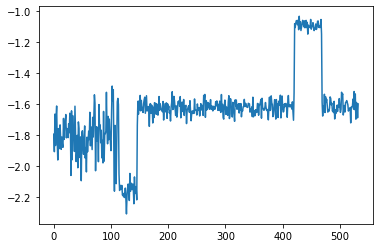

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 533, reward = -1.599095


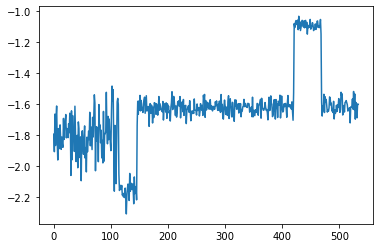

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 534, reward = -1.571479


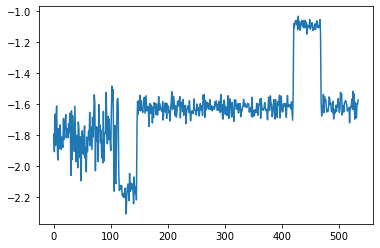

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 535, reward = -1.610974


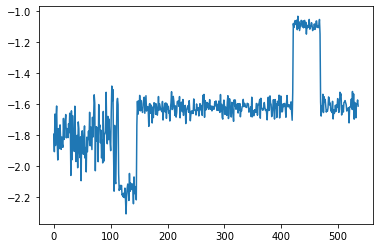

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 536, reward = -1.684325


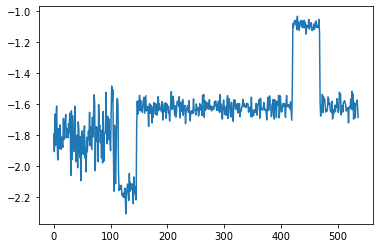

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 537, reward = -1.604260


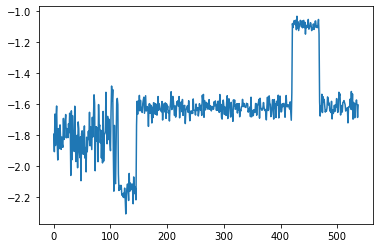

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 538, reward = -1.620291


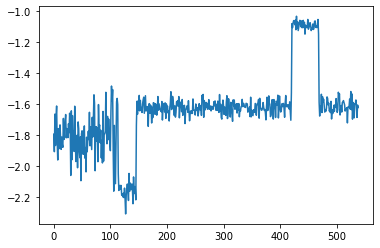

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 539, reward = -1.632240


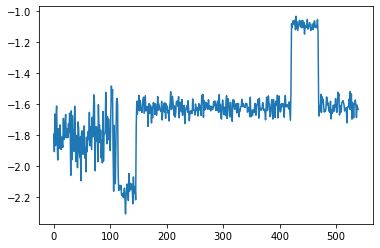

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 540, reward = -1.614773


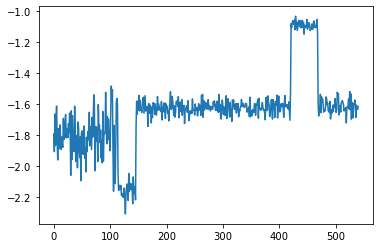

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 541, reward = -1.679961


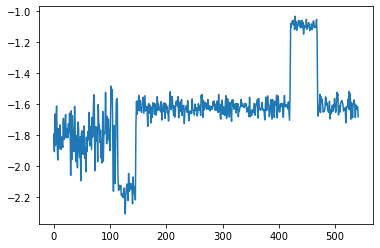

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 542, reward = -1.527926


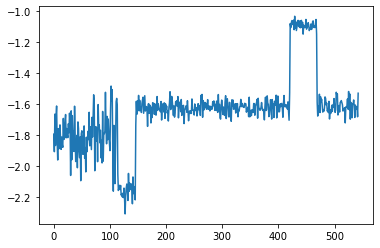

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 543, reward = -1.617164


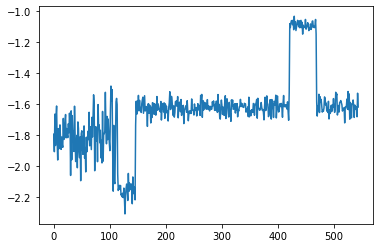

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 544, reward = -1.630508


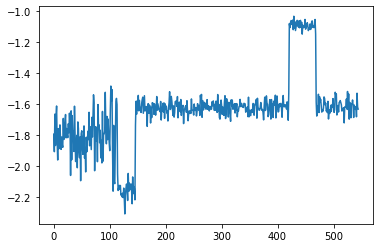

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 545, reward = -1.642382


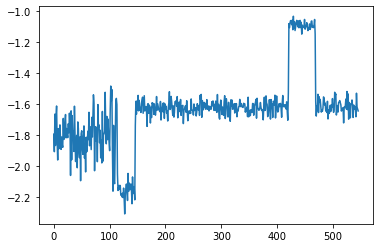

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 546, reward = -1.627144


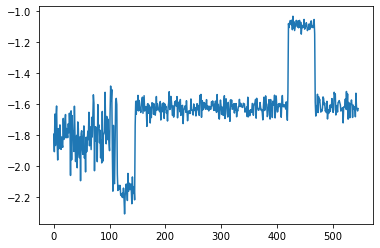

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 547, reward = -1.664136


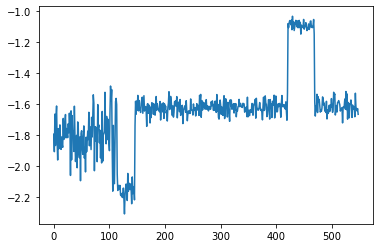

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 548, reward = -1.645769


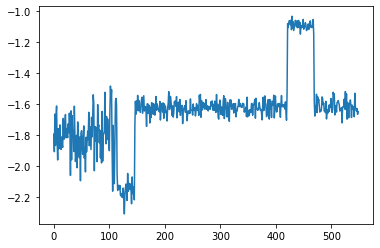

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 549, reward = -1.558156


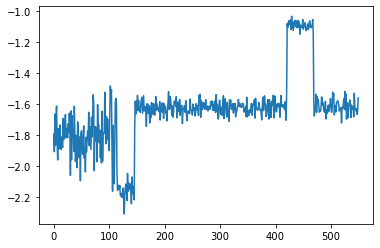

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 550, reward = -1.600618


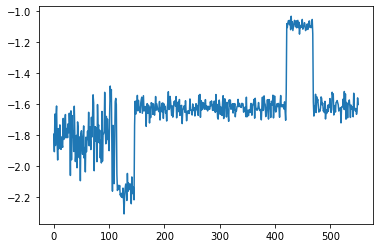

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 551, reward = -1.651651


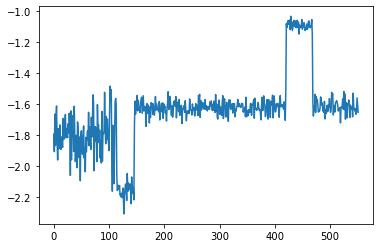

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 552, reward = -1.602166


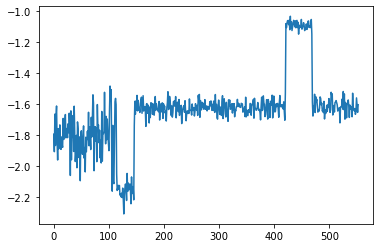

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 553, reward = -1.637226


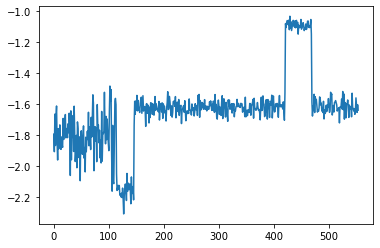

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 554, reward = -1.610101


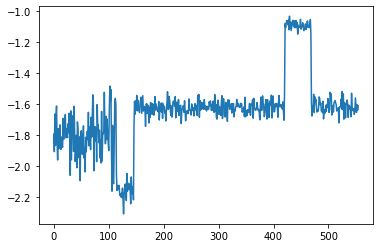

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 555, reward = -1.670176


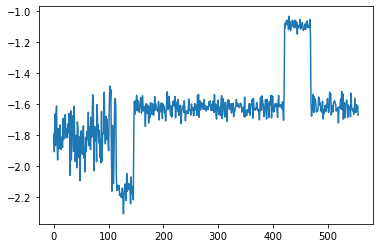

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 556, reward = -1.553913


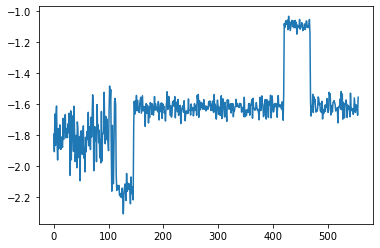

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 557, reward = -1.630616


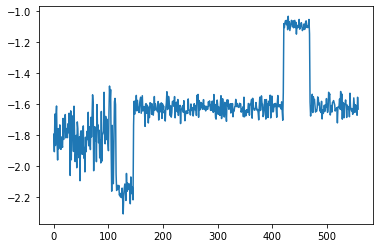

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 558, reward = -1.665895


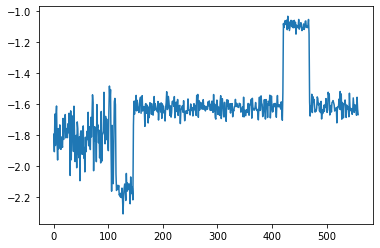

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 559, reward = -1.667225


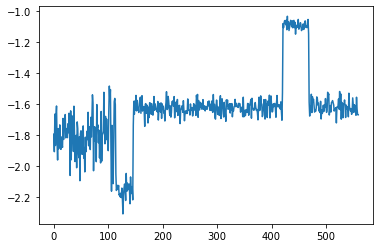

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 560, reward = -1.590875


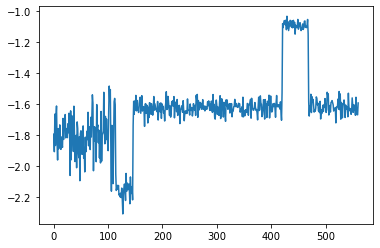

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 561, reward = -1.616405


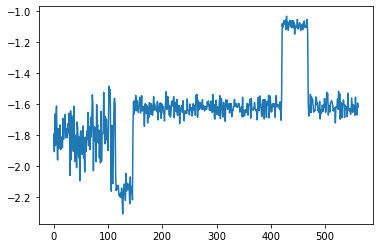

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 562, reward = -1.568231


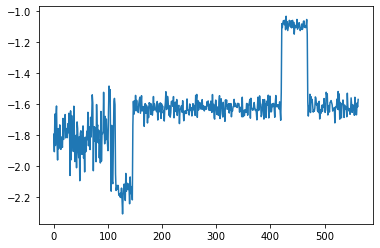

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 563, reward = -1.656387


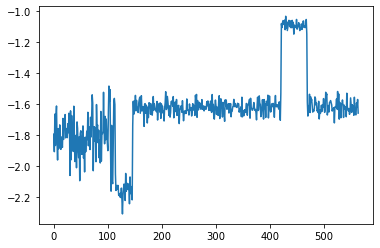

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 564, reward = -1.553934


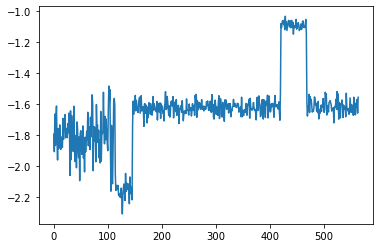

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 565, reward = -1.611888


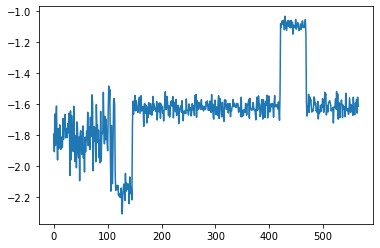

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 566, reward = -1.596420


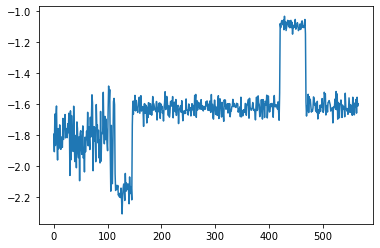

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 567, reward = -1.637941


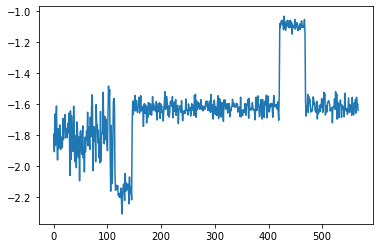

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 568, reward = -1.585007


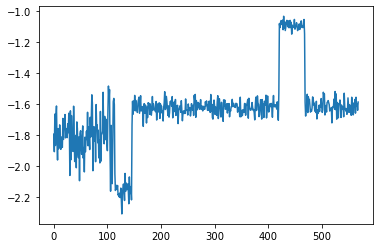

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 569, reward = -1.650978


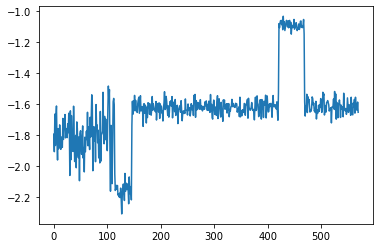

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 570, reward = -1.614143


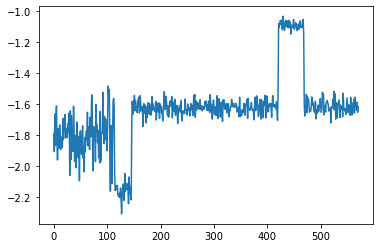

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 571, reward = -1.619254


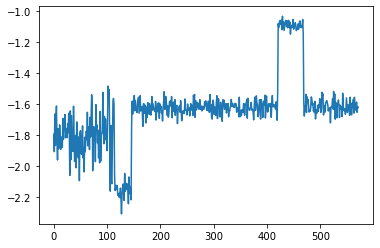

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 572, reward = -1.648818


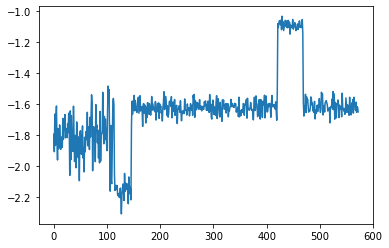

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 573, reward = -1.613088


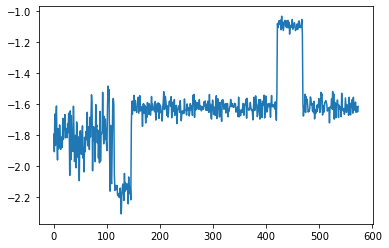

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 574, reward = -1.608669


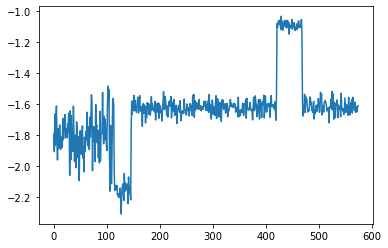

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 575, reward = -1.671357


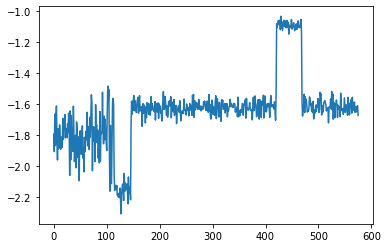

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 576, reward = -1.667475


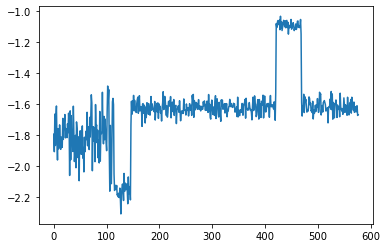

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 577, reward = -1.602696


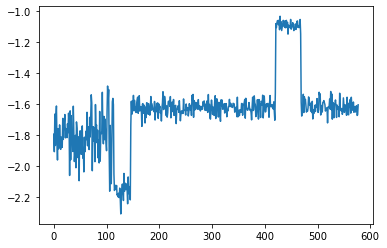

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 578, reward = -1.678174


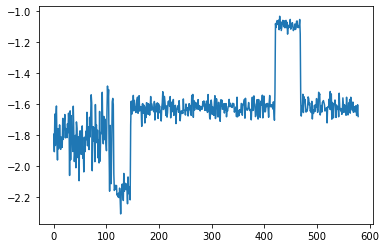

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 579, reward = -1.603287


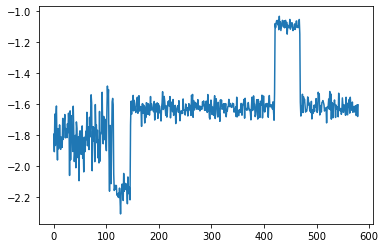

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 580, reward = -1.577986


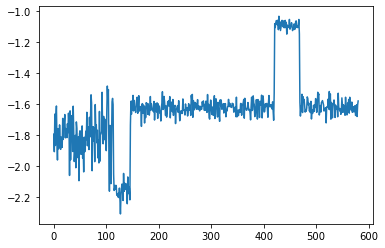

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 581, reward = -1.616349


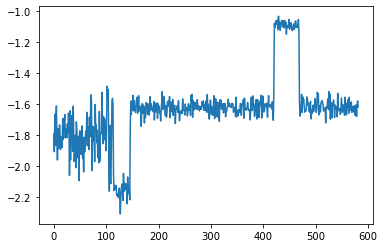

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 582, reward = -1.651624


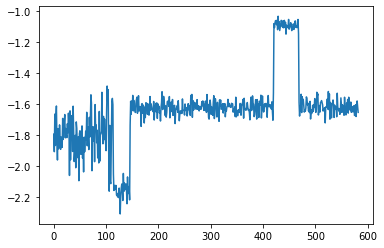

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 583, reward = -1.626981


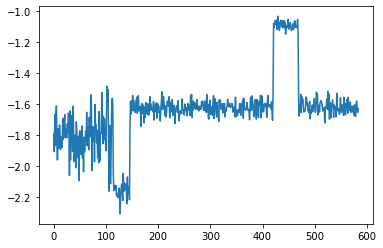

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 584, reward = -1.632386


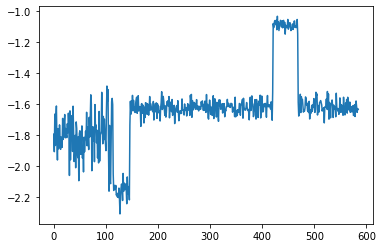

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 585, reward = -1.614349


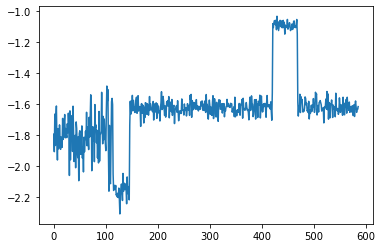

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 586, reward = -1.604511


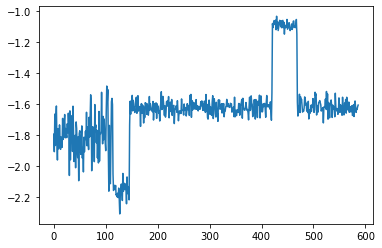

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 587, reward = -1.619617


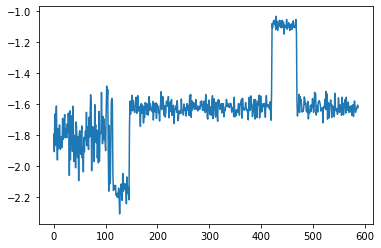

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 588, reward = -1.643403


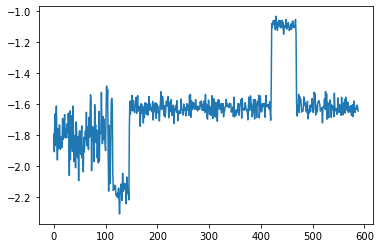

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 589, reward = -1.595350


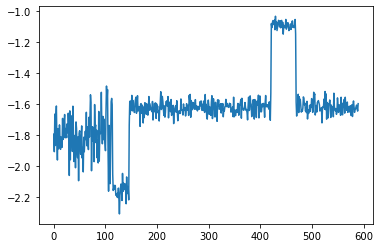

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 590, reward = -1.643076


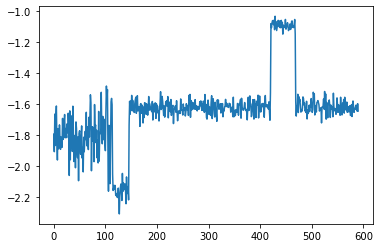

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 591, reward = -1.715171


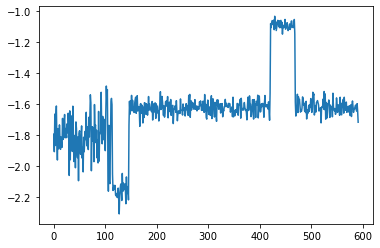

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 592, reward = -1.558245


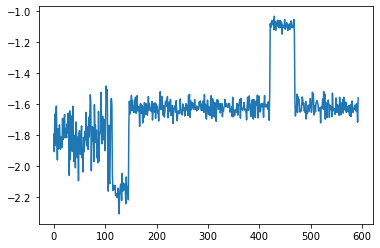

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 593, reward = -1.540478


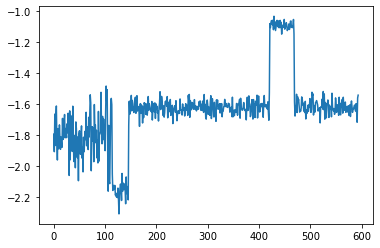

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 594, reward = -1.623784


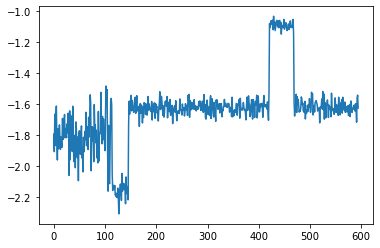

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 595, reward = -1.602071


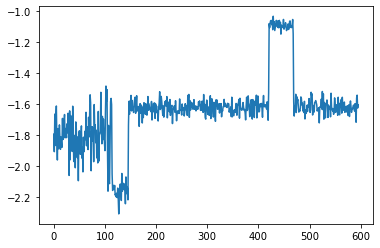

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 596, reward = -1.602160


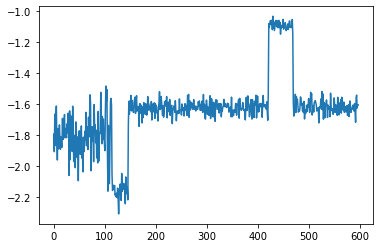

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 597, reward = -1.646584


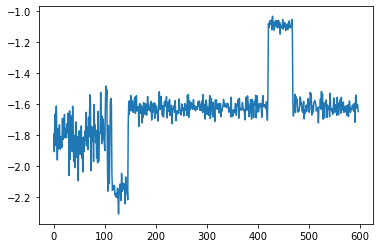

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 598, reward = -1.582149


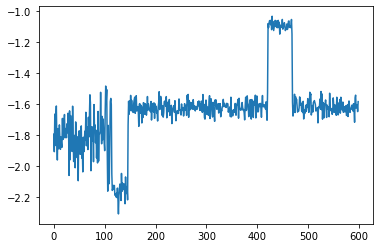

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 599, reward = -1.612588


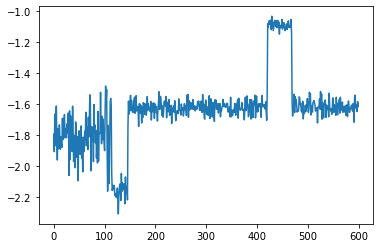

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 600, reward = -1.570487


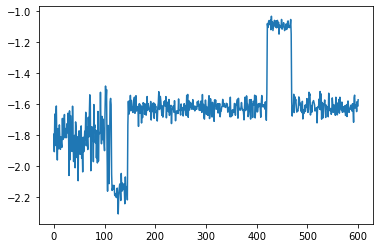

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 601, reward = -1.613424


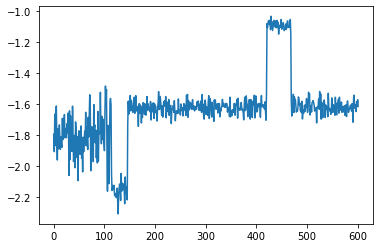

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 602, reward = -1.609602


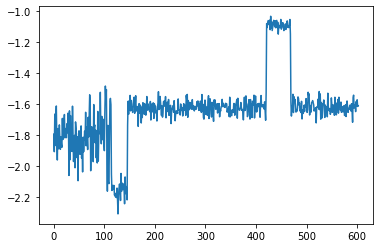

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 603, reward = -1.666991


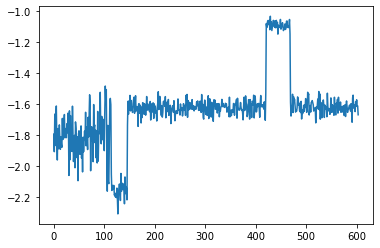

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 604, reward = -1.735452


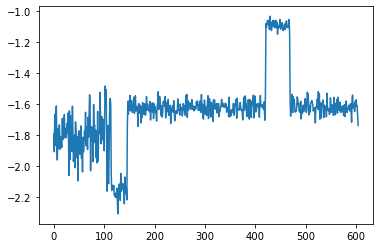

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 605, reward = -1.607636


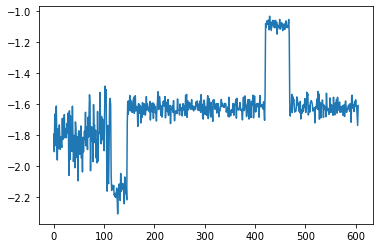

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 606, reward = -1.647818


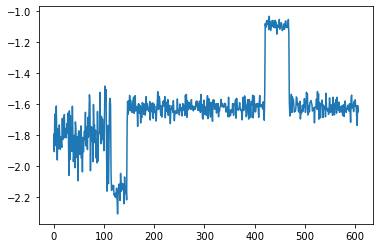

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 607, reward = -1.644416


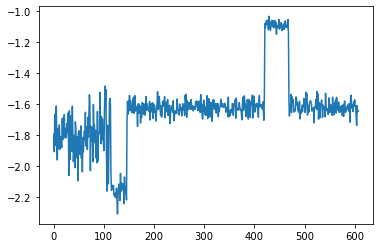

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 608, reward = -1.580073


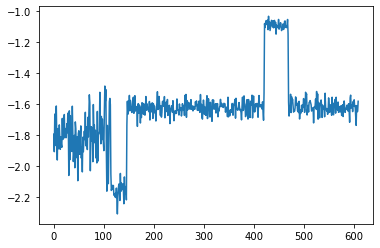

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 609, reward = -1.617475


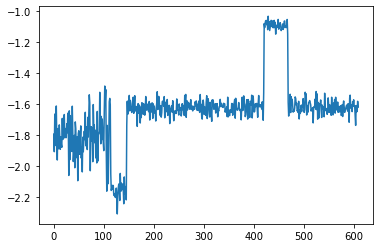

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 610, reward = -1.550863


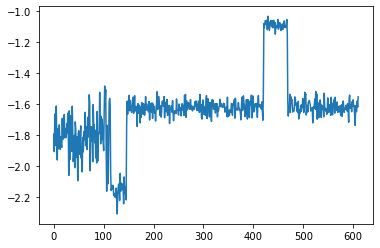

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 611, reward = -1.575023


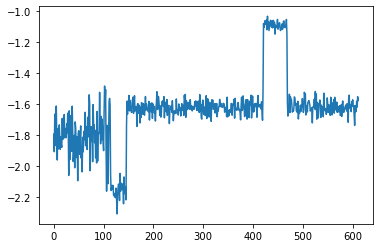

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 612, reward = -1.655216


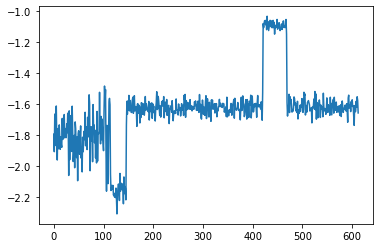

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 613, reward = -1.587729


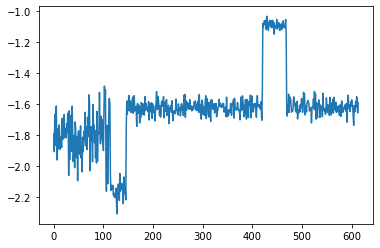

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 614, reward = -1.723859


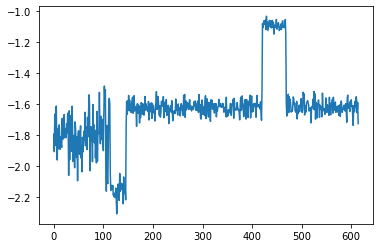

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 615, reward = -1.629504


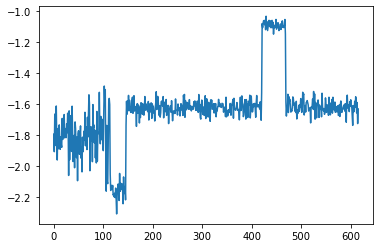

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 616, reward = -1.594931


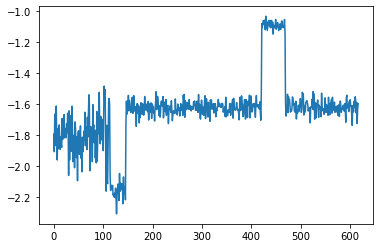

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 617, reward = -1.607071


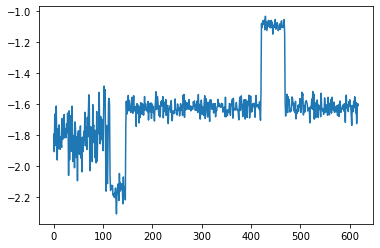

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 618, reward = -1.669669


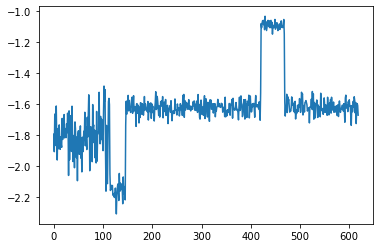

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 619, reward = -1.636974


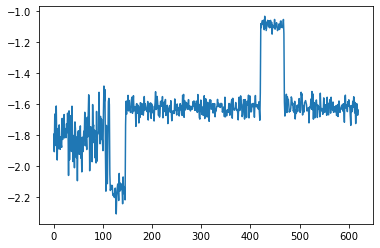

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 620, reward = -1.620541


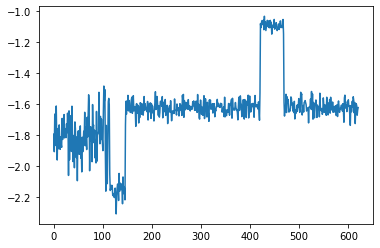

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 621, reward = -1.589291


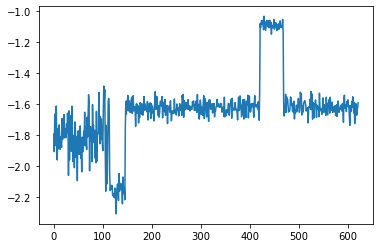

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 622, reward = -1.585198


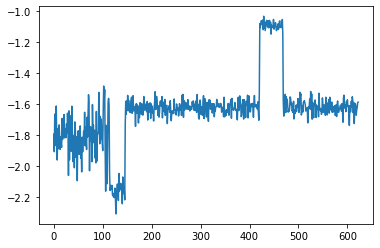

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 623, reward = -1.596356


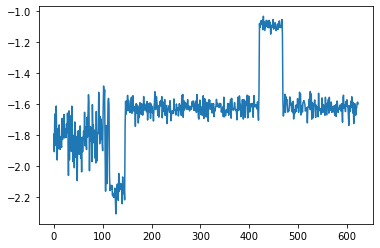

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 624, reward = -1.612245


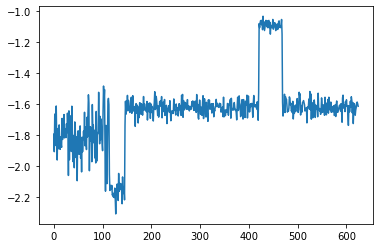

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 625, reward = -1.676592


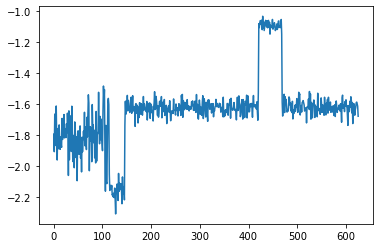

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 626, reward = -1.552592


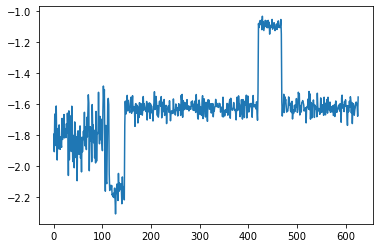

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 627, reward = -1.612917


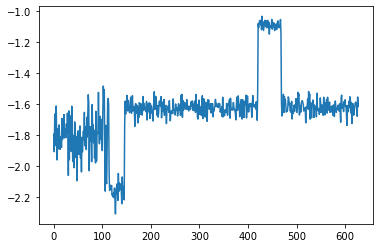

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 628, reward = -1.573790


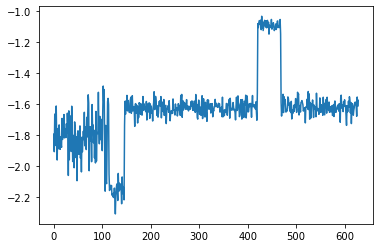

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 629, reward = -1.661097


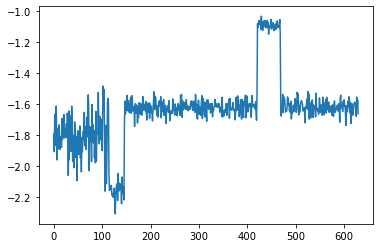

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 630, reward = -1.647313


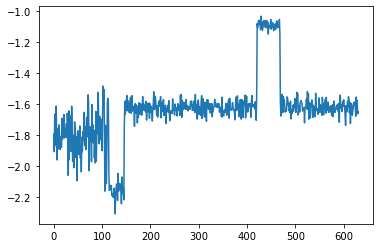

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 631, reward = -1.591047


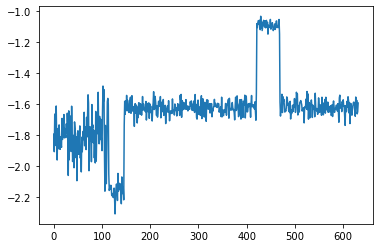

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 632, reward = -1.591554


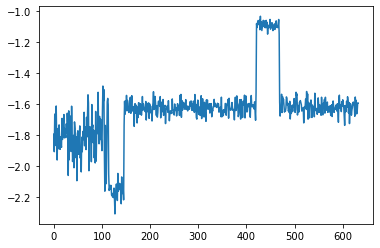

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 633, reward = -1.588119


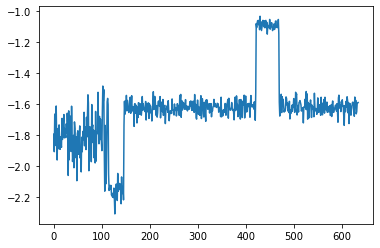

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 634, reward = -1.633948


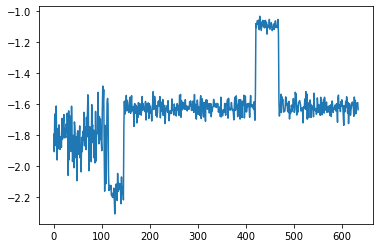

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 635, reward = -1.567718


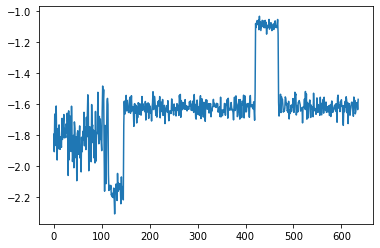

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 636, reward = -1.641572


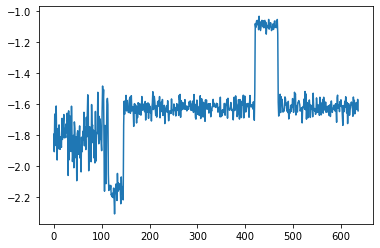

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 637, reward = -1.675548


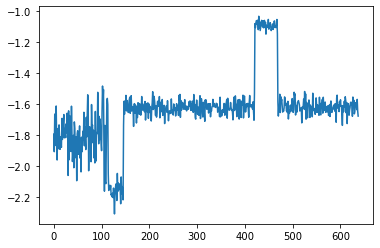

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 638, reward = -1.552379


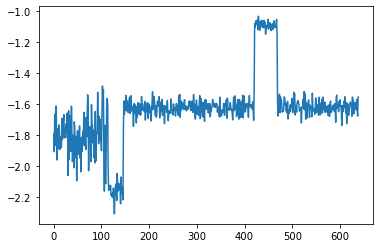

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 639, reward = -1.673630


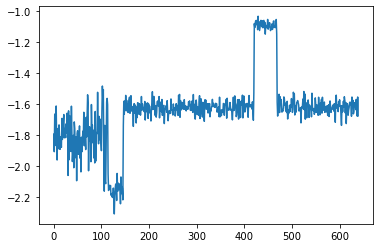

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 640, reward = -1.582061


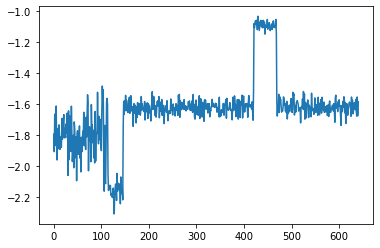

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 641, reward = -1.629693


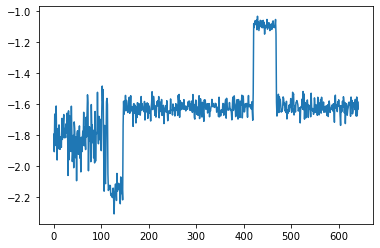

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 642, reward = -1.608106


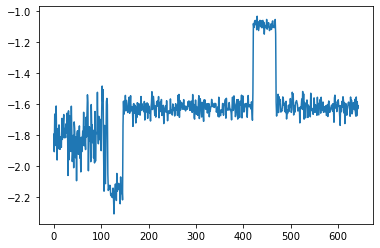

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 643, reward = -1.608818


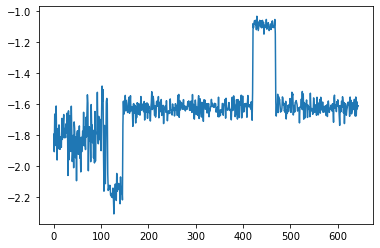

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 644, reward = -1.616193


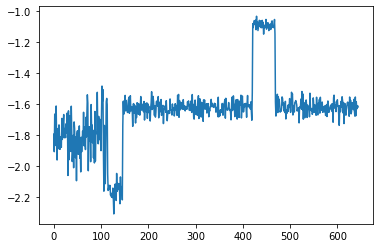

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 645, reward = -1.568661


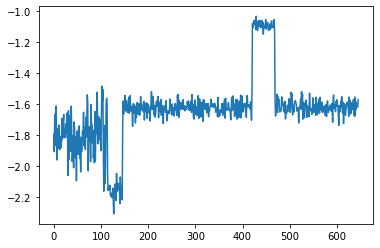

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 646, reward = -1.631396


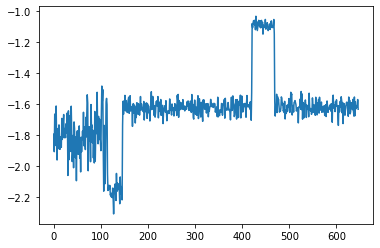

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 647, reward = -1.586899


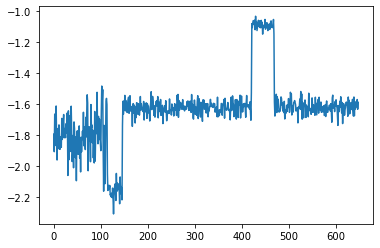

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 648, reward = -1.607410


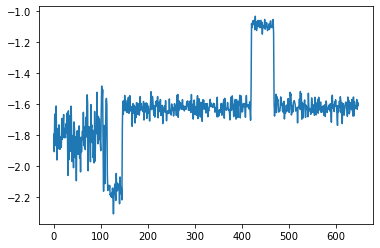

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 649, reward = -1.649468


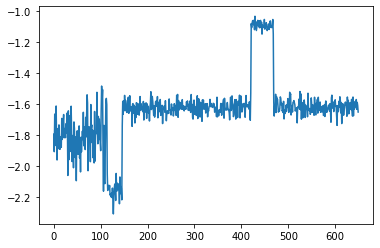

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 650, reward = -1.613862


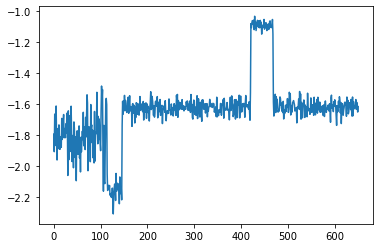

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 651, reward = -1.643309


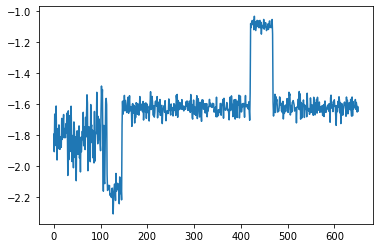

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 652, reward = -1.650045


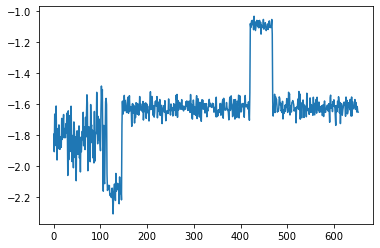

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 653, reward = -1.613590


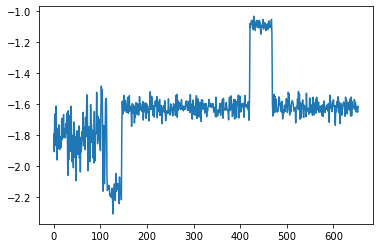

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 654, reward = -1.539330


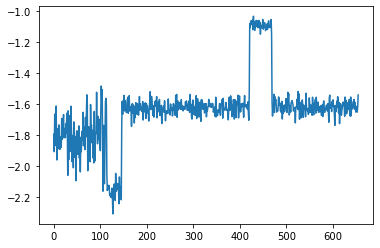

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 655, reward = -1.647763


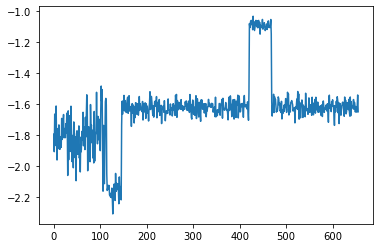

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 656, reward = -1.646176


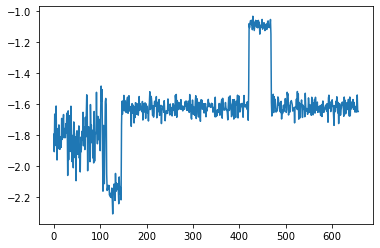

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 657, reward = -1.621397


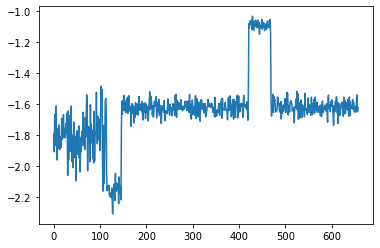

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 658, reward = -1.605569


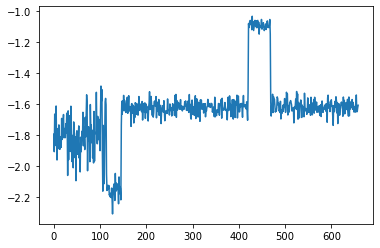

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 659, reward = -1.601609


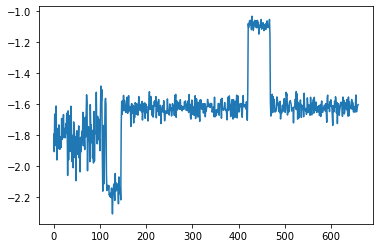

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 660, reward = -1.682251


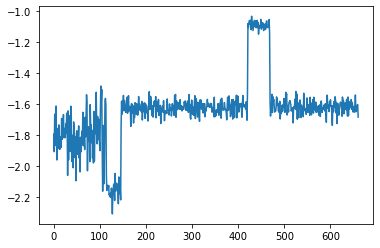

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 661, reward = -1.633399


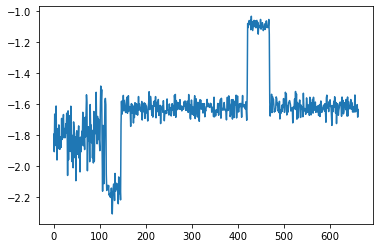

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 662, reward = -1.541587


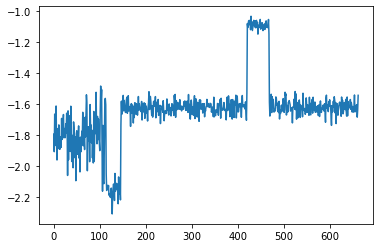

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 663, reward = -1.640234


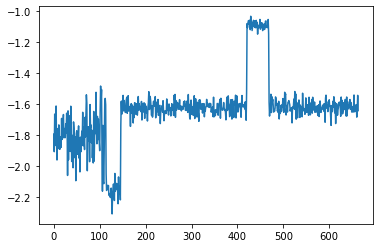

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 664, reward = -1.567355


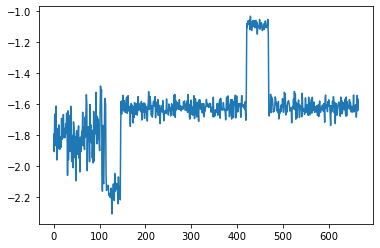

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 665, reward = -1.587397


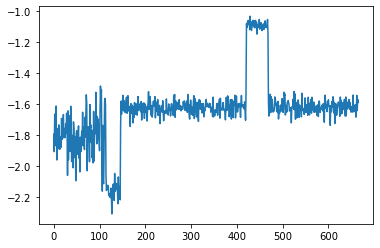

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 666, reward = -1.632096


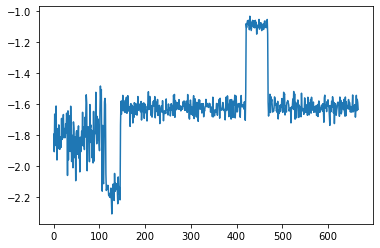

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 667, reward = -1.593991


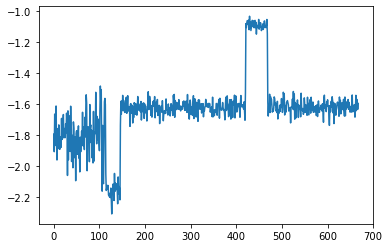

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 668, reward = -1.589524


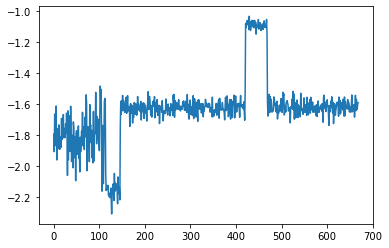

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 669, reward = -1.602275


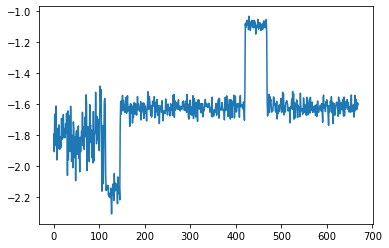

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 670, reward = -1.688913


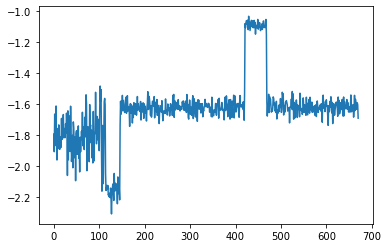

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 671, reward = -1.613813


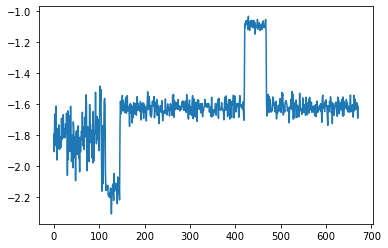

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 672, reward = -1.689584


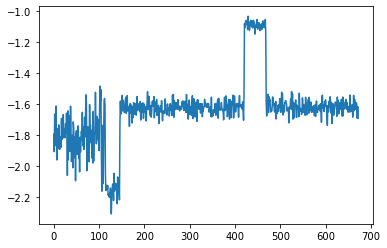

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 673, reward = -1.629695


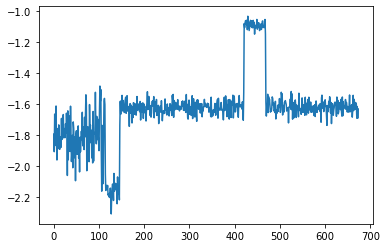

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 674, reward = -1.611960


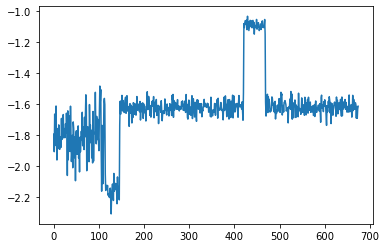

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 675, reward = -1.644431


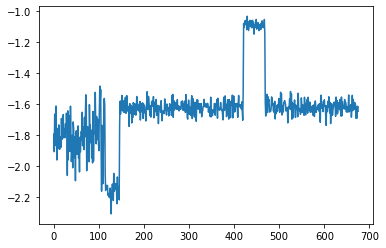

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 676, reward = -1.663862


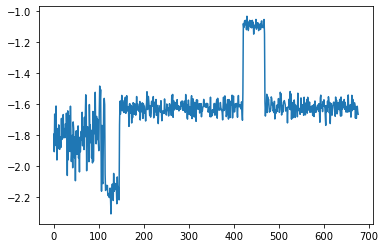

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 677, reward = -1.571097


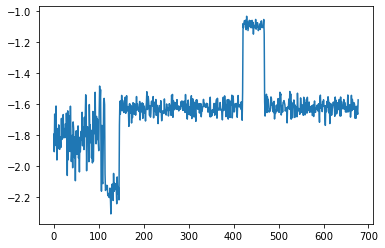

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 678, reward = -1.604205


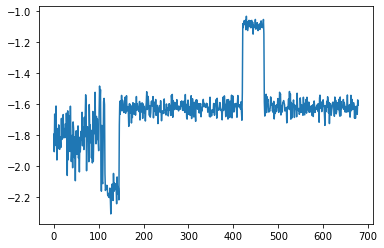

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 679, reward = -1.679098


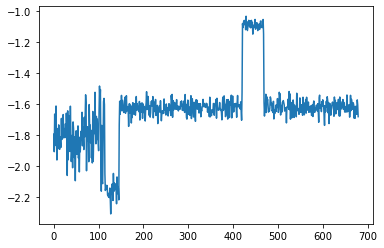

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 680, reward = -1.590732


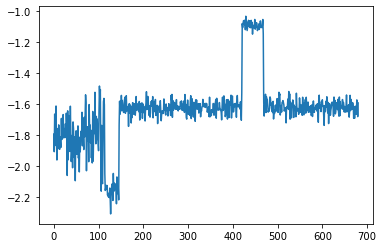

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 681, reward = -1.596742


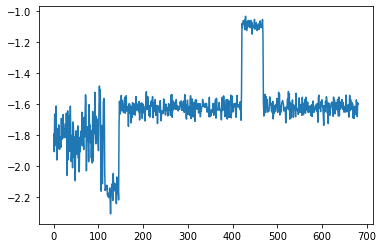

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 682, reward = -1.587302


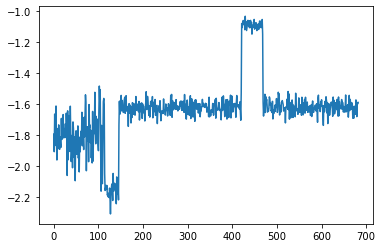

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 683, reward = -1.594826


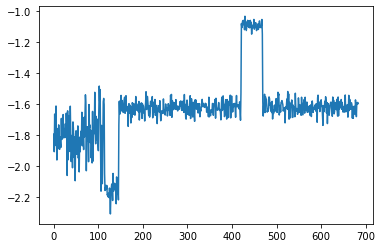

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 684, reward = -1.685970


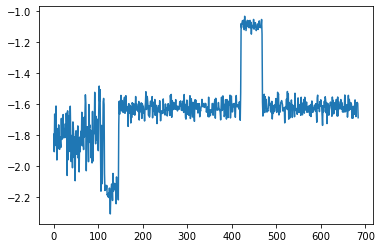

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 685, reward = -1.604855


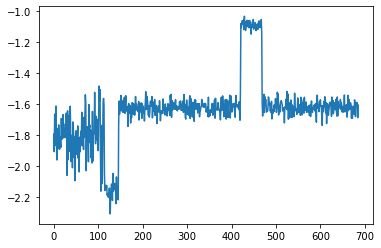

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 686, reward = -1.646726


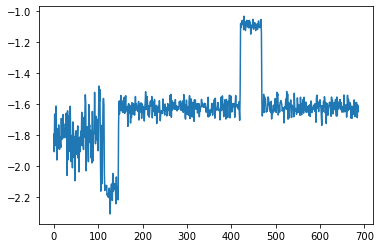

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 687, reward = -1.569245


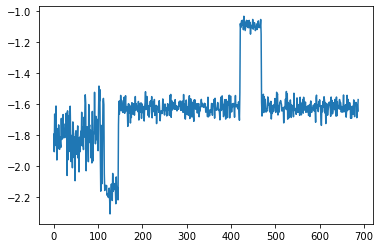

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 688, reward = -1.609456


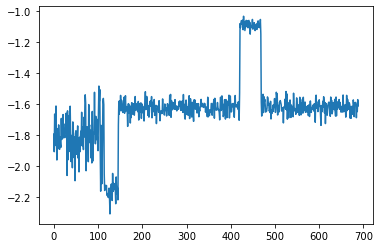

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 689, reward = -1.592735


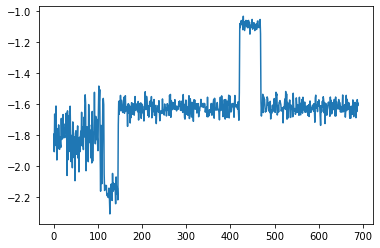

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 690, reward = -1.607278


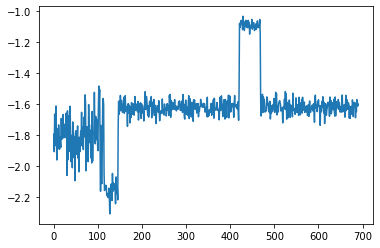

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 691, reward = -1.582047


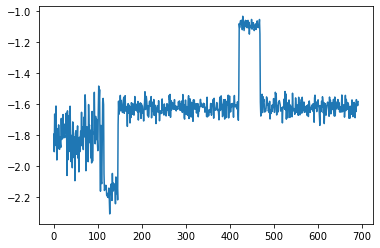

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 692, reward = -1.657390


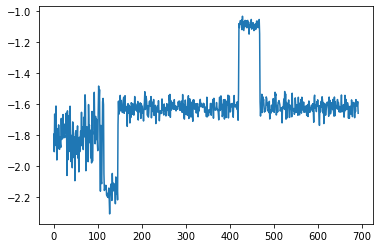

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 693, reward = -1.598153


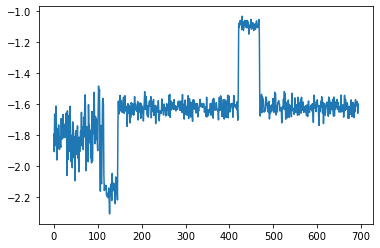

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 694, reward = -1.673007


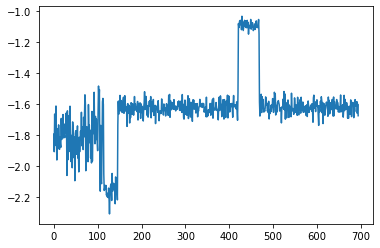

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 695, reward = -1.660444


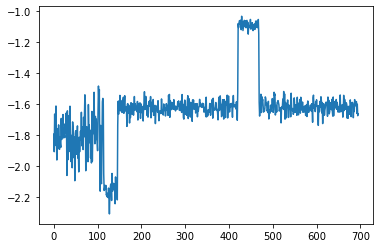

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 696, reward = -1.645483


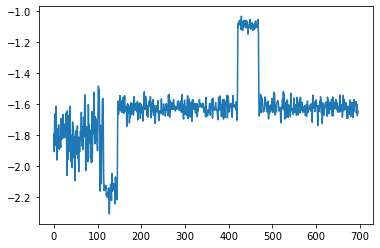

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 697, reward = -1.595644


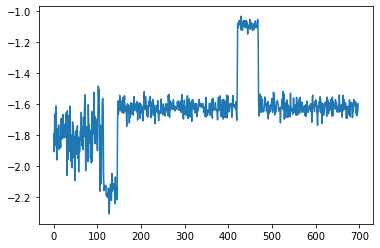

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 698, reward = -1.597955


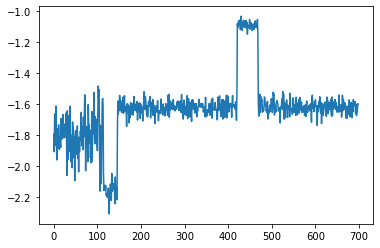

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 699, reward = -1.640495


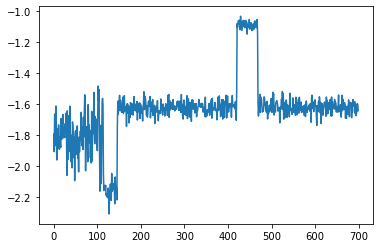

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 700, reward = -1.595036


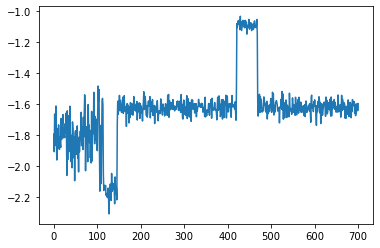

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 701, reward = -1.544409


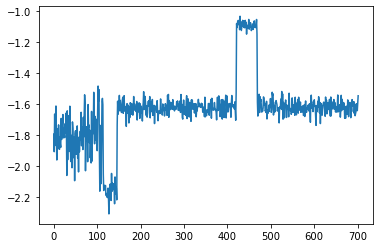

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 702, reward = -1.584350


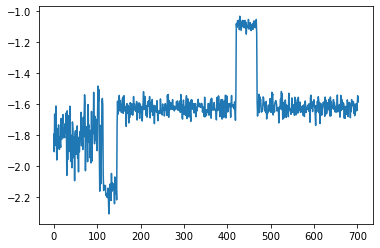

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 703, reward = -1.592253


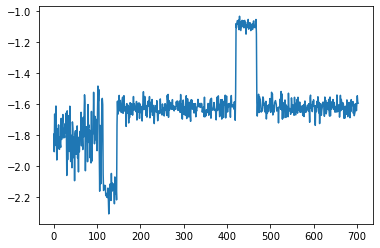

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 704, reward = -1.621022


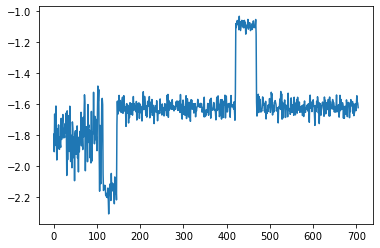

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 705, reward = -1.577258


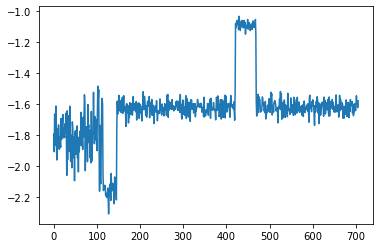

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 706, reward = -1.584997


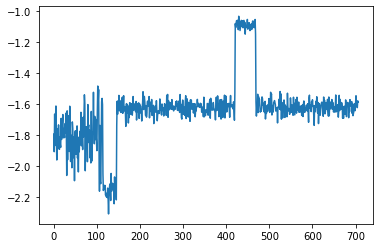

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 707, reward = -1.632892


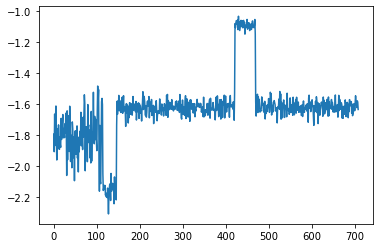

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 708, reward = -1.603297


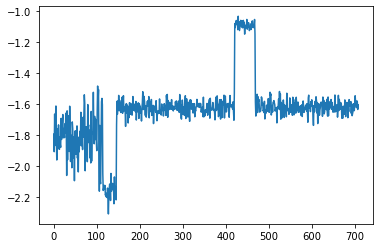

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 709, reward = -1.637617


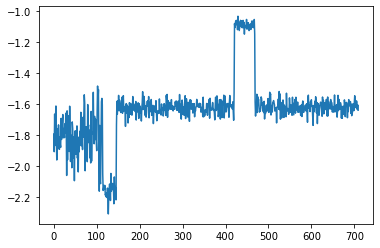

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 710, reward = -1.572864


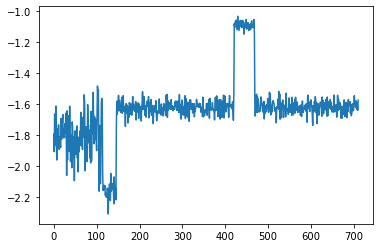

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 711, reward = -1.581715


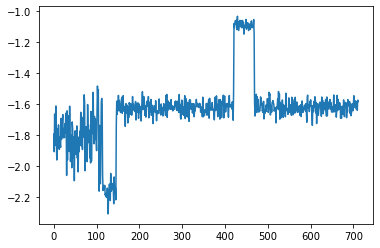

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 712, reward = -1.610090


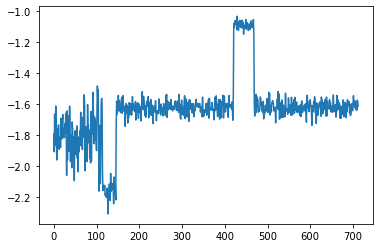

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 713, reward = -1.667761


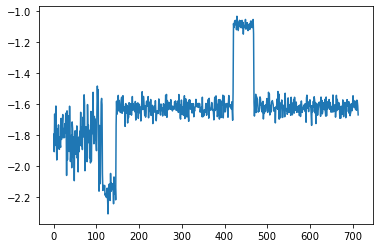

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 714, reward = -1.658212


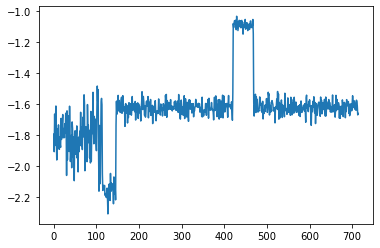

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 715, reward = -1.598725


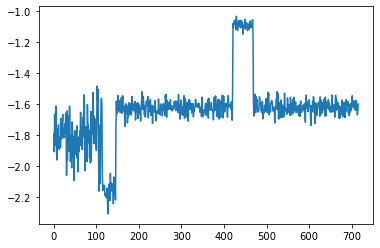

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 716, reward = -1.663032


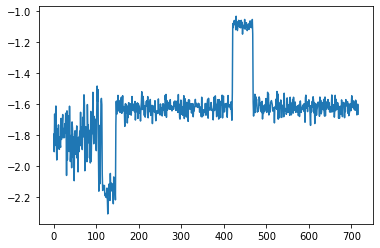

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 717, reward = -1.638170


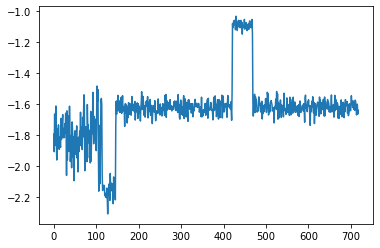

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 718, reward = -1.644478


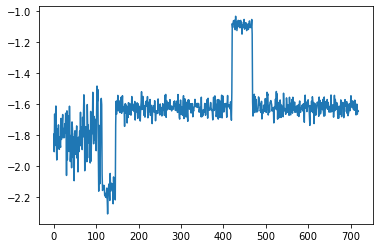

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 719, reward = -1.639652


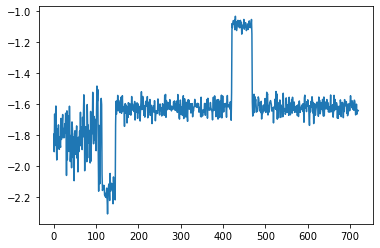

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 720, reward = -1.677375


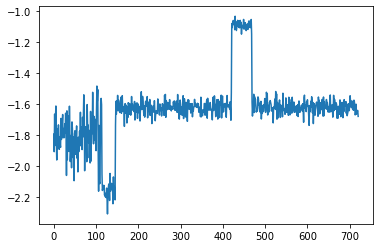

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 721, reward = -1.673619


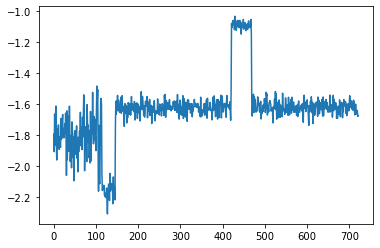

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 722, reward = -1.581639


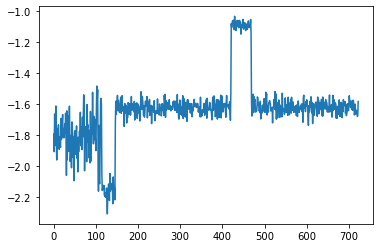

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 723, reward = -1.636345


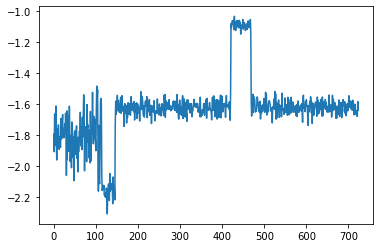

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 724, reward = -1.608569


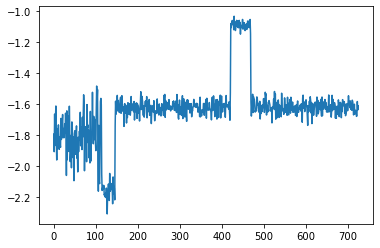

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 725, reward = -1.621763


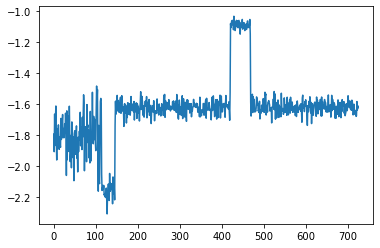

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 726, reward = -1.680667


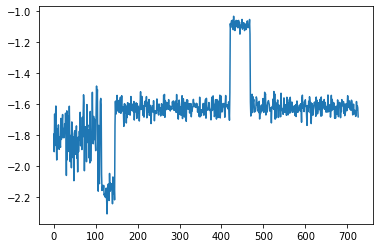

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 727, reward = -1.666462


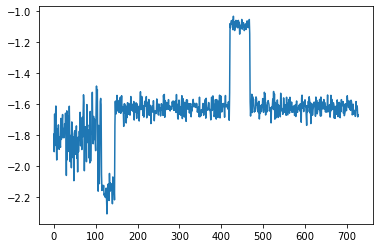

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 728, reward = -1.672834


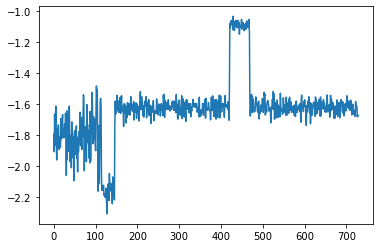

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 729, reward = -1.545385


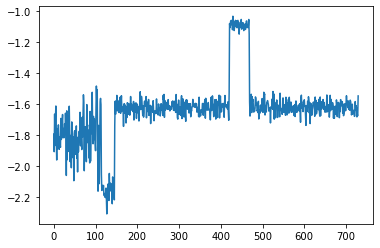

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 730, reward = -1.607883


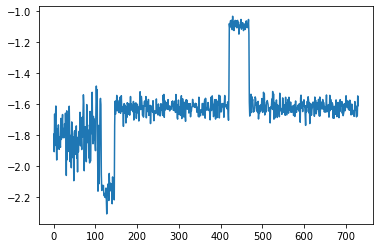

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 731, reward = -1.630318


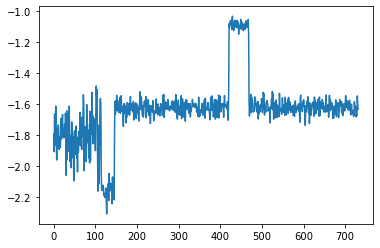

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 732, reward = -1.584465


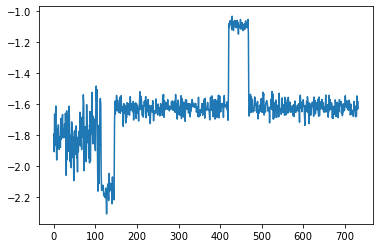

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 733, reward = -1.630099


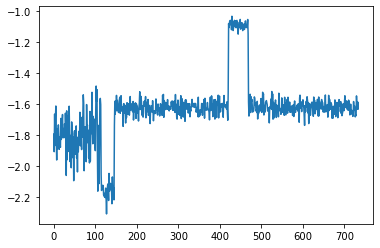

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 734, reward = -1.622347


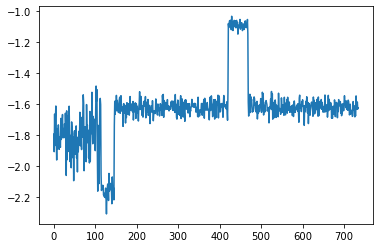

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 735, reward = -1.603371


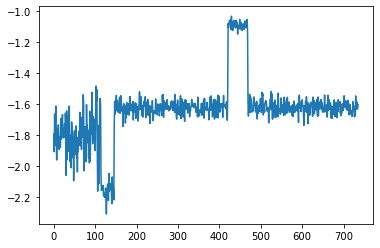

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 736, reward = -1.643166


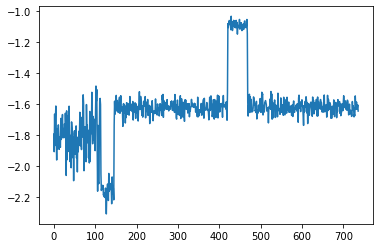

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 737, reward = -1.619392


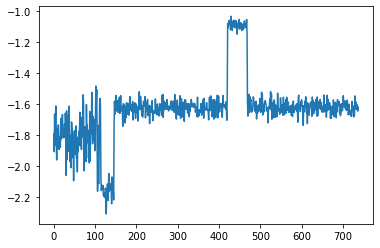

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 738, reward = -1.590887


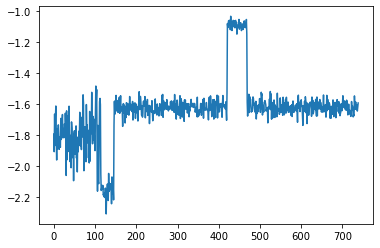

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 739, reward = -1.573246


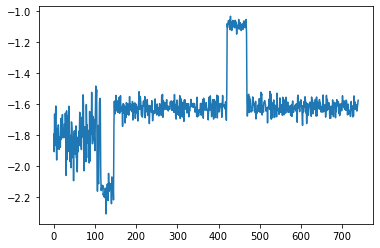

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 740, reward = -1.712089


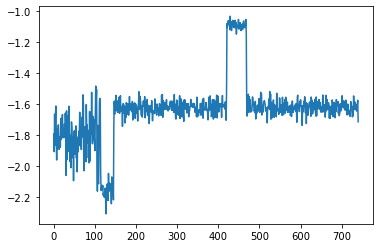

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 741, reward = -1.607135


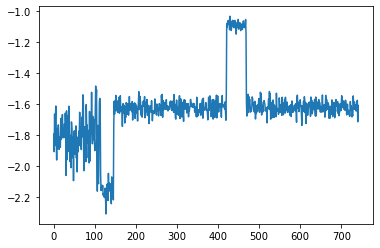

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 742, reward = -1.624845


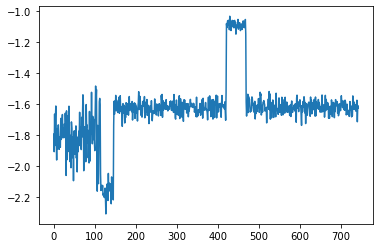

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 743, reward = -1.655939


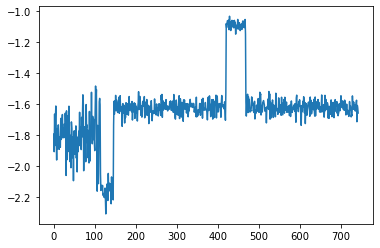

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 744, reward = -1.635185


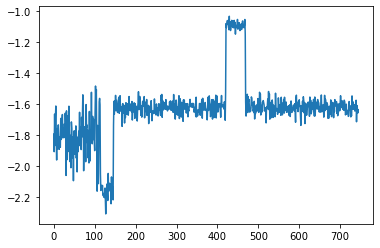

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 745, reward = -1.574501


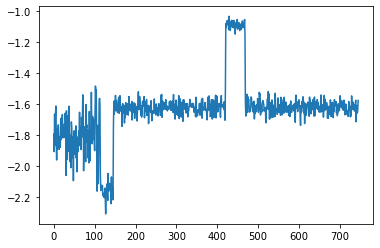

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 746, reward = -1.600338


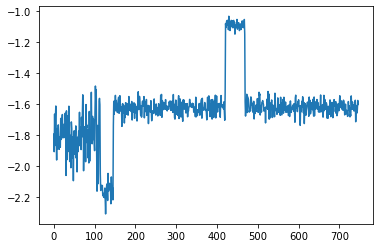

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 747, reward = -1.617894


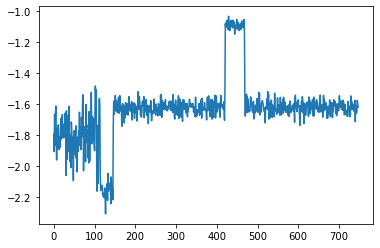

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 748, reward = -1.645051


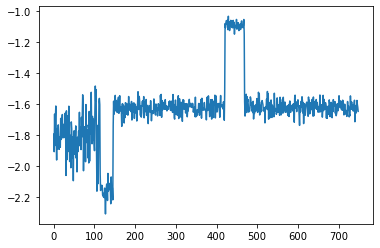

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 749, reward = -1.554971


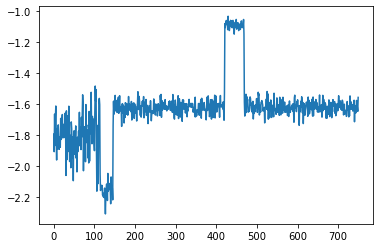

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 750, reward = -1.590892


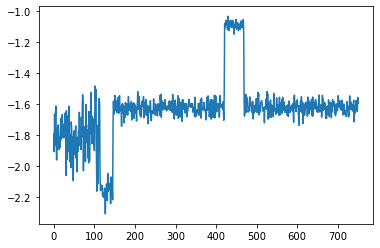

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 751, reward = -1.569480


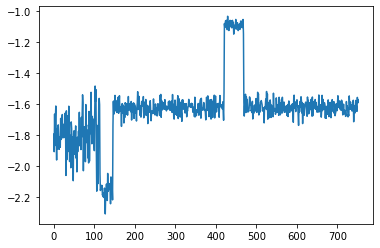

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 752, reward = -1.615268


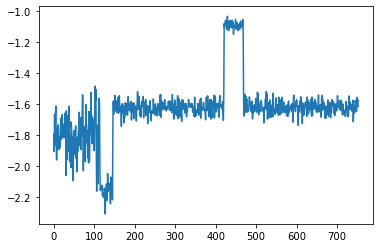

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 753, reward = -1.675422


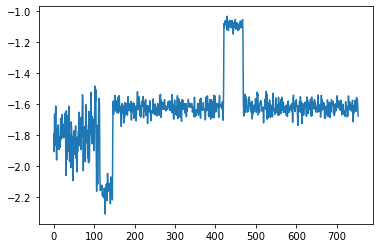

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 754, reward = -1.573640


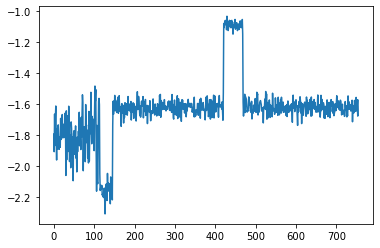

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 755, reward = -1.652699


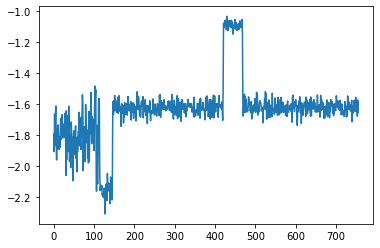

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 756, reward = -1.597763


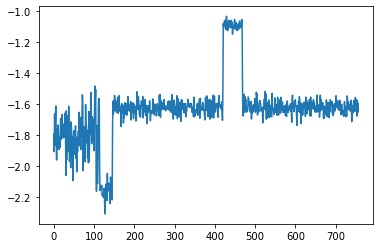

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 757, reward = -1.633257


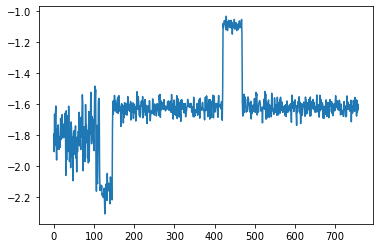

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 758, reward = -1.620115


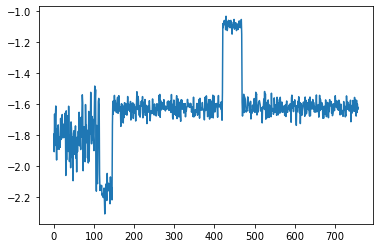

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 759, reward = -1.658983


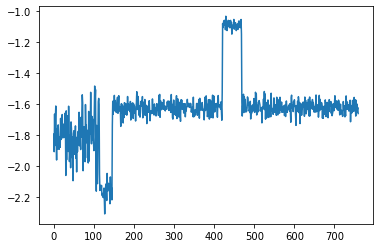

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 760, reward = -1.591756


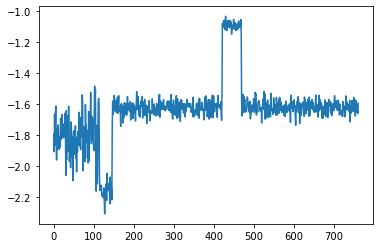

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 761, reward = -1.667627


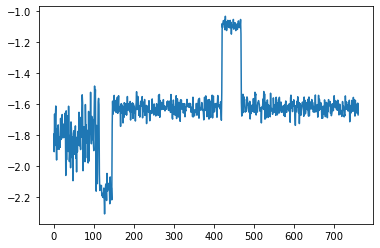

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 762, reward = -1.606585


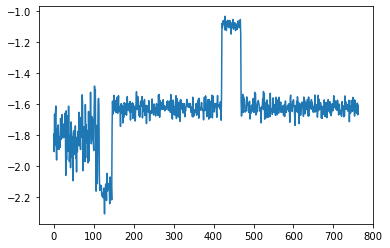

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 763, reward = -1.677891


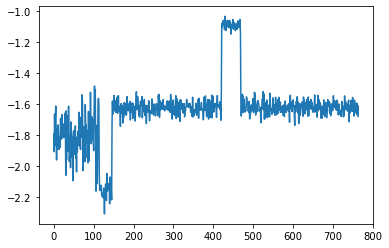

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 764, reward = -1.655768


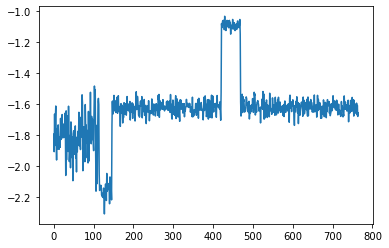

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 765, reward = -1.611827


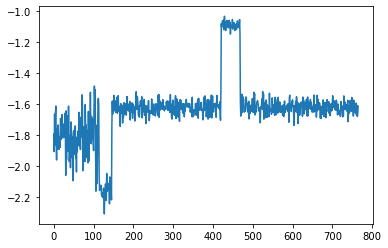

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 766, reward = -1.656931


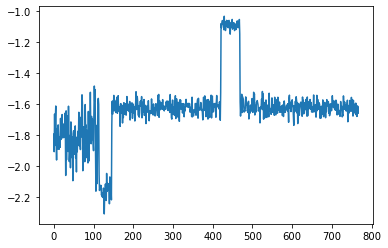

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 767, reward = -1.581073


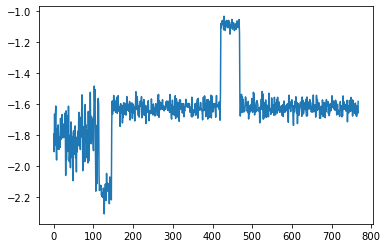

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 768, reward = -1.702736


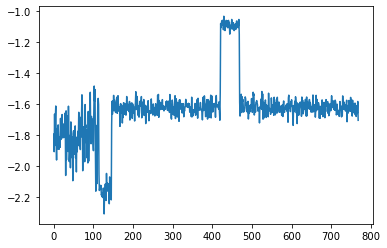

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 769, reward = -1.617769


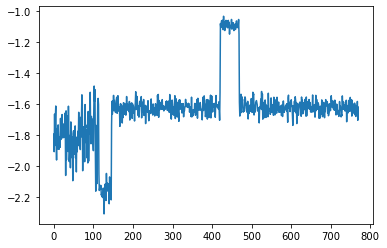

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 770, reward = -1.622625


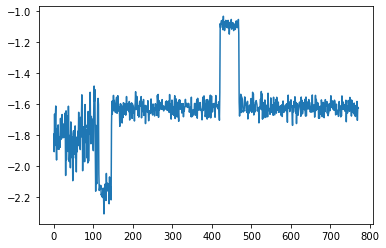

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 771, reward = -1.492236


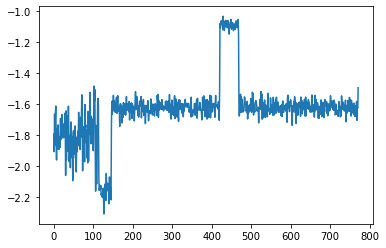

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 772, reward = -1.636314


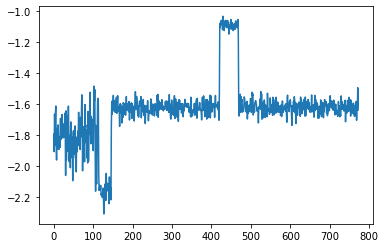

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 773, reward = -1.615623


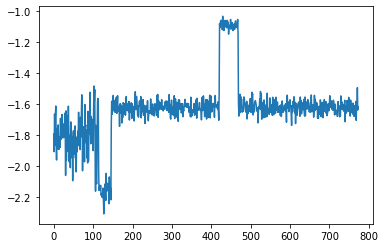

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 774, reward = -1.702680


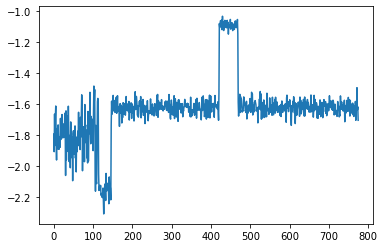

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 775, reward = -1.617398


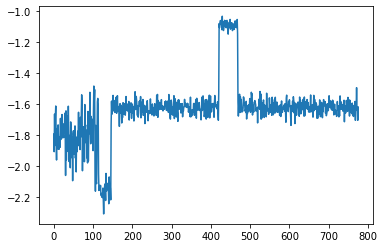

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 776, reward = -1.610943


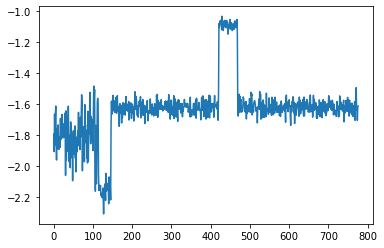

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 777, reward = -1.645417


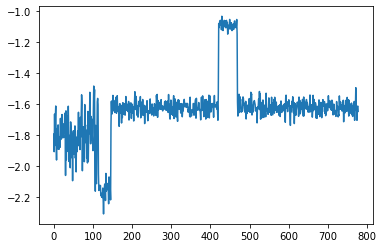

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 778, reward = -1.593257


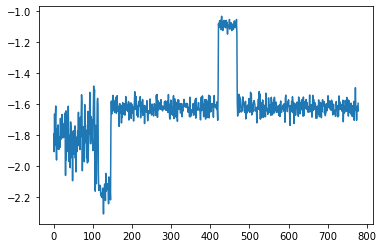

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 779, reward = -1.655328


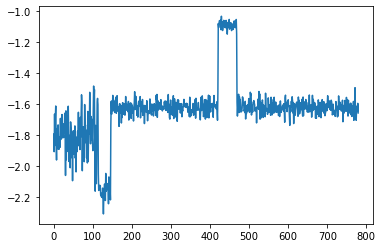

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 780, reward = -1.634570


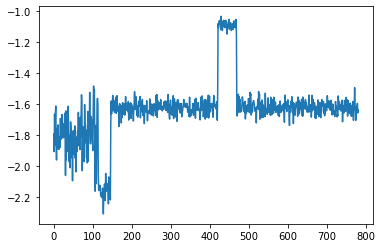

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 781, reward = -1.718501


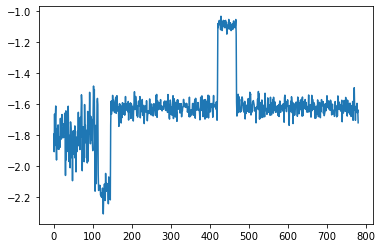

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 782, reward = -1.588413


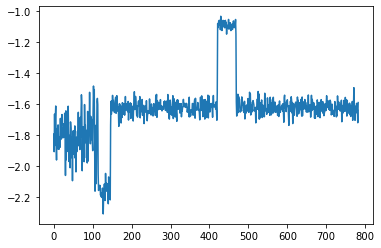

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 783, reward = -1.648364


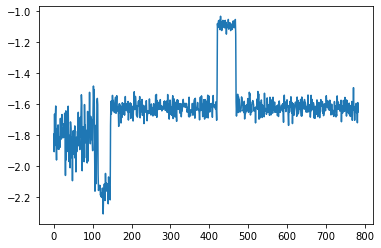

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 784, reward = -1.562593


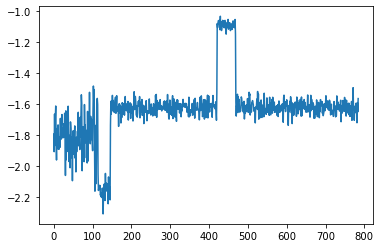

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 785, reward = -1.657418


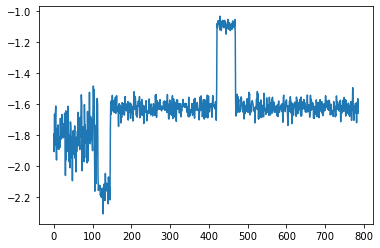

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 786, reward = -1.631914


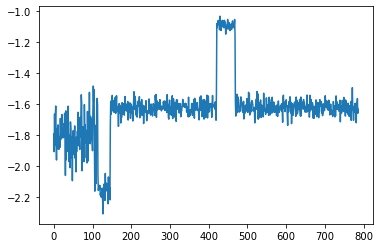

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 787, reward = -1.665547


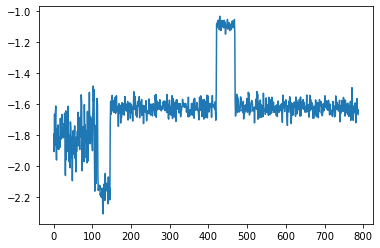

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 788, reward = -1.704633


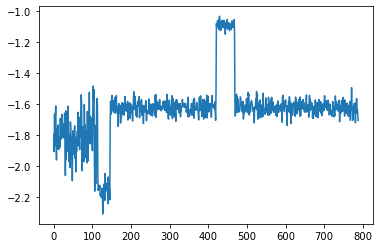

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 789, reward = -1.586747


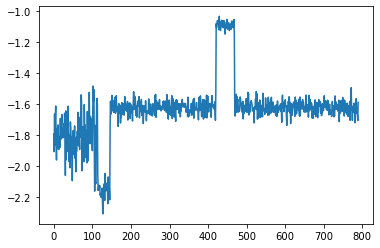

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 790, reward = -1.640470


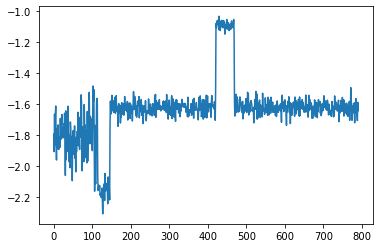

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 791, reward = -1.632257


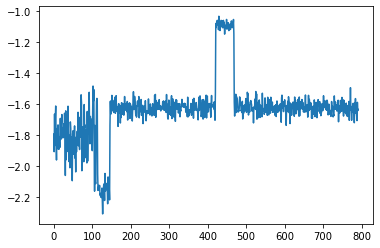

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 792, reward = -1.542316


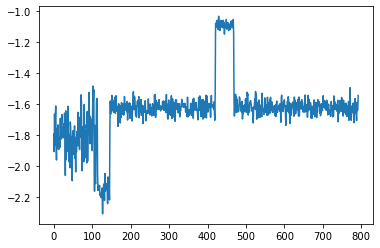

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 793, reward = -1.591866


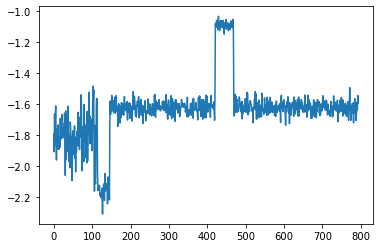

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 794, reward = -1.650309


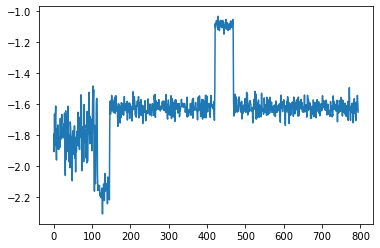

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 795, reward = -1.653390


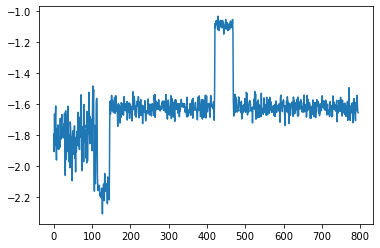

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 796, reward = -1.548194


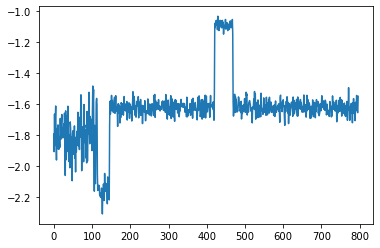

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 797, reward = -1.641280


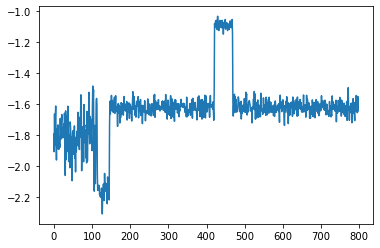

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 798, reward = -1.678095


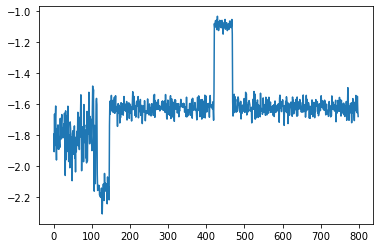

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 799, reward = -1.528556


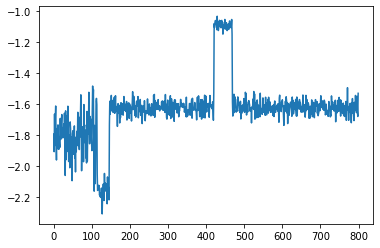

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 800, reward = -1.653198


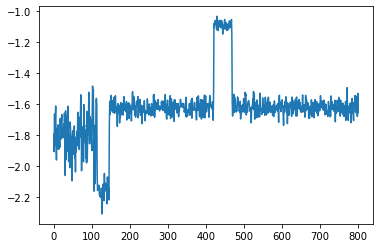

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 801, reward = -1.641251


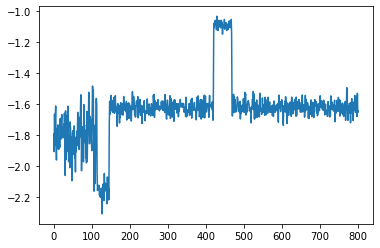

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 802, reward = -1.602822


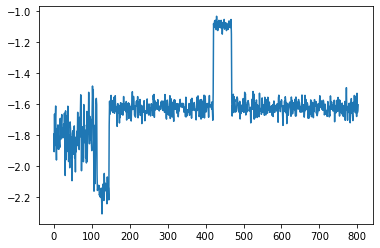

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 803, reward = -1.641674


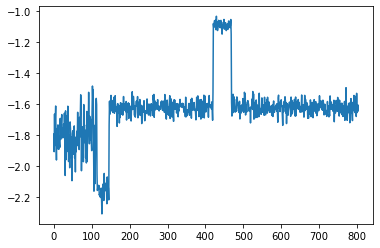

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 804, reward = -1.634846


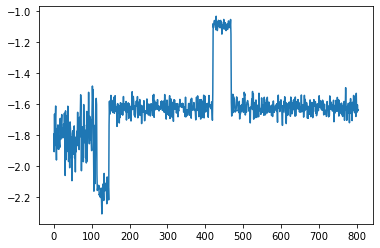

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 805, reward = -1.537683


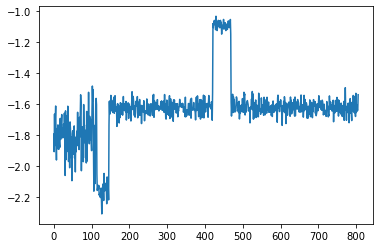

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 806, reward = -1.662825


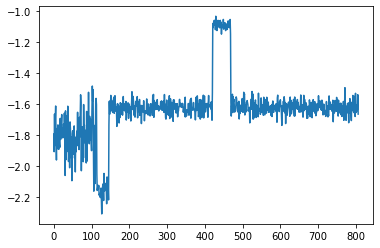

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 807, reward = -1.625410


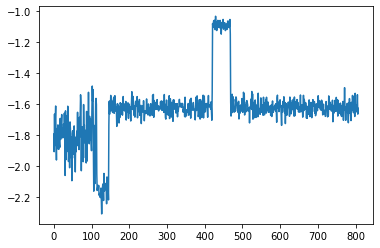

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 808, reward = -1.698794


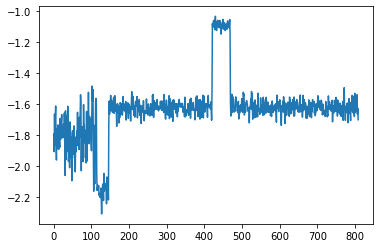

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 809, reward = -1.671432


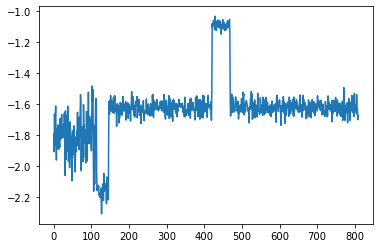

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 810, reward = -1.562403


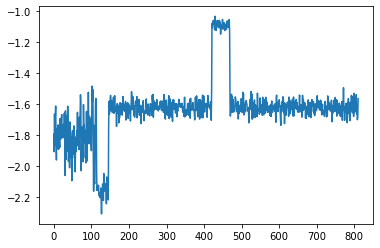

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 811, reward = -1.605799


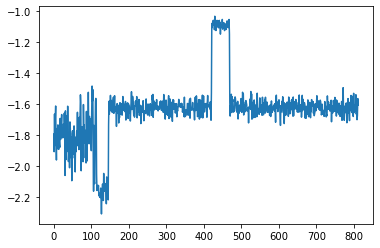

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 812, reward = -1.735437


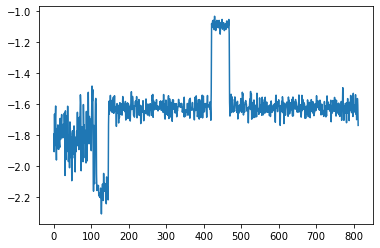

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 813, reward = -1.617645


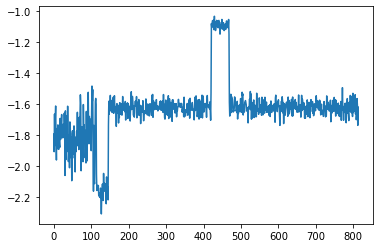

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 814, reward = -1.573673


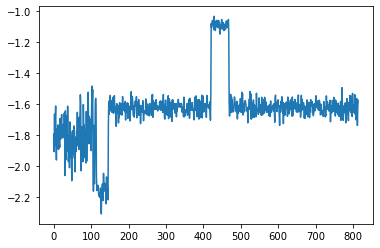

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 815, reward = -1.641128


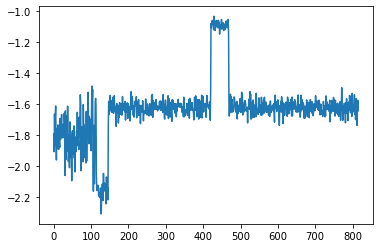

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 816, reward = -1.613183


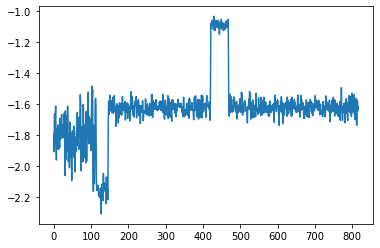

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 817, reward = -1.654728


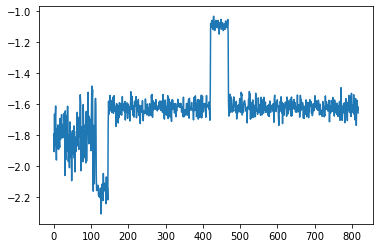

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 818, reward = -1.629235


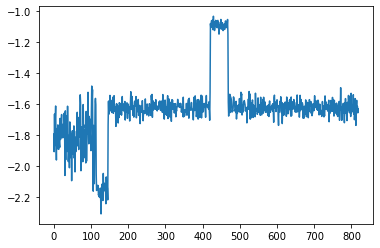

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 819, reward = -1.604395


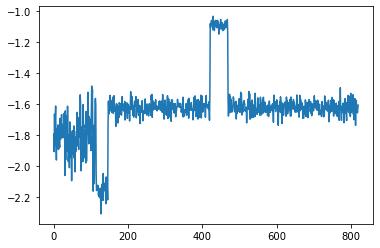

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 820, reward = -1.618309


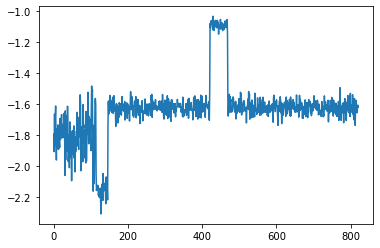

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 821, reward = -1.650164


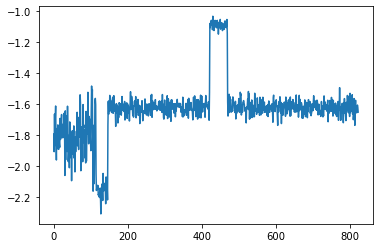

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 822, reward = -1.698549


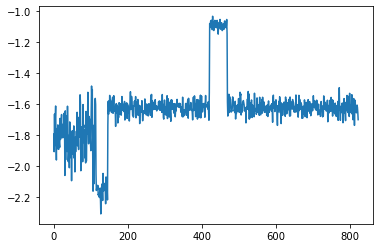

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 823, reward = -1.655034


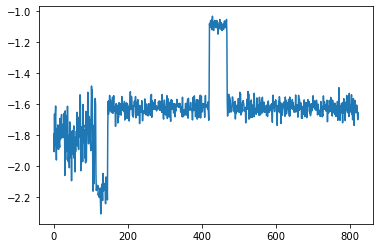

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 824, reward = -1.653417


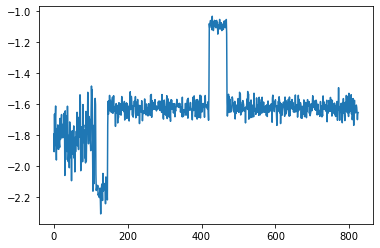

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 825, reward = -1.586198


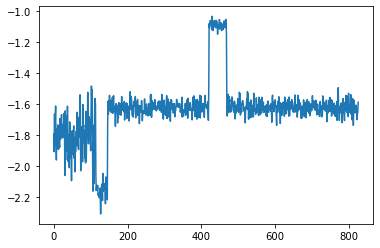

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 826, reward = -1.570457


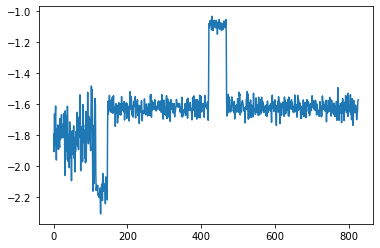

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 827, reward = -1.588624


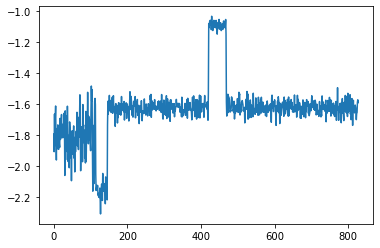

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 828, reward = -1.641056


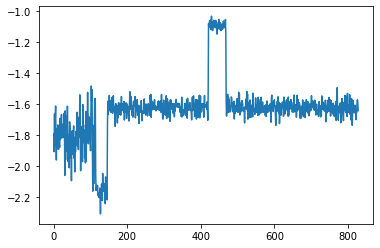

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 829, reward = -1.634442


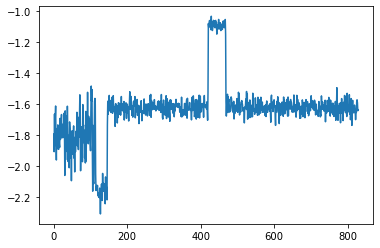

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 830, reward = -1.564540


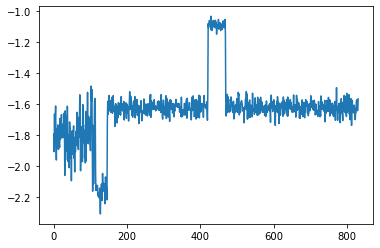

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 831, reward = -1.557934


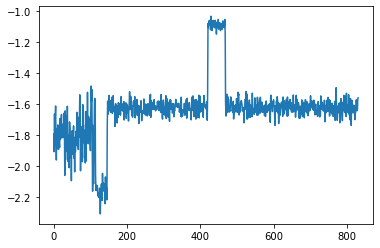

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 832, reward = -1.625877


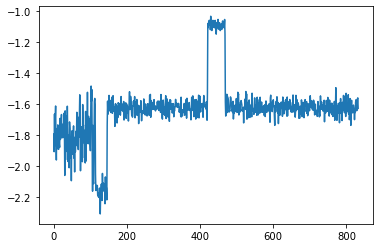

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 833, reward = -1.611214


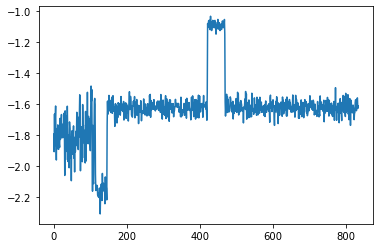

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 834, reward = -1.623223


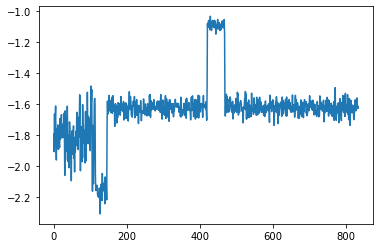

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 835, reward = -1.650998


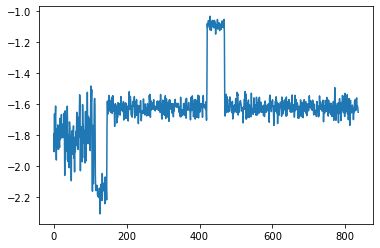

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 836, reward = -1.649317


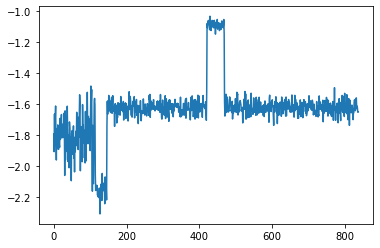

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 837, reward = -1.655120


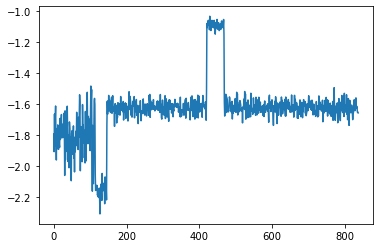

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 838, reward = -1.623030


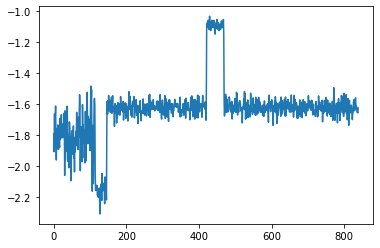

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 839, reward = -1.640884


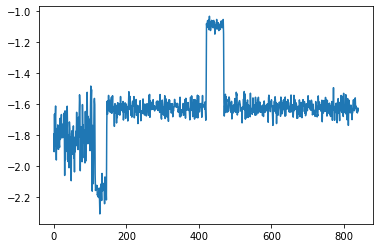

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 840, reward = -1.617033


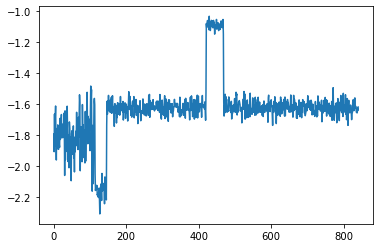

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 841, reward = -1.677819


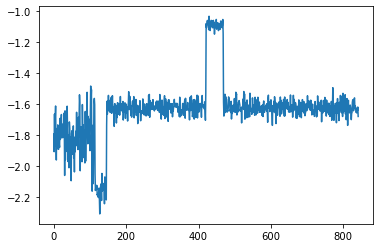

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 842, reward = -1.663777


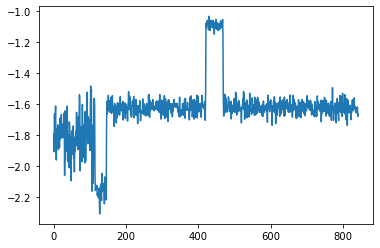

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 843, reward = -1.631852


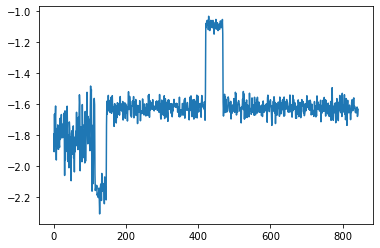

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


Episode: 844, reward = -1.587875


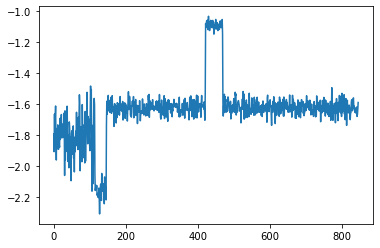

<ipython-input-22-738e8b0196b4>:79: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at  /Users/distiller/project/conda/conda-bld/pytorch_1607370249289/work/aten/src/ATen/native/IndexingUtils.h:25.)
  target_Q[non_final_mask] = self.critics_target[agent](non_final_next_states.view(-1, self.n_agents * self.n_states),


KeyboardInterrupt: 

In [29]:
reward_record = []

np.random.seed(1234)
th.manual_seed(1234)
n_agents = num_load_balancers
n_states = 8
n_actions = num_servers
capacity = 1000000
batch_size = 64

n_episode = 20000
max_steps = 100
episodes_before_train = 100

win = None
param = None
model_save_name = 'classifier_modified_env_3_14.pt'
PATH = F"./{model_save_name}" 

maddpg = MADDPG(n_agents, n_states, n_actions, batch_size, capacity, episodes_before_train)

FloatTensor = th.cuda.FloatTensor if maddpg.use_cuda else th.FloatTensor
for i_episode in range(n_episode):
    obs = env.reset()
    obs = np.stack(obs)
    if isinstance(obs, np.ndarray):
        obs = th.from_numpy(obs).float()
    total_reward = 0.0
    rr = np.zeros((n_agents,))

    done = False
    while not done:
        obs = obs.type(FloatTensor)
        action = maddpg.select_action(obs) # .data.cpu()
        aa = action.tolist()
        a = []
        for i in aa:
            ssum = sum(i)
            i = [(p / ssum) for p in i]
            a.append(np.random.choice(np.arange(0, 8), p=i))
            # print(a)
        obs_, reward, done, _ = env.step(a)
        
        reward = th.FloatTensor(reward).type(FloatTensor)
        obs_ = np.stack(obs_)
        obs_ = th.from_numpy(obs_).float()
        next_obs = obs_
        
        # total_reward += reward.sum()
        total_reward += reward[0]
        rr += reward.cpu().numpy()
        maddpg.memory.push(obs.data, action, next_obs, reward)
        obs = next_obs

        c_loss, a_loss = maddpg.update_policy()

    maddpg.episode_done += 1
    print('Episode: %d, reward = %f' % (i_episode, total_reward))
    reward_record.append(total_reward)
    
    plt.plot(np.arange(i_episode + 1), reward_record)
    plt.show()

    if maddpg.episode_done == maddpg.episodes_before_train:
        print('training now begins...')
        print('MADDPG on Network Balancing\n' +
              'scale_reward=%f\n' % scale_reward +
              'agent=%d' % n_agents +
              ' \nlr=0.001, 0.0001, sensor_range=0.3\n' +
              'servers=%d' % (num_servers))

    if i_episode % 10 == 9:
        th.save({
            'epoch': i_episode,
            'acotr_state_dict': [[maddpg.actors[i].state_dict()] for i in range(len(maddpg.actors))],
            'critic_state_dict': [[maddpg.critics[i].state_dict()] for i in range(len(maddpg.critics))],
            'acotr_target_state_dict': [[maddpg.actors_target[i].state_dict()] for i in range(len(maddpg.actors))],
            'critic_target_state_dict': [[maddpg.critics_target[i].state_dict()] for i in range(len(maddpg.critics))],
            'actor_optimizer_state_dict': [[maddpg.actor_optimizer[i].state_dict()] for i in range(len(maddpg.actor_optimizer))],
            'critic_optimizer_state_dict': [[maddpg.critic_optimizer[i].state_dict()] for i in range(len(maddpg.critic_optimizer))],
            }, PATH)
# env.close()